#  Feature Selection for Mass Spectrometry Prediction

This notebook implements comprehensive feature selection techniques to identify the most informative molecular descriptors for mass spectrum prediction.

## Methods Implemented:

### 1. Statistical Methods
- **Mutual Information**: Captures non-linear dependencies between features and targets
- **F-test**: Statistical significance of linear relationships
- **Variance Threshold**: Removes low-variance features
- **Correlation Filter**: Removes redundant correlated features

### 2. Model-Based Methods
- **Random Forest Importance**: Feature importance from tree ensembles
- **LASSO (L1) Selection**: Sparse linear model selection
- **Recursive Feature Elimination (RFE)**: Iterative feature removal

### 3. Domain-Specific Methods
- **Fingerprint Type Analysis**: Evaluate different molecular fingerprint types
- **Spectral Range Correlation**: Features predictive of specific m/z ranges

### 4. Ensemble Selection
- **Voting-based Selection**: Combine multiple methods
- **Stability Analysis**: Bootstrap-based selection stability

## Evaluation Framework:
- Fixed Random Forest model for consistent comparison
- Primary metric: Cosine similarity
- Secondary metrics: Feature count, training time, stability
- **Standard Visualizations**: 2x2 diagnostic plots and spectrum examples after each method

**Input**: Featurized JSONL data from previous notebooks

**Output**: Selected feature subsets with performance metrics and visualizations

## 1. Environment Setup

Import required libraries and configure the environment for feature selection.

### Key Components:
- **scikit-learn**: Feature selection algorithms and evaluation metrics
- **XGBoost**: For tree-based feature importance
- **NumPy/Pandas**: Data manipulation
- **Matplotlib/Seaborn**: Visualization of selection results
- **joblib**: Parallel processing with threading backend for macOS compatibility

In [1]:
# Standard library imports
import os
import json
import pickle
import time
import warnings
import io
import random
from typing import Dict, List, Tuple, Any, Optional
from concurrent.futures import ThreadPoolExecutor, as_completed
from functools import partial

# Data science imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import seaborn as sns
from tqdm import tqdm
from joblib import Parallel, delayed

# Machine learning imports
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import (
    mutual_info_regression, f_regression, SelectKBest,
    VarianceThreshold, RFE, SelectFromModel
)
from sklearn.linear_model import Lasso, LassoCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from scipy.spatial.distance import cosine
from scipy.stats import pearsonr
import xgboost as xgb

# Chemistry imports (optional)
try:
    from rdkit import Chem
    from rdkit.Chem import Descriptors
    from rdkit.Chem.Draw import rdMolDraw2D
    RDKIT_AVAILABLE = True
    print("RDKit available for molecular structure visualization")
except ImportError:
    RDKIT_AVAILABLE = False
    print("Warning: RDKit not available. Molecular structure features will be limited.")

# Configure warnings
warnings.filterwarnings('ignore')

# Set random seed
SEED = 42
np.random.seed(SEED)
random.seed(SEED)

# Configure joblib for macOS compatibility
os.environ['JOBLIB_TEMP_FOLDER'] = '/tmp'

# Colorblind-friendly Okabe–Ito palette for standard plots
PALETTE = {
    "blue": "#0072B2",
    "sky": "#56B4E9",
    "orange": "#E69F00",
    "vermillion": "#D55E00",
    "yellow": "#F0E442",
    "green": "#009E73",
    "purple": "#CC79A7",
    "black": "#000000",
    "grey": "#999999",
}

print("Environment setup complete")
print(f"Number of CPU cores available: {os.cpu_count()}")

RDKit available for molecular structure visualization
Environment setup complete
Number of CPU cores available: 16


## 2. Master Configuration

Central configuration for all feature selection methods and evaluation parameters.

### Configuration Structure:

**Selection Methods:**
- Statistical: MI, F-test, variance, correlation thresholds
- Model-based: RF importance, LASSO alpha values, RFE settings
- Domain-specific: Fingerprint groups and m/z ranges

**Evaluation Settings:**
- Fixed RF hyperparameters for consistent comparison
- Feature count targets: [50, 100, 200, 500, 1000]
- Stability analysis with 10 bootstrap samples

**Parallel Processing:**
- Threading backend for macOS compatibility
- Optimal worker configuration

In [2]:
MASTER_CONFIG = {
    # Paths configuration
    'paths': {
        'results_dir': '../data/results',
        'models_dir': '../models',
        'selected_dir': '../data/results/selected_features',
        'input_type': 'hpj',
        'data_subdir': 'full_featurised'
    },
    
    # Feature selection targets
    'selection': {
        'target_features': [50, 100, 200, 500, 1000],
        'variance_threshold': 0.01,
        'correlation_threshold': 0.95,
        'stability_bootstraps': 10
    },
    
    # Statistical methods
    'statistical': {
        'mutual_info': {
            'random_state': 42,
            'n_neighbors': 3,
            'n_jobs': -1  # Use all cores for MI
        },
        'f_test': {
            'center': True
        }
    },
    
    # Model-based methods
    'model_based': {
        'rf_importance': {
            'n_estimators': 100,
            'max_depth': 10,
            'random_state': 42,
            'n_jobs': -1  # Use all cores
        },
        'lasso': {
            'cv': 5,
            'max_iter': 5000,
            'random_state': 42,
            'n_jobs': -1  # Parallel CV
        },
        'rfe': {
            'step': 0.1,  # Remove 10% of features each iteration
            'verbose': 0,
            'n_jobs': 1  # RFE doesn't parallelize well
        }
    },
    
    # Domain-specific configuration
    'domain': {
        'fingerprint_ranges': {
            'morgan': (0, 3072),
            'maccs': (3072, 3238),
            'rdkit': (3238, 5286),
            'descriptors': (5286, 7135)
        },
        'mz_ranges': {
            'low': (0, 200),
            'mid': (200, 350),
            'high': (350, 500)
        }
    },
    
    # Fixed RF evaluation parameters
    'rf_eval': {
        'n_estimators': 100,
        'max_depth': 25,
        'min_samples_split': 3,
        'min_samples_leaf': 1,
        'n_jobs': -1,
        'random_state': 42
    },
    
    # Evaluation settings for plots
    'evaluation': {
        'mz_step': 50,
        'max_mz': 1000,
        'peak_threshold': 0.01,
        'show_plots': True,  # Enable standard plots
        'plot_frequency': 1  # Plot every N methods (1 = plot all)
    },
    
    # General settings
    'general': {
        'random_state': 42,
        'transform_sqrt': True,
        'n_jobs': max(1, os.cpu_count() - 1),  # Leave one core free
        'parallel_backend': 'threading'  # macOS compatible
    }
}

# Create directories
os.makedirs(MASTER_CONFIG['paths']['selected_dir'], exist_ok=True)
print(f"Configuration loaded. Results will be saved to: {MASTER_CONFIG['paths']['selected_dir']}")
print(f"Parallel processing with {MASTER_CONFIG['general']['n_jobs']} workers")
print(f"Standard plots: {'Enabled' if MASTER_CONFIG['evaluation']['show_plots'] else 'Disabled'}")

Configuration loaded. Results will be saved to: ../data/results/selected_features
Parallel processing with 15 workers
Standard plots: Enabled


## 3. Data Loading and Utility Functions

Core functions for data loading, evaluation, and result management.

### Key Functions:

**Data Management:**
- `load_jsonl_data`: Loads featurized molecular data
- `save_selection_results`: Persists selected features and metrics

**Evaluation:**
- `evaluate_feature_subset`: Tests feature subset with fixed RF model
- `cosine_similarity_score`: Primary evaluation metric

**Feature Selection Utilities:**
- `remove_correlated_features`: Correlation-based filtering
- `calculate_stability`: Bootstrap stability analysis

**Parallel Processing:**
- `parallel_mutual_info`: Efficient MI calculation
- `parallel_evaluate`: Batch evaluation of multiple feature sets

In [3]:
def load_jsonl_data(filepath):
    """Load data from JSONL file."""
    smiles_list, features, targets = [], [], []
    
    if not os.path.exists(filepath):
        print(f"File not found: {filepath}")
        return smiles_list, np.array(features), np.array(targets)
    
    with open(filepath, 'r') as f:
        for line in tqdm(f, desc=f"Loading {os.path.basename(filepath)}"):
            try:
                record = json.loads(line)
                smiles = record.get("smiles")
                feat = record.get("features")
                targ = record.get("target")
                
                if smiles and feat is not None and targ is not None:
                    smiles_list.append(smiles)
                    features.append(feat)
                    targets.append(targ)
            except:
                continue
    
    return smiles_list, np.array(features), np.array(targets)

def cosine_similarity_score(y_true, y_pred):
    """Calculate mean cosine similarity between spectra."""
    similarities = []
    for i in range(len(y_true)):
        if np.sum(y_true[i]) == 0 or np.sum(y_pred[i]) == 0:
            sim = 0 if np.sum(y_true[i]) != np.sum(y_pred[i]) else 1
        else:
            sim = 1 - cosine(y_true[i], y_pred[i])
        similarities.append(sim if not np.isnan(sim) else 0)
    return np.mean(similarities), np.array(similarities)

def weighted_dot_product(y_true: np.ndarray, y_pred: np.ndarray, eps: float = 1e-8) -> float:
    """Calculate weighted dot product (WDP) score."""
    weights = y_true + eps
    numerator = np.sum(weights * y_true * y_pred)
    denominator = np.sum(weights * y_true * y_true) + eps
    return numerator / denominator

def peak_detection_metrics(y_true: np.ndarray, y_pred: np.ndarray, threshold: float = 0.01) -> Dict:
    """Calculate peak detection metrics."""
    # Normalize to relative intensities
    y_true_norm = y_true / (np.max(y_true, axis=1, keepdims=True) + 1e-8)
    y_pred_norm = y_pred / (np.max(y_pred, axis=1, keepdims=True) + 1e-8)
    
    # Binary masks for peaks
    true_peaks = y_true_norm > threshold
    pred_peaks = y_pred_norm > threshold
    
    # Calculate metrics
    tp = np.sum(true_peaks & pred_peaks)
    fp = np.sum(~true_peaks & pred_peaks)
    fn = np.sum(true_peaks & ~pred_peaks)
    
    precision = tp / (tp + fp + 1e-8)
    recall = tp / (tp + fn + 1e-8)
    f1 = 2 * precision * recall / (precision + recall + 1e-8)
    
    return {
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'true_peaks': np.sum(true_peaks),
        'pred_peaks': np.sum(pred_peaks),
        'tp': tp,
        'fp': fp,
        'fn': fn
    }

def cosine_similarity_by_mz_range(y_true, y_pred, config, tree_predictions=None):
    """Calculate cosine similarity by m/z range with uncertainty if available."""
    spectrum_length = y_true.shape[1]
    step_size = config['evaluation']['mz_step']
    max_mz = min(config['evaluation']['max_mz'], spectrum_length)
    
    mz_ranges = {}
    for start in range(0, max_mz, step_size):
        end = min(start + step_size, max_mz)
        range_key = f"{start}-{end}"
        
        y_true_range = y_true[:, start:end]
        y_pred_range = y_pred[:, start:end]
        
        # Calculate cosine similarities
        similarities = []
        for i in range(len(y_true)):
            true_spec = y_true_range[i]
            pred_spec = y_pred_range[i]
            
            if np.sum(true_spec) == 0 or np.sum(pred_spec) == 0:
                sim = 0 if np.sum(true_spec) != np.sum(pred_spec) else 1
            else:
                sim = 1 - cosine(true_spec, pred_spec)
            similarities.append(sim)
        
        mean_sim = np.mean(similarities)
        
        # Statistical uncertainty (across samples)
        stat_uncertainty = np.std(similarities) / np.sqrt(len(similarities)) if len(similarities) > 1 else 0
        
        # Model uncertainty if tree predictions available
        if tree_predictions is not None:
            tree_sims = []
            for tree_idx in range(tree_predictions.shape[0]):
                tree_pred_range = tree_predictions[tree_idx, :, start:end]
                tree_similarities = []
                for i in range(len(y_true)):
                    true_spec = y_true_range[i]
                    pred_spec = tree_pred_range[i]
                    
                    if np.sum(true_spec) == 0 or np.sum(pred_spec) == 0:
                        sim = 0 if np.sum(true_spec) != np.sum(pred_spec) else 1
                    else:
                        sim = 1 - cosine(true_spec, pred_spec)
                    tree_similarities.append(sim)
                tree_sims.append(np.mean(tree_similarities))
            
            model_uncertainty = np.std(tree_sims)
        else:
            model_uncertainty = 0
        
        # Peak counting
        true_peaks = np.sum(y_true_range > config['evaluation']['peak_threshold'])
        pred_peaks = np.sum(y_pred_range > config['evaluation']['peak_threshold'])
        
        # Coverage
        non_zero_samples = np.sum(np.sum(y_true_range, axis=1) > 0)
        coverage = non_zero_samples / len(y_true) * 100
        
        mz_ranges[range_key] = {
            'mean_similarity': mean_sim,
            'stat_uncertainty': stat_uncertainty,
            'model_uncertainty': model_uncertainty,
            'coverage': coverage,
            'avg_true_peaks_per_spectrum': true_peaks / len(y_true),
            'avg_pred_peaks_per_spectrum': pred_peaks / len(y_true)
        }
    
    return mz_ranges

def evaluate_feature_subset(X_train, y_train, X_test, y_test, selected_features, method_name):
    """Evaluate a feature subset using fixed RF configuration."""
    start_time = time.time()
    
    # Select features
    X_train_sel = X_train[:, selected_features]
    X_test_sel = X_test[:, selected_features]
    
    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_sel)
    X_test_scaled = scaler.transform(X_test_sel)
    
    # Train RF model
    rf_model = RandomForestRegressor(**MASTER_CONFIG['rf_eval'])
    rf_model.fit(X_train_scaled, y_train)
    
    # Get predictions with tree predictions for uncertainty
    tree_predictions = np.array([tree.predict(X_test_scaled) for tree in rf_model.estimators_])
    y_pred = np.mean(tree_predictions, axis=0)
    y_pred = np.maximum(y_pred, 0)  # Ensure non-negative
    
    # Calculate metrics
    cosine_sim, individual_cos_sims = cosine_similarity_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    peak_metrics = peak_detection_metrics(y_test, y_pred, MASTER_CONFIG['evaluation']['peak_threshold'])
    
    # Calculate m/z range similarities with uncertainty
    mz_range_sims = cosine_similarity_by_mz_range(y_test, y_pred, MASTER_CONFIG, tree_predictions)
    
    training_time = time.time() - start_time
    
    results = {
        'method': method_name,
        'n_features': len(selected_features),
        'cosine_similarity': cosine_sim,
        'cosine': cosine_sim,
        'individual_cos_sims': individual_cos_sims,
        'mse': mse,
        'r2': r2,
        'mae': mae,
        'peak_metrics': peak_metrics,
        'mz_range_sims': mz_range_sims,
        'training_time': training_time,
        'selected_features': selected_features,
        'y_true': y_test,
        'y_pred': y_pred,
        'tree_predictions': tree_predictions
    }
    
    print(f"  {method_name}: {len(selected_features)} features, "
          f"Cosine Sim = {cosine_sim:.4f}, Time = {training_time:.1f}s")
    
    return results

def parallel_evaluate(evaluation_tasks, n_jobs=None):
    """Evaluate multiple feature subsets in parallel."""
    if n_jobs is None:
        n_jobs = MASTER_CONFIG['general']['n_jobs']
    
    results = []
    
    with ThreadPoolExecutor(max_workers=n_jobs) as executor:
        # Submit all tasks
        future_to_task = {
            executor.submit(
                evaluate_feature_subset, 
                task['X_train'], task['y_train'], 
                task['X_test'], task['y_test'],
                task['features'], task['method']
            ): task['method'] for task in evaluation_tasks
        }
        
        # Collect results as they complete
        for future in as_completed(future_to_task):
            method = future_to_task[future]
            try:
                result = future.result()
                results.append(result)
            except Exception as e:
                print(f"Error evaluating {method}: {e}")
    
    return results

def remove_correlated_features(X, threshold=0.95):
    """Remove highly correlated features using efficient numpy operations."""
    # Calculate correlation matrix
    corr_matrix = np.corrcoef(X.T)
    
    # Find highly correlated pairs
    upper_triangle = np.triu(np.ones_like(corr_matrix), k=1)
    high_corr_pairs = np.where((np.abs(corr_matrix) > threshold) & upper_triangle)
    
    # Remove features
    features_to_remove = set()
    variances = np.var(X, axis=0)
    
    for i, j in zip(high_corr_pairs[0], high_corr_pairs[1]):
        # Keep feature with higher variance
        if variances[i] < variances[j]:
            features_to_remove.add(i)
        else:
            features_to_remove.add(j)
    
    selected_features = [i for i in range(X.shape[1]) if i not in features_to_remove]
    return np.array(selected_features)

def calculate_stability(feature_selections, n_features):
    """Calculate Jaccard stability index for feature selections."""
    n_selections = len(feature_selections)
    if n_selections < 2:
        return 1.0
    
    jaccard_scores = []
    for i in range(n_selections):
        for j in range(i + 1, n_selections):
            set_i = set(feature_selections[i])
            set_j = set(feature_selections[j])
            intersection = len(set_i & set_j)
            union = len(set_i | set_j)
            jaccard = intersection / union if union > 0 else 0
            jaccard_scores.append(jaccard)
    
    return np.mean(jaccard_scores)

def parallel_mutual_info(X, y, n_features_list, variance_indices, random_state=42):
    """Calculate mutual information scores efficiently."""
    # Calculate MI scores once
    mi_scores = mutual_info_regression(
        X, y,
        n_neighbors=MASTER_CONFIG['statistical']['mutual_info']['n_neighbors'],
        random_state=random_state,
        n_jobs=MASTER_CONFIG['statistical']['mutual_info']['n_jobs']
    )
    
    # Get top features for each n_features
    results = {}
    for n_features in n_features_list:
        if n_features > len(mi_scores):
            continue
        
        # Get top n features by score
        top_indices = np.argsort(mi_scores)[::-1][:n_features]
        selected_indices = variance_indices[top_indices]
        
        results[n_features] = selected_indices
    
    return results

def save_selection_results(results, method_category):
    """Save feature selection results."""
    filepath = os.path.join(MASTER_CONFIG['paths']['selected_dir'], 
                           f"{method_category}_selection_results.pkl")
    with open(filepath, 'wb') as f:
        pickle.dump(results, f)
    print(f"Results saved to {filepath}")

print("Utility functions loaded")

Utility functions loaded


## 3.5 Standard Visualization Functions

Standard plotting suite for mass spectrometry models following canonical reference.

### Visualization Functions:
- `plot_standard_2x2_diagnostic`: Standard 2x2 diagnostic plots
- `plot_random_spectrum_grid`: Random spectrum examples with molecular structures

In [4]:
def plot_standard_2x2_diagnostic(results: Dict, model_name: str = "Model", show_uncertainties: bool = True):
    """Create standard 2x2 evaluation visualization.
    
    1. Cosine Similarity Distribution (Top-Left)
    2. Performance by m/z Range (Top-Right)
    3. Intensity Correlation with Violin Density (Bottom-Left)
    4. Peak Count Comparison (Bottom-Right)
    """
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    
    # ---------- Top-Left: Cosine Similarity Distribution ----------
    ax = axes[0, 0]
    ax.hist(results['individual_cos_sims'], bins=30, range=(0, 1),
            alpha=0.85, color=PALETTE["blue"], edgecolor=PALETTE["black"], linewidth=0.5)
    ax.set_xlabel('Cosine Similarity')
    ax.set_ylabel('Count')
    ax.set_title(f'Cosine Similarity Distribution - {model_name}')
    ax.axvline(results['cosine'], color=PALETTE["vermillion"], linestyle='--', linewidth=2,
               label=f"Mean: {results['cosine']:.4f}")
    ax.legend(frameon=False)
    ax.grid(alpha=0.3)
    
    # ---------- Top-Right: Performance by m/z with Uncertainties ----------
    ax = axes[0, 1]
    ranges = list(results['mz_range_sims'].keys())
    x_pos = np.arange(len(ranges))
    mean_sims = np.array([results['mz_range_sims'][r]['mean_similarity'] for r in ranges])
    stat_uncertainties = np.array([results['mz_range_sims'][r]['stat_uncertainty'] for r in ranges])
    model_uncertainties = np.array([results['mz_range_sims'][r]['model_uncertainty'] for r in ranges])
    
    if show_uncertainties and np.any(model_uncertainties > 0):
        # Calculate confidence intervals
        stat_ci = 1.96 * stat_uncertainties
        model_sigma = 2.0 * model_uncertainties
        
        stat_lower = np.clip(mean_sims - stat_ci, 0, 1)
        stat_upper = np.clip(mean_sims + stat_ci, 0, 1)
        model_lower = np.clip(mean_sims - model_sigma, 0, 1)
        model_upper = np.clip(mean_sims + model_sigma, 0, 1)
        
        # Model uncertainty: translucent band + dotted bounds
        if np.any(model_uncertainties > 0):
            ax.fill_between(x_pos, model_lower, model_upper,
                            facecolor=PALETTE["purple"], alpha=0.18,
                            edgecolor=PALETTE["purple"], linewidth=0.8, zorder=1)
            ax.plot(x_pos, model_lower, linestyle=':', color=PALETTE["purple"], linewidth=1.3, zorder=2)
            ax.plot(x_pos, model_upper, linestyle=':', color=PALETTE["purple"], linewidth=1.3, zorder=2)
        
        # Statistical uncertainty: hatched band
        ax.fill_between(x_pos, stat_lower, stat_upper,
                        facecolor='none', edgecolor=PALETTE["yellow"],
                        hatch='////', linewidth=1.2, zorder=3)
        ax.plot(x_pos, stat_lower, linestyle='--', color=PALETTE["yellow"], linewidth=1.2, zorder=4)
        ax.plot(x_pos, stat_upper, linestyle='--', color=PALETTE["yellow"], linewidth=1.2, zorder=4)
    
    ax.plot(x_pos, mean_sims, color=PALETTE["blue"], linewidth=2.5,
            label='Mean Cosine Similarity', marker='o', markersize=6, zorder=5)
    ax.set_xlabel('m/z Range')
    ax.set_ylabel('Cosine Similarity')
    ax.set_title(f'Performance by m/z Range - {model_name}')
    ax.set_xticks(x_pos)
    ax.set_xticklabels(ranges, rotation=45)
    ax.set_ylim(-0.05, 1.05)
    ax.grid(alpha=0.3)
    if show_uncertainties and np.any(model_uncertainties > 0):
        ax.legend(handles=[
            Patch(facecolor=PALETTE["purple"], alpha=0.18, edgecolor=PALETTE["purple"],
                  label='Model Uncertainty (±2σ)'),
            Patch(facecolor='none', edgecolor=PALETTE["yellow"], hatch='////',
                  label='Statistical Uncertainty (95% CI)')
        ], loc='lower left', fontsize=9, frameon=False)
    
    # ---------- Bottom-Left: True vs Predicted Intensity with Violin Density ----------
    ax = axes[1, 0]
    y_true_flat = np.ravel(results['y_true']).astype(float)
    y_pred_flat = np.ravel(results['y_pred']).astype(float)
    m = np.isfinite(y_true_flat) & np.isfinite(y_pred_flat)
    x = y_true_flat[m]
    y = y_pred_flat[m]
    
    # Rotate to (u,v) coordinates for violin visualization
    root2 = np.sqrt(2.0)
    u = (x + y) / root2
    v = (y - x) / root2
    
    # Bin along diagonal and compute quantiles
    n_bins = 60
    u_edges = np.linspace(u.min(), u.max(), n_bins + 1)
    u_centers = 0.5 * (u_edges[:-1] + u_edges[1:])
    widths_90 = np.full(n_bins, np.nan)
    widths_75 = np.full(n_bins, np.nan)
    widths_60 = np.full(n_bins, np.nan)
    min_count = 10
    
    for i in range(n_bins):
        mask = (u >= u_edges[i]) & (u < u_edges[i+1])
        if np.count_nonzero(mask) >= min_count:
            abs_v = np.abs(v[mask])
            widths_60[i] = np.percentile(abs_v, 60)
            widths_75[i] = np.percentile(abs_v, 75)
            widths_90[i] = np.percentile(abs_v, 90)
    
    # Interpolate and smooth
    def _interp_nan(a):
        xidx = np.arange(a.size)
        msk = ~np.isnan(a)
        if msk.sum() < 2:
            return np.nan_to_num(a, nan=0.0)
        return np.interp(xidx, xidx[msk], a[msk])
    
    def _smooth(a, k=5):
        if k <= 1: return a
        kernel = np.ones(k) / k
        return np.convolve(a, kernel, mode='same')
    
    widths_60 = _smooth(_interp_nan(widths_60), 5)
    widths_75 = _smooth(_interp_nan(widths_75), 5)
    widths_90 = _smooth(_interp_nan(widths_90), 5)
    
    def band_polygon(u_vals, w_vals):
        x_upper = (u_vals - w_vals) / root2
        y_upper = (u_vals + w_vals) / root2
        x_lower = (u_vals + w_vals) / root2
        y_lower = (u_vals - w_vals) / root2
        x_poly = np.r_[x_upper, x_lower[::-1]]
        y_poly = np.r_[y_upper, y_lower[::-1]]
        return x_poly, y_poly
    
    # Scatter points
    ax.scatter(x, y, s=4, marker='.', color=PALETTE["black"],
               edgecolors='none', alpha=1.0, zorder=0, rasterized=True)
    
    # Draw violin bands
    for w, a in [(widths_90, 0.25), (widths_75, 0.35), (widths_60, 0.5)]:
        xp, yp = band_polygon(u_centers, w)
        ax.fill(xp, yp, color=PALETTE["sky"], alpha=a, edgecolor='none', zorder=2)
    
    # Perfect prediction line - FIXED: Clip at 1.0 for normalized intensities
    max_val = 1.0  # Fixed to 1.0 for normalized intensities
    line_pp, = ax.plot([0, max_val], [0, max_val], color=PALETTE["vermillion"],
                       linestyle='--', linewidth=1.6, label='Perfect Prediction', zorder=4)
    
    ax.set_xlim(0, max_val)
    ax.set_ylim(0, max_val)
    ax.set_xlabel('True Intensity')
    ax.set_ylabel('Predicted Intensity')
    ax.set_title(f'Intensity Correlation - {model_name}')
    
    # Legend
    violin_handle = Patch(facecolor=PALETTE["sky"], alpha=0.35, edgecolor='none', label='Density (violin)')
    points_handle = Line2D([0], [0], linestyle='none', marker='.', markersize=6,
                           color=PALETTE["black"], label='All points')
    ax.legend(handles=[points_handle, violin_handle, line_pp], loc='lower right',
              frameon=True, facecolor='white', framealpha=0.85, edgecolor='none', handlelength=2.2)
    ax.grid(alpha=0.25)
    
    # Metrics annotation
    text = f"R² = {results['r2']:.4f}\nMAE = {results['mae']:.4f}"
    ax.text(0.05, 0.95, text, transform=ax.transAxes, fontsize=11,
            va='top', bbox=dict(boxstyle='round', facecolor='wheat',
            alpha=0.6, edgecolor='none'), zorder=5)
    
    # ---------- Bottom-Right: Peak Count Comparison ----------
    ax = axes[1, 1]
    true_peaks = [results['mz_range_sims'][r]['avg_true_peaks_per_spectrum'] for r in ranges]
    pred_peaks = [results['mz_range_sims'][r]['avg_pred_peaks_per_spectrum'] for r in ranges]
    width = 0.35
    
    bars1 = ax.bar(x_pos - width/2, true_peaks, width, label='True',
                   color=PALETTE["green"], alpha=0.9, edgecolor=PALETTE["black"], linewidth=0.6)
    bars2 = ax.bar(x_pos + width/2, pred_peaks, width, label='Predicted',
                   color=PALETTE["blue"],  alpha=0.9, edgecolor=PALETTE["black"], linewidth=0.6)
    
    # Add value labels on bars
    for bars in [bars1, bars2]:
        for bar in bars:
            h = bar.get_height()
            if h > 0:
                ax.text(bar.get_x() + bar.get_width()/2., h, f'{h:.0f}',
                        ha='center', va='bottom', fontsize=12)
    
    ax.set_xlabel('m/z Range')
    ax.set_ylabel('Average Peaks per Spectrum')
    ax.set_title(f'Peak Count Comparison - {model_name}')
    ax.set_xticks(x_pos)
    ax.set_xticklabels(ranges, rotation=45)
    ax.legend(frameon=False)
    ax.grid(alpha=0.3)
    
    plt.suptitle(f'Standard Diagnostic Suite: {model_name}', fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

def plot_random_spectrum_grid(results: Dict, test_smiles: List, n_examples: int = 4, model_name: str = "Model"):
    """Create 2x2 grid of random spectrum examples with molecular structures."""
    # Select random examples
    n_samples = len(results['y_true'])
    random_indices = np.random.choice(n_samples, min(n_examples, n_samples), replace=False)
    
    # Calculate metrics for selected examples
    selected_data = []
    for idx in random_indices:
        y_true = results['y_true'][idx]
        y_pred = results['y_pred'][idx]
        
        # Calculate cosine similarity
        if np.sum(y_true) == 0 and np.sum(y_pred) == 0:
            cosine_sim = 1.0
        elif np.sum(y_true) == 0 or np.sum(y_pred) == 0:
            cosine_sim = 0.0
        else:
            cosine_sim = 1 - cosine(y_true, y_pred)
        
        # Calculate WDP score
        wdp_score = weighted_dot_product(y_true, y_pred)
        
        # Get SMILES
        smiles = test_smiles[idx] if idx < len(test_smiles) else 'N/A'
        
        selected_data.append({
            'y_true': y_true,
            'y_pred': y_pred,
            'cosine_sim': cosine_sim,
            'wdp_score': wdp_score,
            'smiles': smiles,
            'index': idx
        })
    
    # Create figure
    fig = plt.figure(figsize=(20, 16))
    main_gs = gridspec.GridSpec(2, 2, figure=fig, hspace=0.3, wspace=0.3)
    
    print(f"\nSelected random examples:")
    
    for i, data in enumerate(selected_data[:4]):
        print(f"  {i+1}. Index {data['index']}: Cosine={data['cosine_sim']:.4f}, WDP={data['wdp_score']:.4f}")
        
        # Calculate position in 2x2 grid
        row = i // 2
        col = i % 2
        
        # Create sub-gridspec for this molecule
        sub_gs = gridspec.GridSpecFromSubplotSpec(2, 1, main_gs[row, col], 
                                                 height_ratios=[1, 1], hspace=0)
        
        ax1 = fig.add_subplot(sub_gs[0])  # Experimental
        ax2 = fig.add_subplot(sub_gs[1])  # Predicted
        
        # Process data (convert from sqrt scale if needed)
        y_true_scaled = data['y_true'] ** 2 if MASTER_CONFIG['general']['transform_sqrt'] else data['y_true']
        y_pred_scaled = data['y_pred'] ** 2 if MASTER_CONFIG['general']['transform_sqrt'] else data['y_pred']
        
        # Normalize to 0-100 scale
        if np.max(y_true_scaled) > 0:
            y_true_percent = (y_true_scaled / np.max(y_true_scaled)) * 100
        else:
            y_true_percent = y_true_scaled
            
        if np.max(y_pred_scaled) > 0:
            y_pred_percent = (y_pred_scaled / np.max(y_pred_scaled)) * 100
        else:
            y_pred_percent = y_pred_scaled
        
        # Find non-zero peaks for x-axis range
        mz_values = np.arange(len(data['y_true']))
        threshold = 0.1
        true_nonzero = y_true_percent > threshold
        pred_nonzero = y_pred_percent > threshold
        
        all_nonzero = true_nonzero | pred_nonzero
        if np.any(all_nonzero):
            nonzero_indices = np.where(all_nonzero)[0]
            min_mz = nonzero_indices[0]
            max_mz = nonzero_indices[-1]
            mz_range = max_mz - min_mz
            padding = max(10, int(0.05 * mz_range))
            x_min = max(0, min_mz - padding)
            x_max = min(len(data['y_true']), max_mz + padding)
        else:
            x_min = 0
            x_max = min(500, len(data['y_true']))
        
        # Top panel: Experimental spectrum
        if np.any(true_nonzero):
            markerline, stemlines, baseline = ax1.stem(
                mz_values[true_nonzero], 
                y_true_percent[true_nonzero],
                linefmt='b-', markerfmt=' ', basefmt=' '
            )
            stemlines.set_linewidth(1)
        
        ax1.set_ylabel('Intensity (%)', fontsize=10)
        ax1.text(0.5, 0.95, 'Experimental', transform=ax1.transAxes,
                 fontsize=11, ha='center', va='top')
        ax1.set_ylim(0, 110)
        ax1.grid(False)
        ax1.spines['bottom'].set_visible(False)
        ax1.tick_params(bottom=False, labelbottom=False)
        
        # Bottom panel: Predicted spectrum (inverted)
        if np.any(pred_nonzero):
            markerline, stemlines, baseline = ax2.stem(
                mz_values[pred_nonzero], 
                -y_pred_percent[pred_nonzero],
                linefmt='r-', markerfmt=' ', basefmt=' '
            )
            stemlines.set_linewidth(1)
        
        ax2.set_ylim(-110, 0)
        ax2.set_ylabel('Intensity (%)', fontsize=10)
        ax2.set_xlabel('m/z (Da)', fontsize=10)
        ax2.text(0.5, 0.05, 'Predicted', transform=ax2.transAxes,
                 fontsize=11, ha='center', va='bottom')
        
        # Format y-axis to show positive values
        ax2.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{abs(x):.0f}'))
        ax2.grid(False)
        ax2.spines['top'].set_visible(False)
        ax2.axhline(y=0, color='black', linewidth=1)
        
        # Set x-axis limits
        ax1.set_xlim(x_min, x_max)
        ax2.set_xlim(x_min, x_max)
        
        # Add molecular structure if available
        if data['smiles'] != "N/A" and RDKIT_AVAILABLE:
            try:
                mol = Chem.MolFromSmiles(data['smiles'])
                if mol:
                    mw = Descriptors.ExactMolWt(mol)
                    
                    # Create inset for molecular structure
                    axins = inset_axes(ax2, width="35%", height="50%", loc='lower right', 
                                       bbox_to_anchor=(0, 0.15, 1, 1), bbox_transform=ax2.transAxes)
                    
                    # Draw molecule
                    drawer = rdMolDraw2D.MolDraw2DCairo(300, 200)
                    drawer.DrawMolecule(mol)
                    drawer.FinishDrawing()
                    png = drawer.GetDrawingText()
                    bio = io.BytesIO(png)
                    img = plt.imread(bio, format='png')
                    axins.imshow(img)
                    axins.axis('off')
                    
                    # Add molecular weight
                    axins.text(0.5, -0.08, f'MW: {mw:.1f}', transform=axins.transAxes,
                              fontsize=9, ha='center', va='top', fontweight='bold')
            except:
                pass
        
        # Add title with scores
        title = f"Cosine: {data['cosine_sim']:.3f}, WDP: {data['wdp_score']:.3f}"
        ax1.set_title(title, fontsize=11, fontweight='bold')
    
    # Add overall title
    fig.suptitle(f'Random Spectrum Examples - {model_name}', fontsize=18, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

print("Standard visualization functions loaded")

Standard visualization functions loaded


## 4. Load and Prepare Data

Load the featurized molecular data and prepare for feature selection.

### Data Preprocessing:
1. Load train/validation/test splits
2. Apply square root transformation to targets (if configured)
3. Remove low-variance features as initial filtering
4. Create feature name mappings

LOADING AND PREPARING DATA

Loading datasets...


Loading train_data.jsonl: 2176it [00:00, 2237.63it/s]
Loading val_data.jsonl: 272it [00:00, 2377.18it/s]
Loading test_data.jsonl: 272it [00:00, 2409.22it/s]



Data loaded:
  Train: (2176, 7137)
  Val: (272, 7137)
  Test: (272, 7137)

Applied sqrt transformation to targets

Applying variance threshold (0.01)...
Features after variance filtering: 6043 (removed 1094)

Evaluating baseline (all variance-filtered features)...
  Baseline (Variance Filtered): 6043 features, Cosine Sim = 0.7794, Time = 33.6s

Generating baseline visualizations...


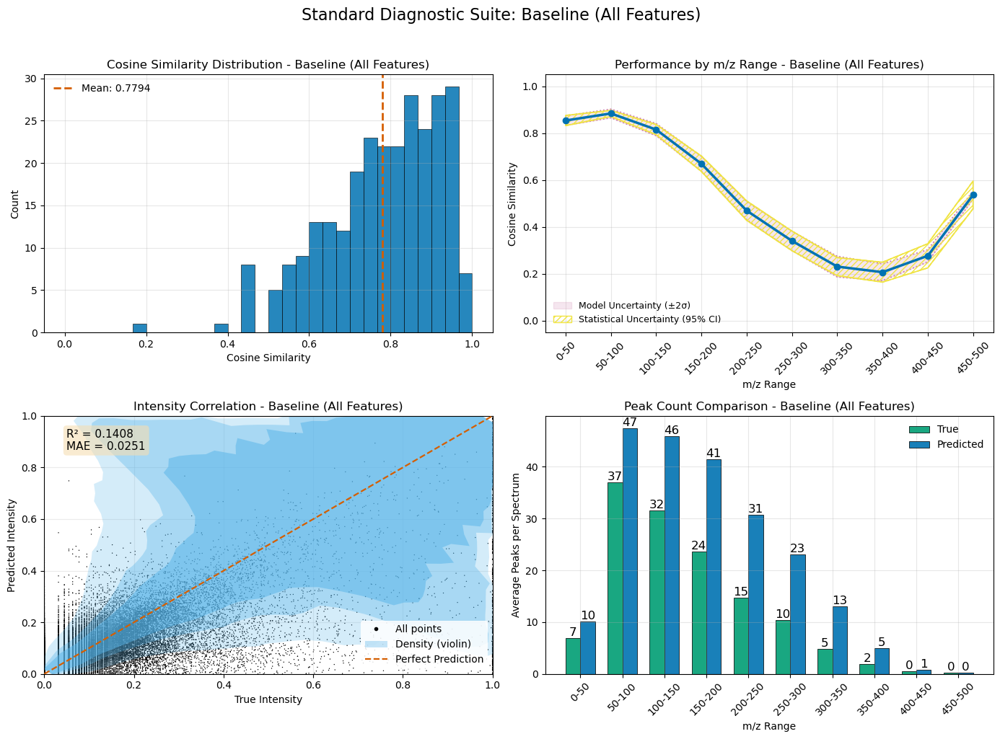


Selected random examples:
  1. Index 30: Cosine=0.7646, WDP=0.4888
  2. Index 116: Cosine=0.7273, WDP=0.3996
  3. Index 79: Cosine=0.9431, WDP=0.7520
  4. Index 127: Cosine=0.8349, WDP=0.4351


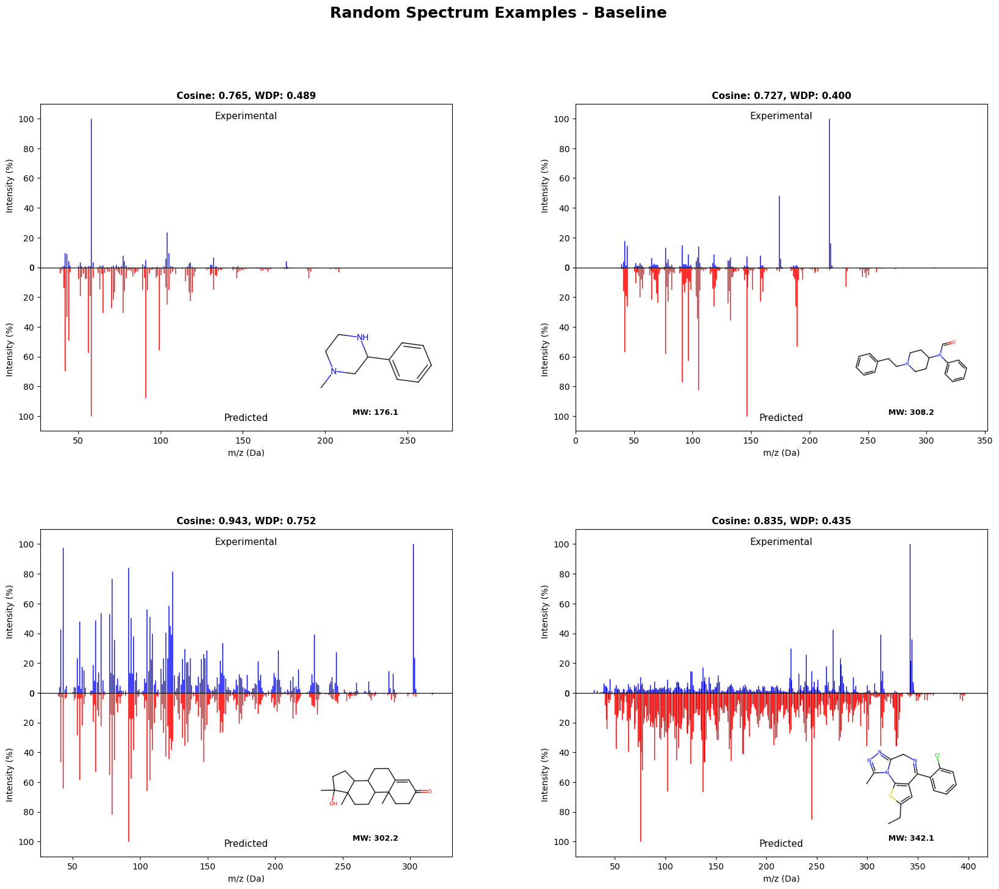


Data preparation complete


In [5]:
print("LOADING AND PREPARING DATA")
print("=" * 60)

# Define data paths
data_dir = os.path.join(
    MASTER_CONFIG['paths']['results_dir'],
    MASTER_CONFIG['paths']['input_type'],
    MASTER_CONFIG['paths']['data_subdir']
)

# Load datasets
print("\nLoading datasets...")
train_smiles, X_train, y_train = load_jsonl_data(os.path.join(data_dir, 'train_data.jsonl'))
val_smiles, X_val, y_val = load_jsonl_data(os.path.join(data_dir, 'val_data.jsonl'))
test_smiles, X_test, y_test = load_jsonl_data(os.path.join(data_dir, 'test_data.jsonl'))

print(f"\nData loaded:")
print(f"  Train: {X_train.shape}")
print(f"  Val: {X_val.shape}")
print(f"  Test: {X_test.shape}")

# Apply sqrt transformation if configured
if MASTER_CONFIG['general']['transform_sqrt']:
    y_train = np.sqrt(y_train)
    y_val = np.sqrt(y_val)
    y_test = np.sqrt(y_test)
    print("\nApplied sqrt transformation to targets")

# Initial variance filtering
print(f"\nApplying variance threshold ({MASTER_CONFIG['selection']['variance_threshold']})...")
var_selector = VarianceThreshold(threshold=MASTER_CONFIG['selection']['variance_threshold'])
X_train_var = var_selector.fit_transform(X_train)
X_val_var = var_selector.transform(X_val)
X_test_var = var_selector.transform(X_test)

# Get indices of retained features
variance_mask = var_selector.get_support()
variance_indices = np.where(variance_mask)[0]

print(f"Features after variance filtering: {X_train_var.shape[1]} (removed {X_train.shape[1] - X_train_var.shape[1]})")

# Create feature names
feature_names = [f"feature_{i}" for i in range(X_train.shape[1])]
feature_names_var = [feature_names[i] for i in variance_indices]

# Store baseline performance (all features after variance filtering)
print("\nEvaluating baseline (all variance-filtered features)...")
baseline_results = evaluate_feature_subset(
    X_train, y_train, X_test, y_test, 
    variance_indices, "Baseline (Variance Filtered)"
)

# Plot baseline results
if MASTER_CONFIG['evaluation']['show_plots']:
    print("\nGenerating baseline visualizations...")
    plot_standard_2x2_diagnostic(baseline_results, "Baseline (All Features)")
    plot_random_spectrum_grid(baseline_results, test_smiles, n_examples=4, model_name="Baseline")

print("\nData preparation complete")

## 5. Statistical Feature Selection Methods

Implement statistical methods for feature selection based on univariate statistics.

### 5.1 Mutual Information

Mutual Information (MI) measures the dependency between features and targets:

$$MI(X, Y) = \sum_{x,y} p(x,y) \log\frac{p(x,y)}{p(x)p(y)}$$

MI captures both linear and non-linear relationships.

### 5.2 F-test Regression

F-test measures linear dependency between features and targets:

$$F = \frac{\text{explained variance}}{\text{unexplained variance}}$$

Higher F-scores indicate stronger linear relationships.

**Parallel Processing**: All statistical methods are computed in parallel for efficiency.

STATISTICAL FEATURE SELECTION

5.1 Mutual Information Feature Selection
----------------------------------------
Computing MI scores in parallel...
Evaluating MI feature subsets in parallel...
  MI_50: 50 features, Cosine Sim = 0.7527, Time = 24.8s
  MI_100: 100 features, Cosine Sim = 0.7554, Time = 26.2s
  MI_200: 200 features, Cosine Sim = 0.7577, Time = 28.3s
  MI_500: 500 features, Cosine Sim = 0.7645, Time = 30.5s
  MI_1000: 1000 features, Cosine Sim = 0.7672, Time = 31.0s

Visualizing MI_50...


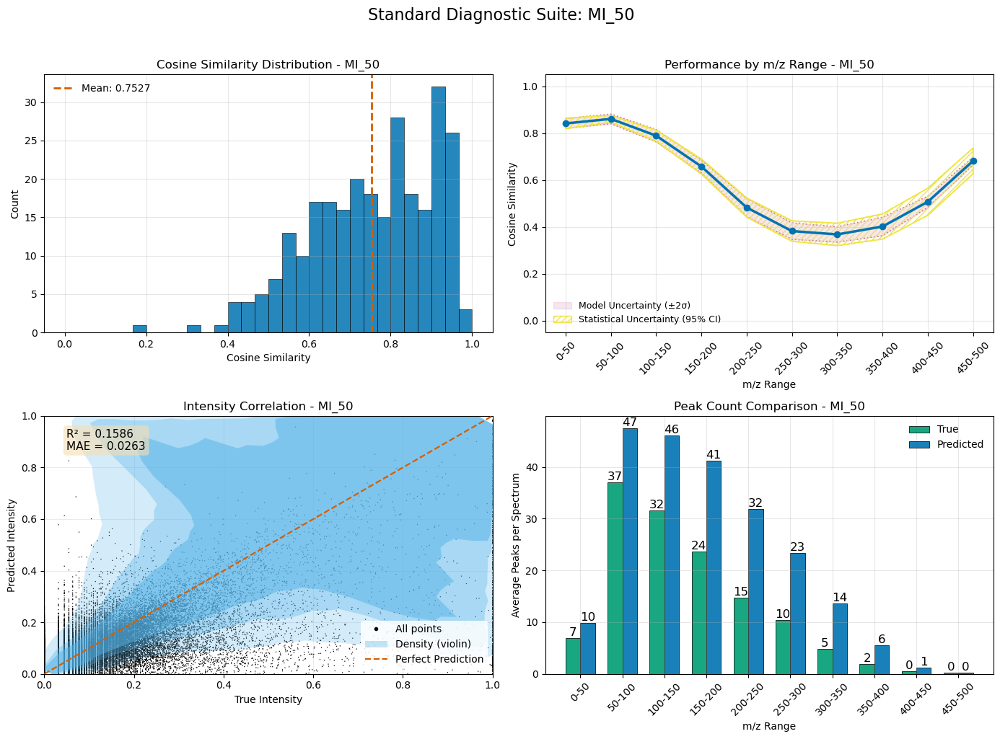


Selected random examples:
  1. Index 83: Cosine=0.8086, WDP=0.4792
  2. Index 81: Cosine=0.3319, WDP=0.1688
  3. Index 265: Cosine=0.5901, WDP=0.2856
  4. Index 128: Cosine=0.5972, WDP=0.3180


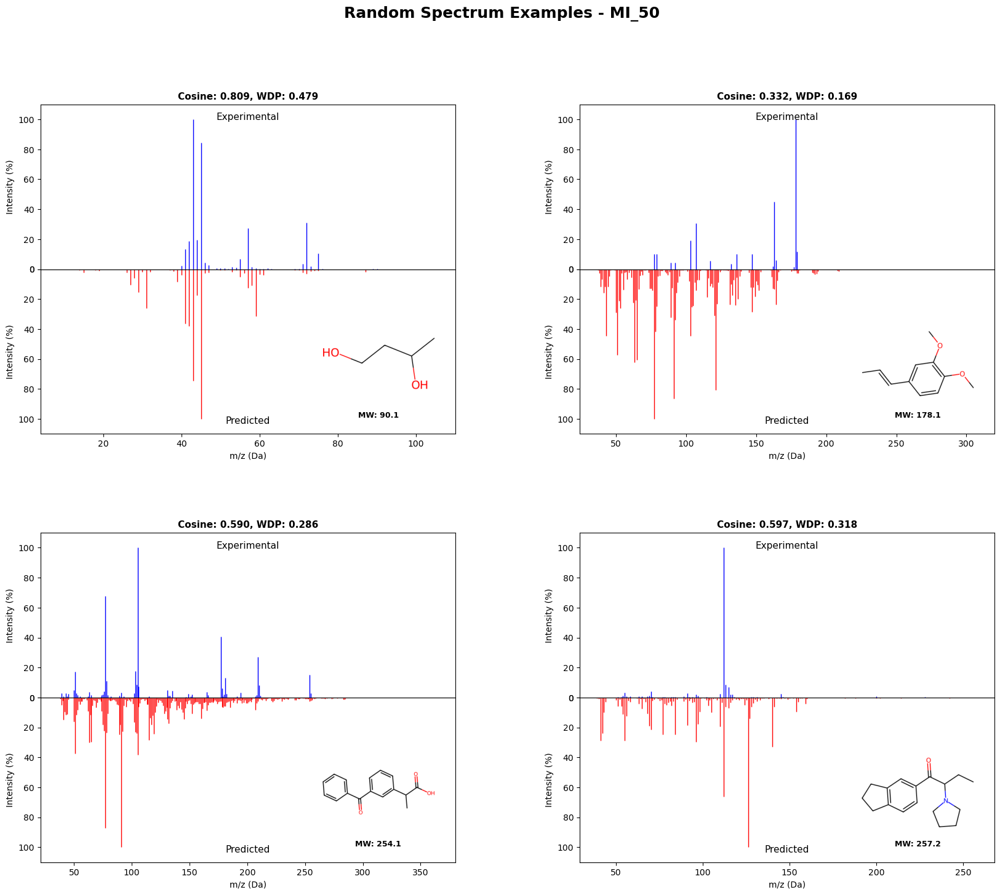


Visualizing MI_100...


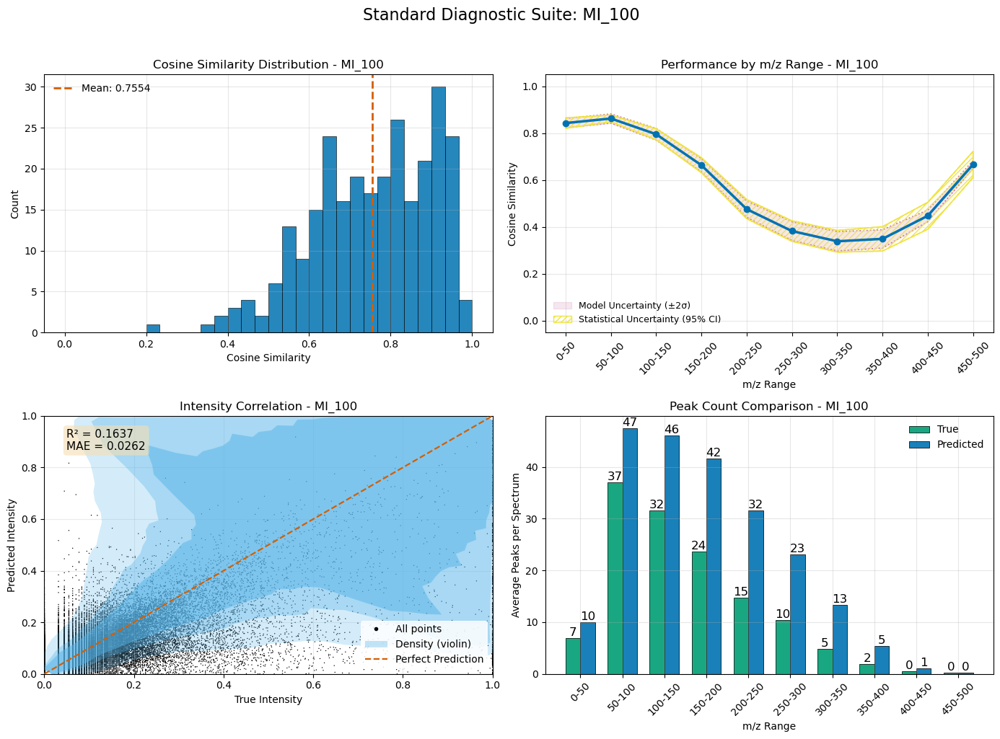


Selected random examples:
  1. Index 80: Cosine=0.6653, WDP=0.3051
  2. Index 129: Cosine=0.7291, WDP=0.5142
  3. Index 208: Cosine=0.9245, WDP=0.8968
  4. Index 241: Cosine=0.5845, WDP=0.1496


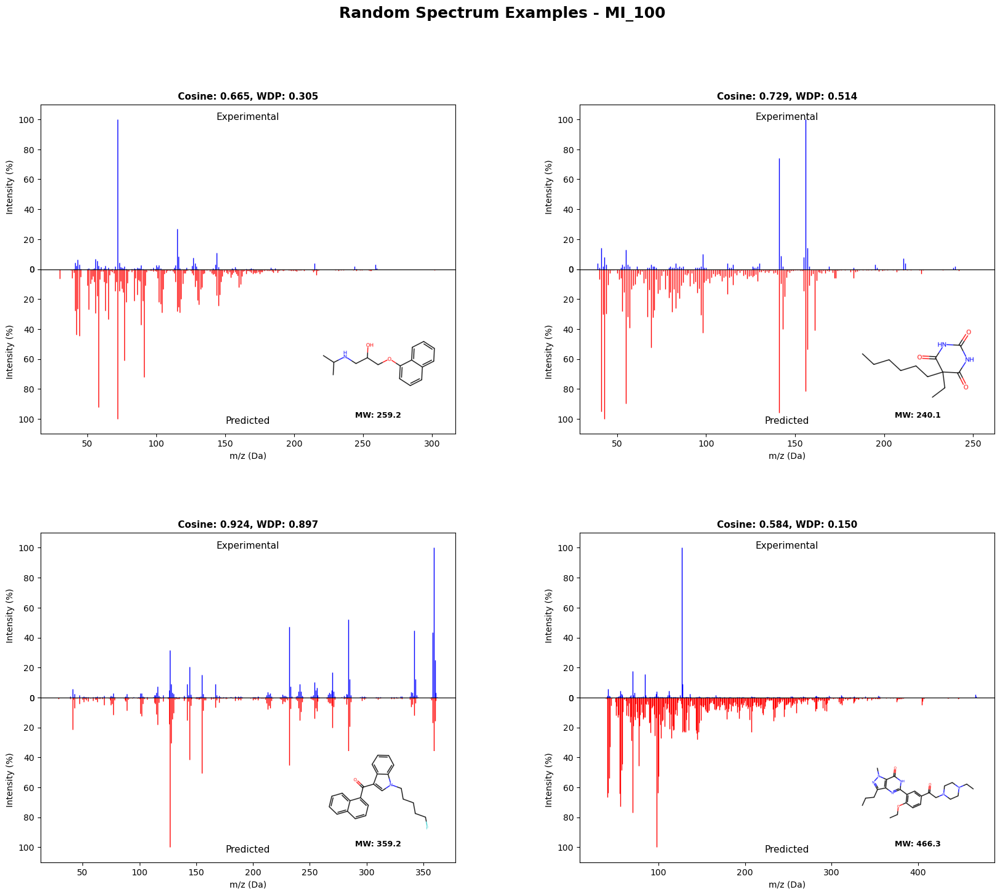


Visualizing MI_200...


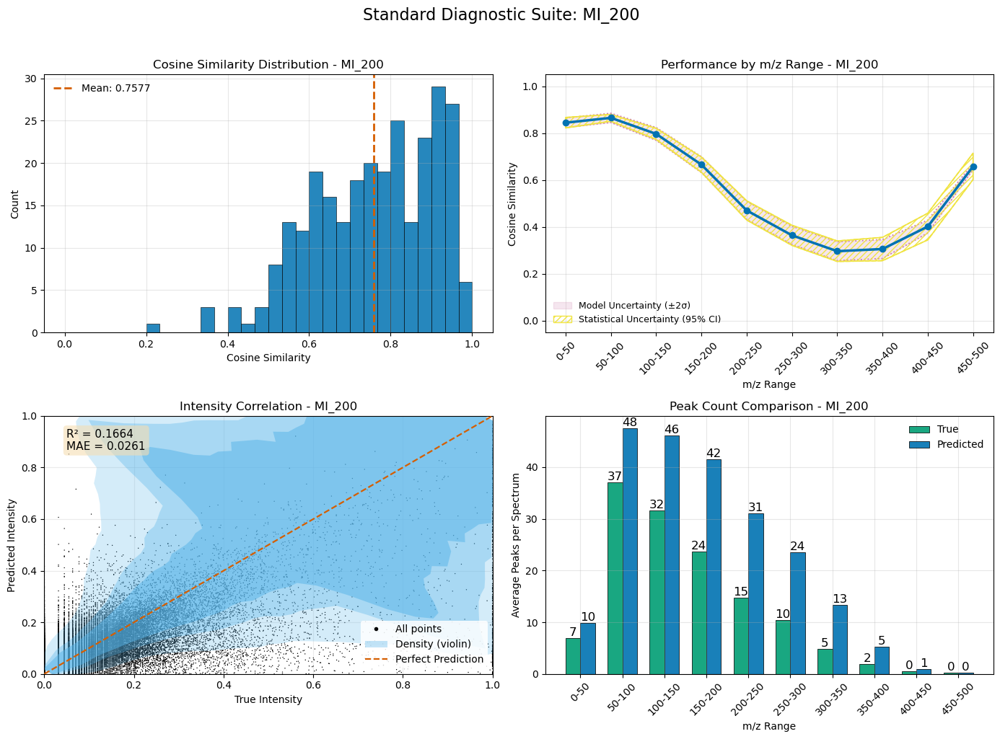


Selected random examples:
  1. Index 95: Cosine=0.7449, WDP=0.4078
  2. Index 211: Cosine=0.9510, WDP=0.6505
  3. Index 53: Cosine=0.9306, WDP=0.6254
  4. Index 75: Cosine=0.8865, WDP=0.7978


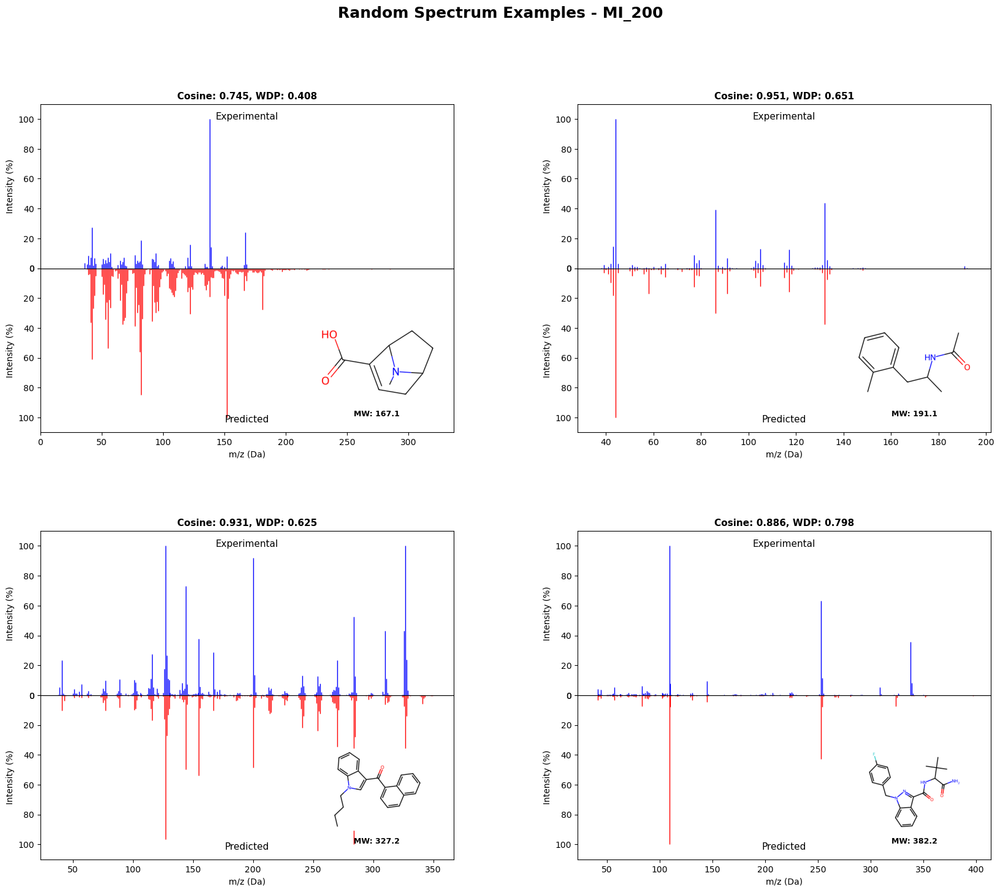


Visualizing MI_500...


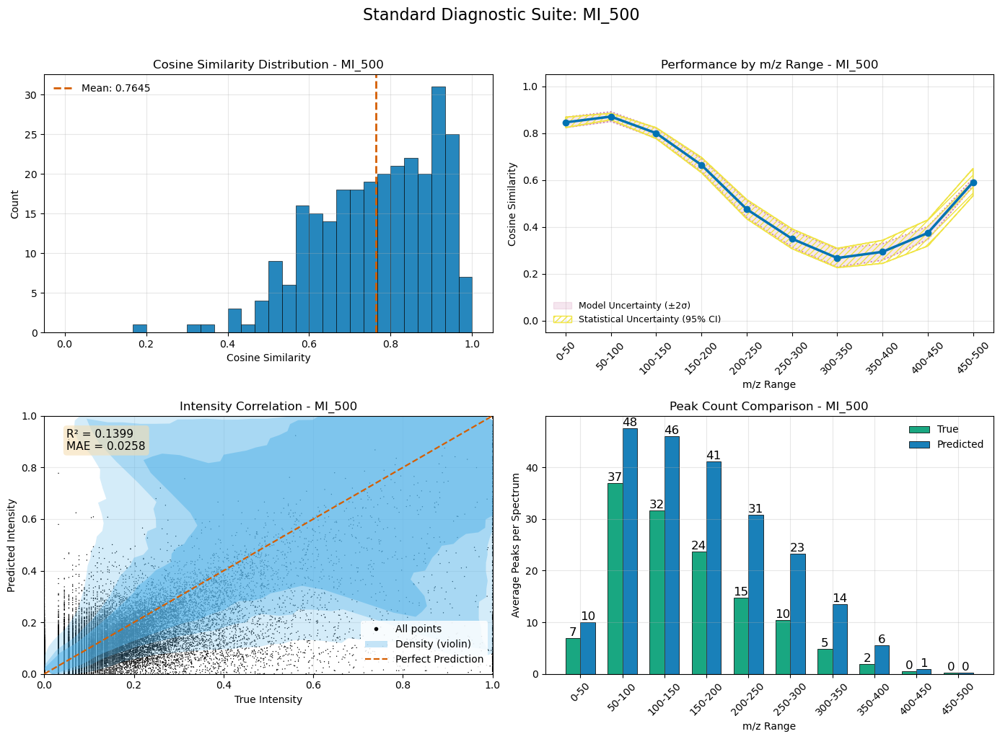


Selected random examples:
  1. Index 2: Cosine=0.8557, WDP=0.5548
  2. Index 169: Cosine=0.9182, WDP=0.7461
  3. Index 178: Cosine=0.7225, WDP=0.2332
  4. Index 194: Cosine=0.7887, WDP=0.3153


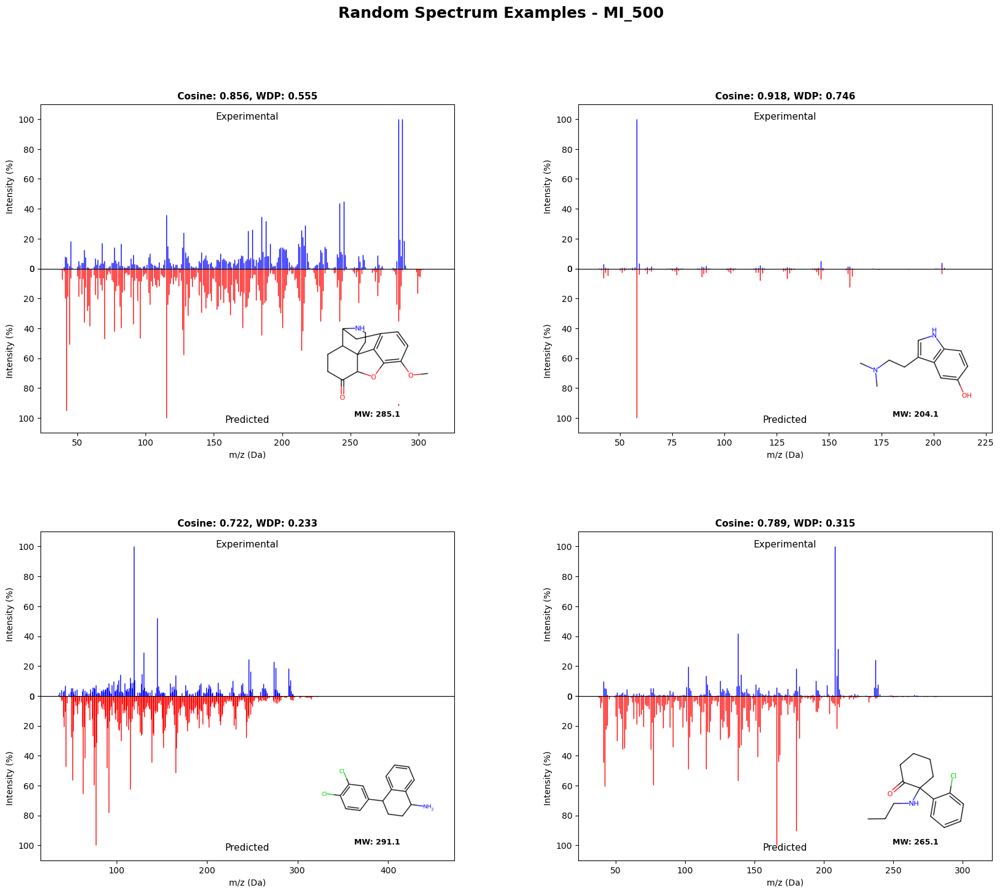


Visualizing MI_1000...


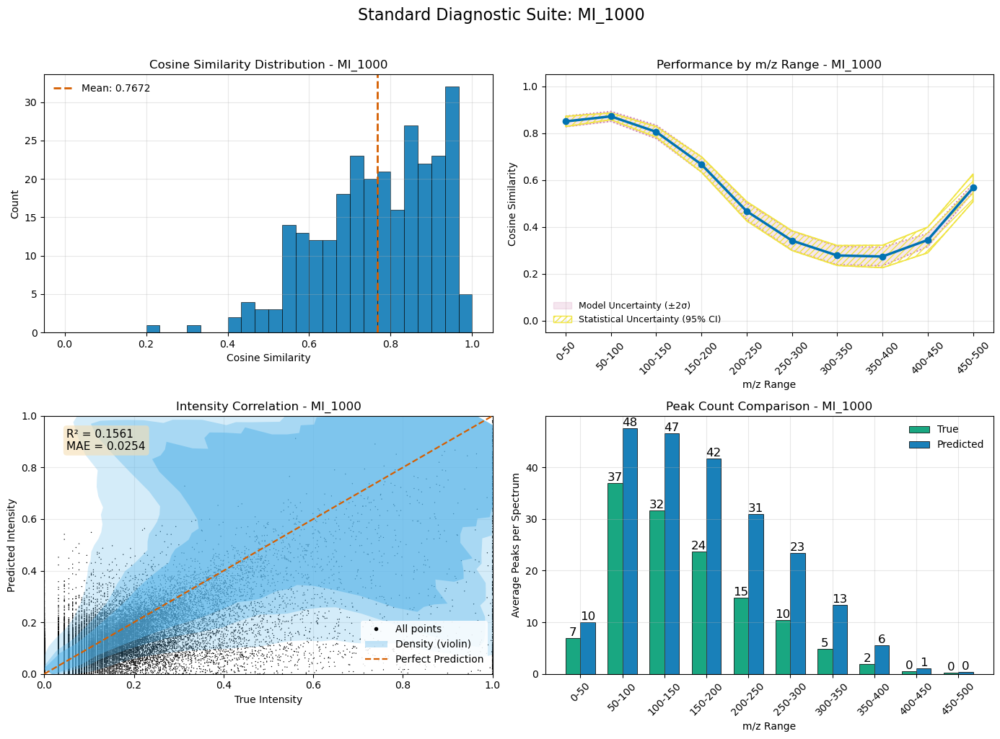


Selected random examples:
  1. Index 22: Cosine=0.9539, WDP=0.7879
  2. Index 86: Cosine=0.7769, WDP=0.3935
  3. Index 248: Cosine=0.9429, WDP=0.8675
  4. Index 202: Cosine=0.6671, WDP=0.2734


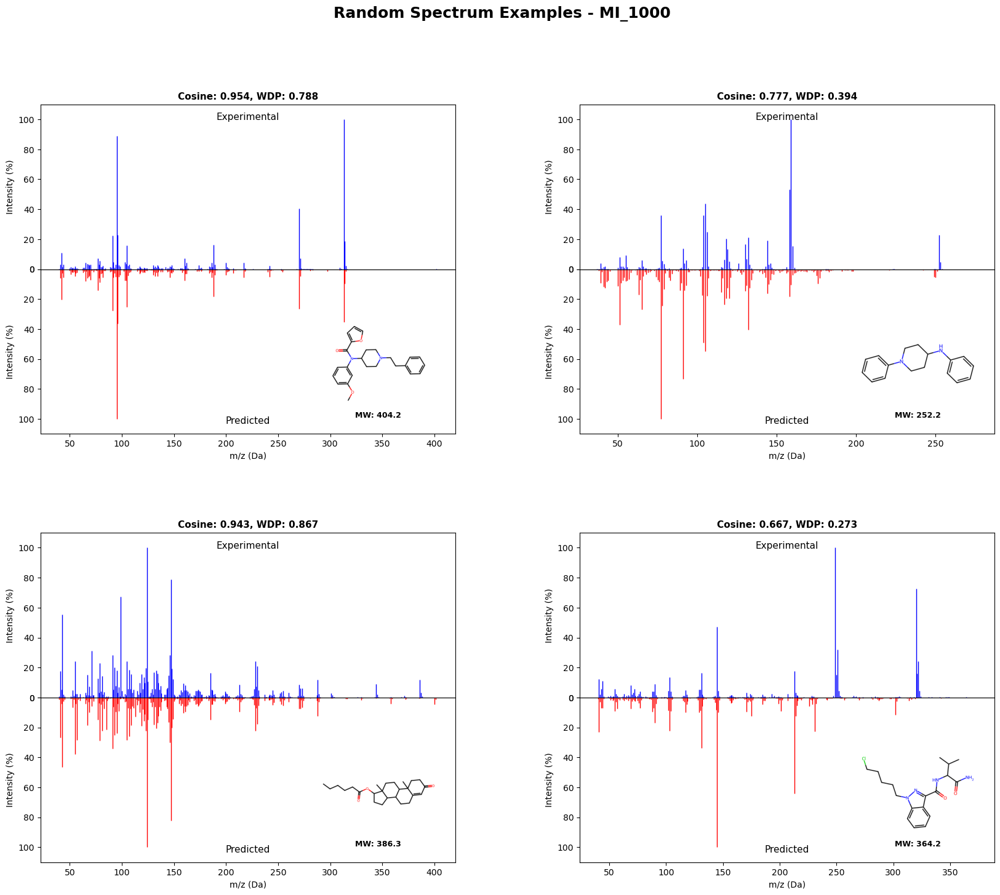


5.2 F-test Feature Selection
----------------------------------------
Computing F-test scores...
Evaluating F-test feature subsets in parallel...
  F-test_50: 50 features, Cosine Sim = 0.6643, Time = 14.8s
  F-test_100: 100 features, Cosine Sim = 0.7142, Time = 15.8s
  F-test_200: 200 features, Cosine Sim = 0.7307, Time = 17.4s
  F-test_500: 500 features, Cosine Sim = 0.7539, Time = 19.8s
  F-test_1000: 1000 features, Cosine Sim = 0.7636, Time = 20.2s

Visualizing F-test_50...


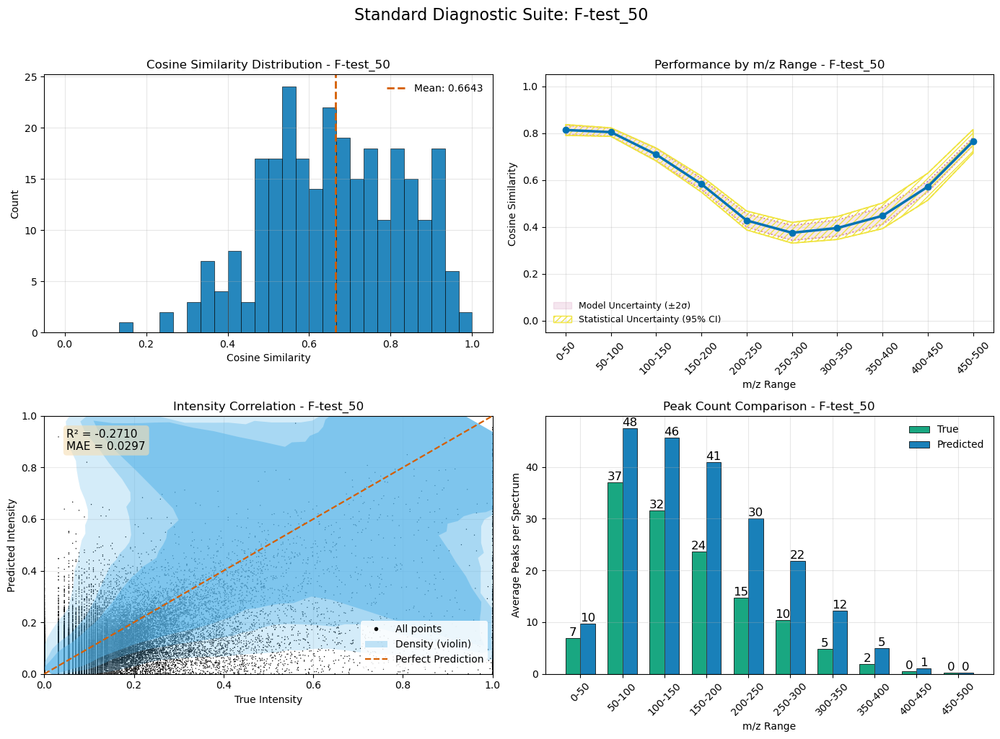


Selected random examples:
  1. Index 34: Cosine=0.4978, WDP=0.2862
  2. Index 47: Cosine=0.7368, WDP=0.2377
  3. Index 33: Cosine=0.9371, WDP=0.8836
  4. Index 166: Cosine=0.7921, WDP=0.4325


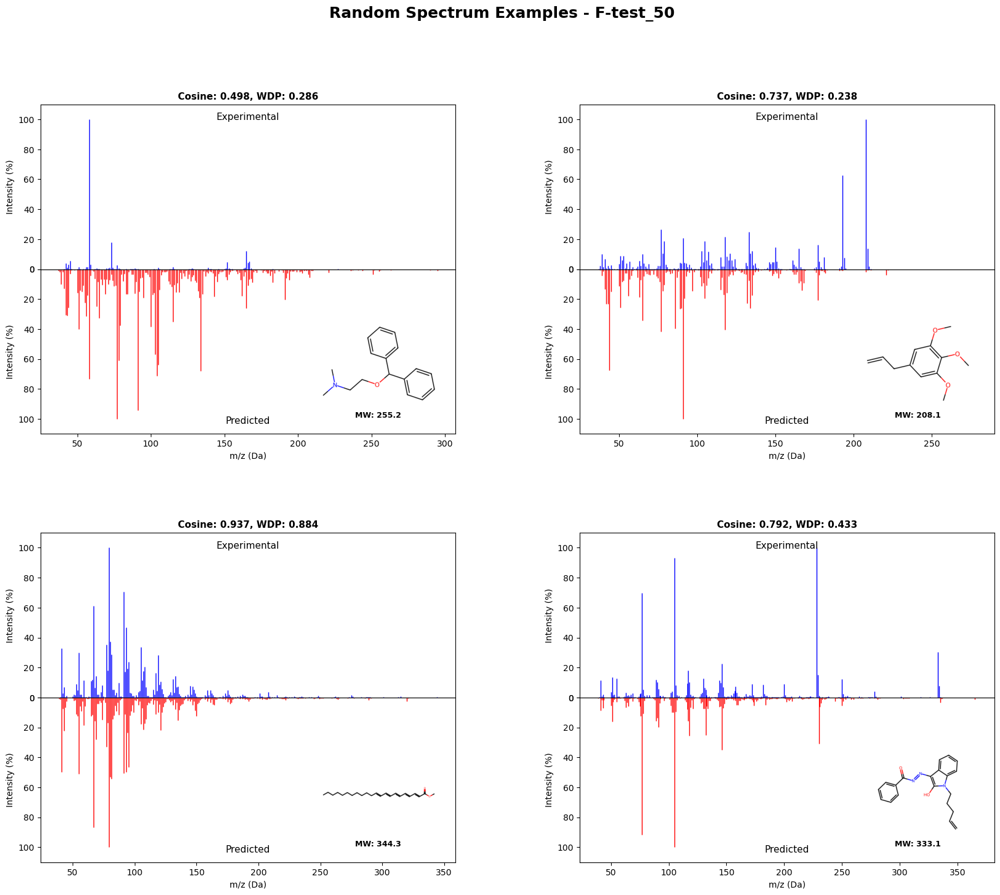


Visualizing F-test_100...


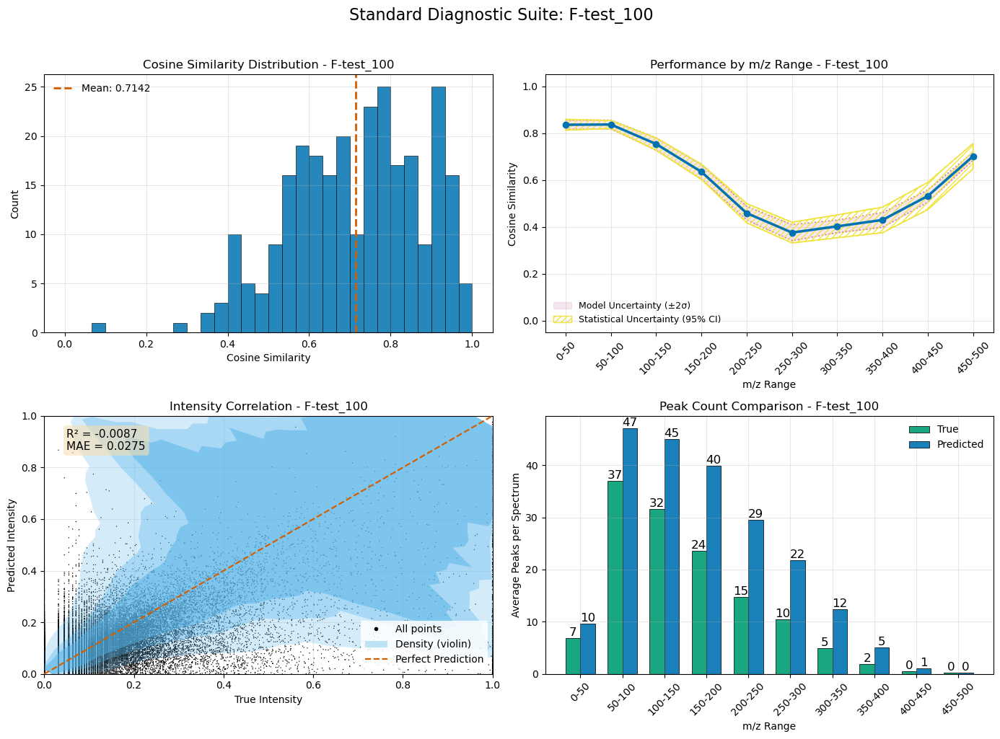


Selected random examples:
  1. Index 23: Cosine=0.8468, WDP=0.7461
  2. Index 178: Cosine=0.7173, WDP=0.2275
  3. Index 195: Cosine=0.6425, WDP=0.1916
  4. Index 226: Cosine=0.5814, WDP=0.2949


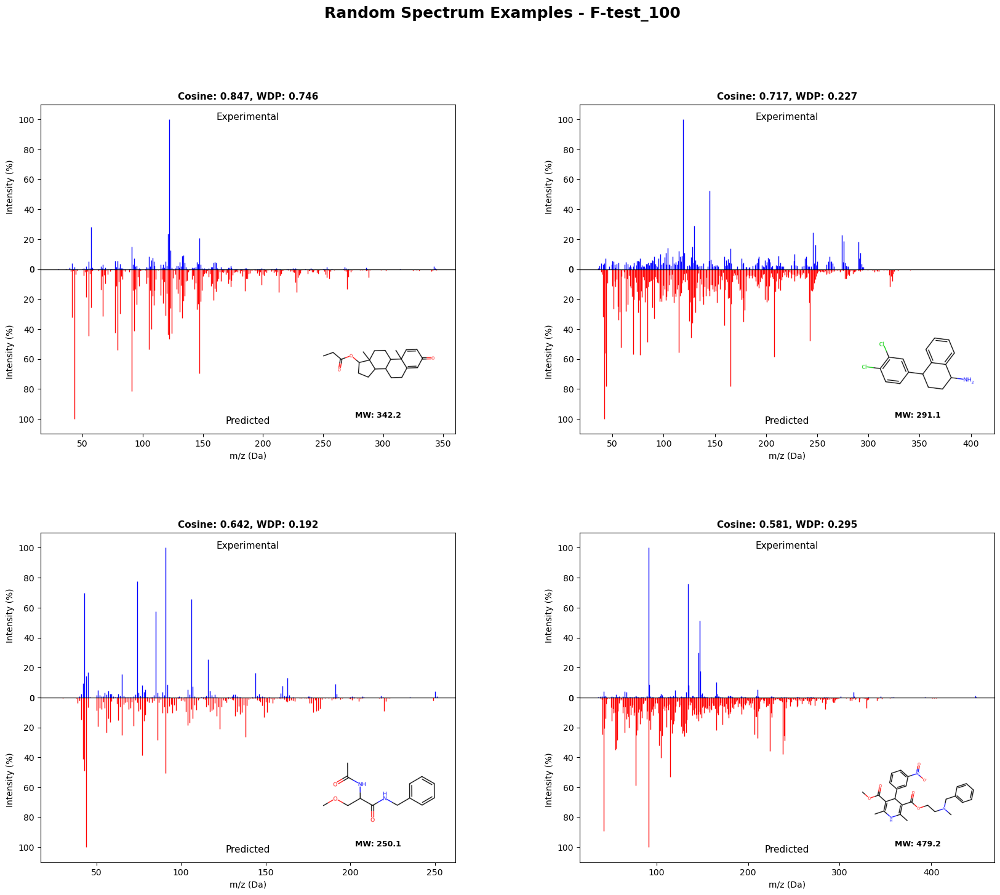


Visualizing F-test_200...


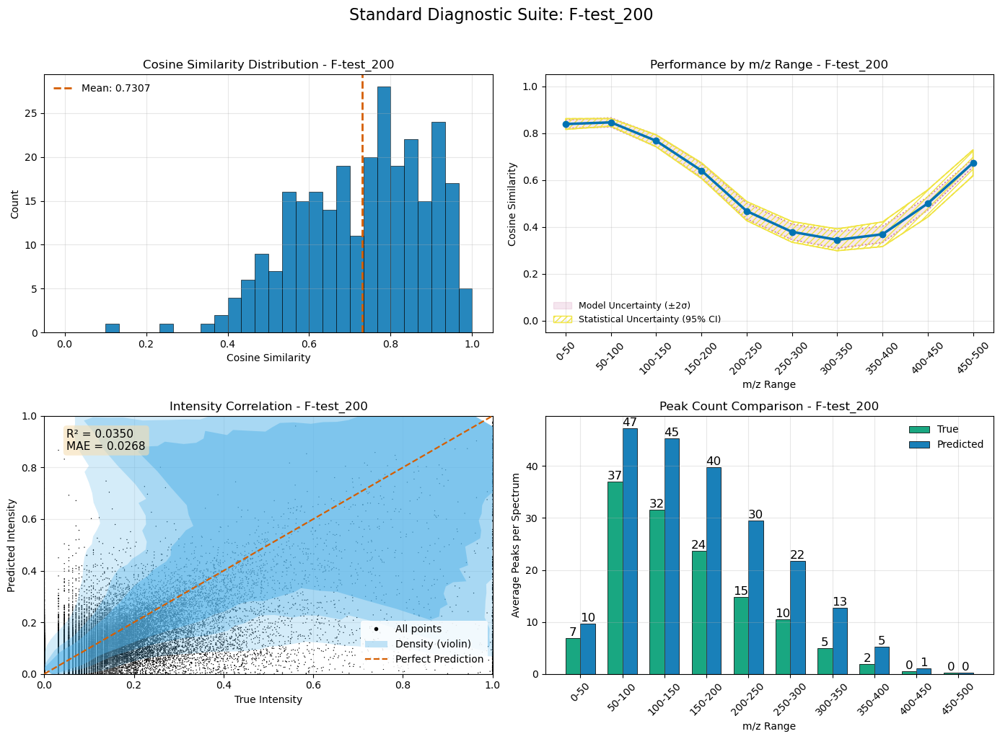


Selected random examples:
  1. Index 267: Cosine=0.5497, WDP=0.2139
  2. Index 28: Cosine=0.5786, WDP=0.2867
  3. Index 52: Cosine=0.6885, WDP=0.3775
  4. Index 93: Cosine=0.8239, WDP=0.5540


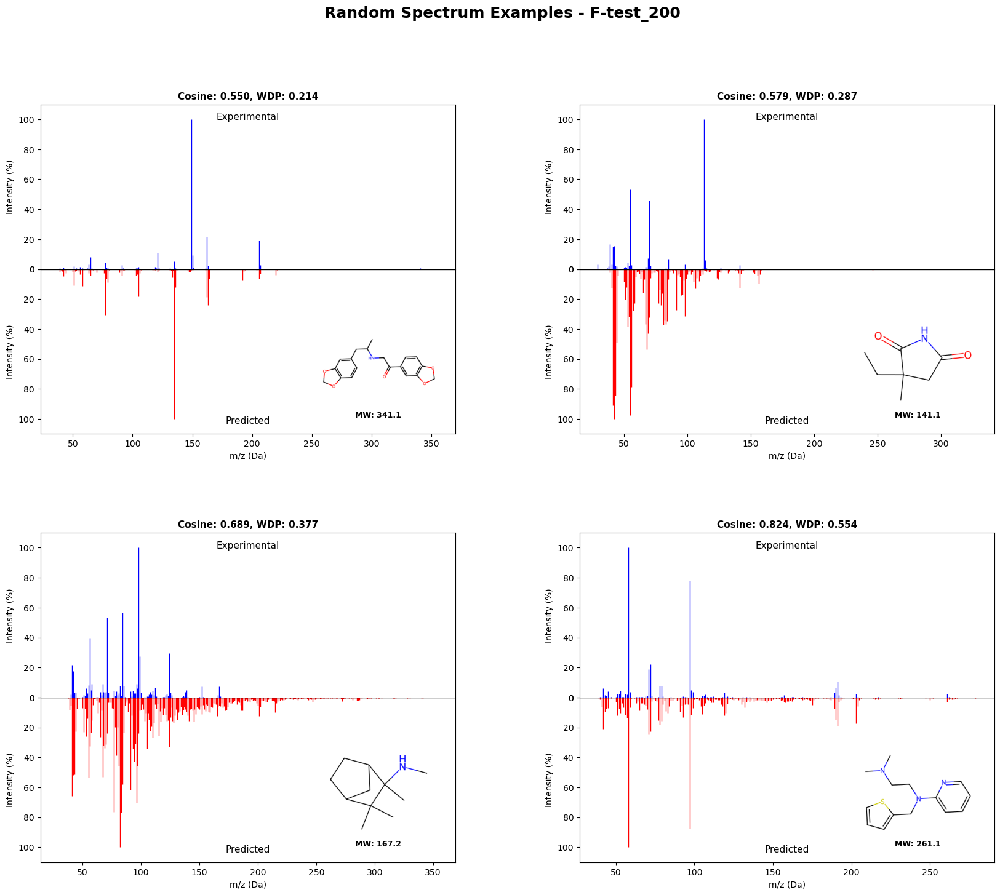


Visualizing F-test_500...


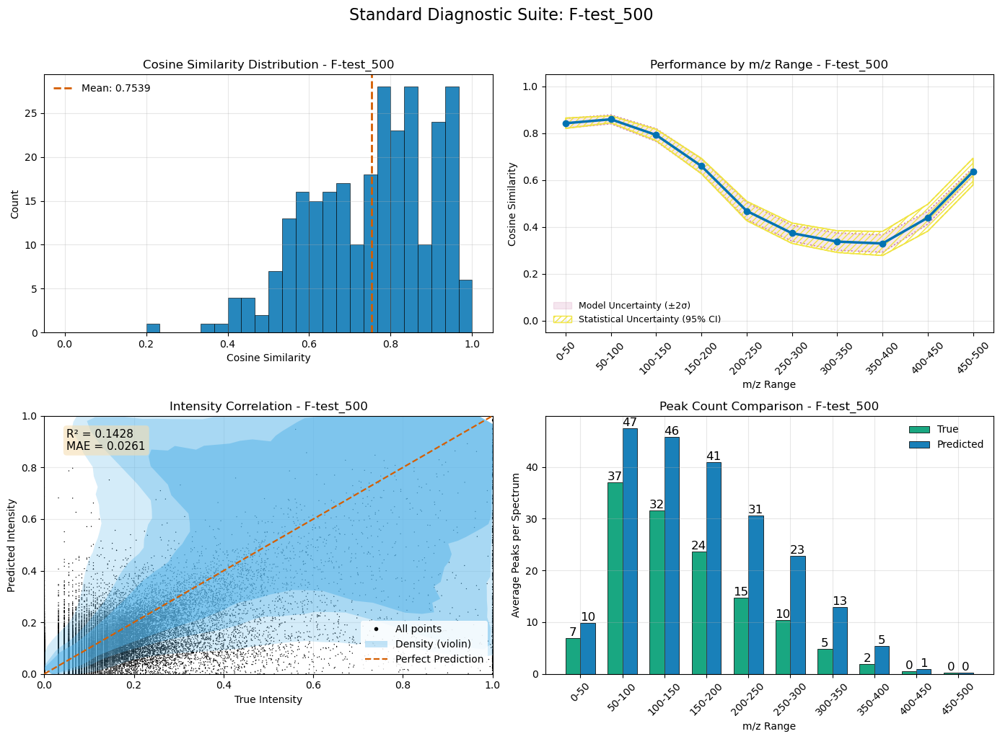


Selected random examples:
  1. Index 127: Cosine=0.8339, WDP=0.4926
  2. Index 173: Cosine=0.8584, WDP=0.5877
  3. Index 99: Cosine=0.8064, WDP=0.4319
  4. Index 271: Cosine=0.9526, WDP=0.8343


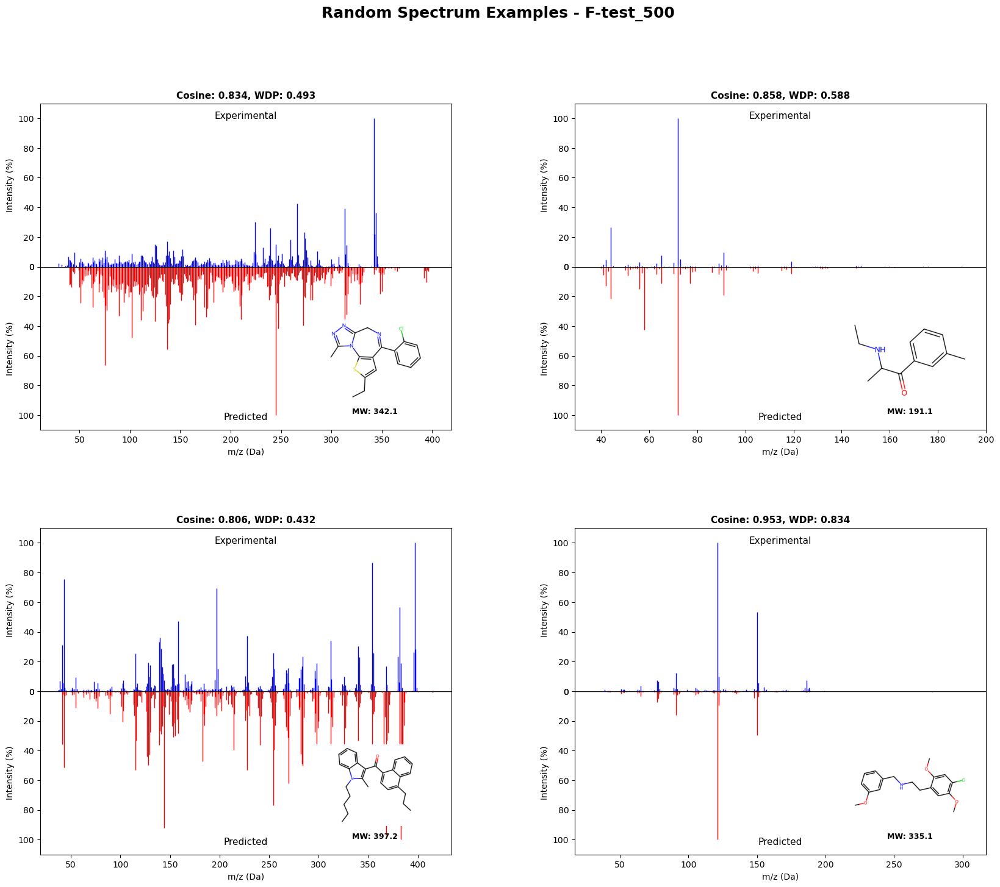


Visualizing F-test_1000...


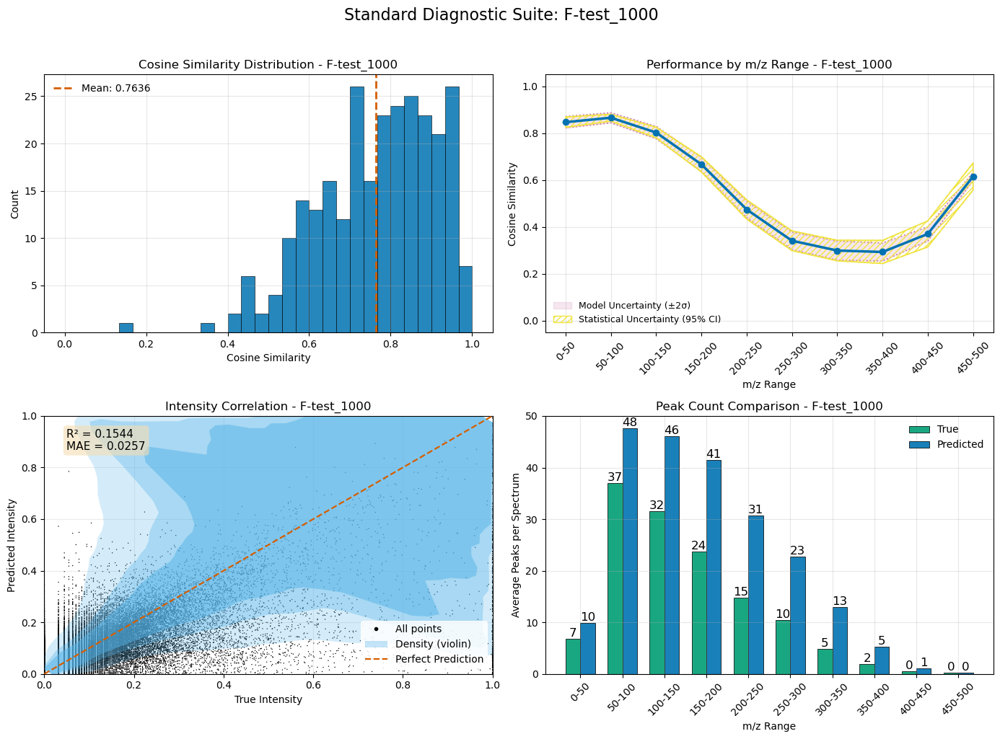


Selected random examples:
  1. Index 28: Cosine=0.5988, WDP=0.3021
  2. Index 252: Cosine=0.6463, WDP=0.3557
  3. Index 213: Cosine=0.8517, WDP=0.5407
  4. Index 12: Cosine=0.7138, WDP=0.2607


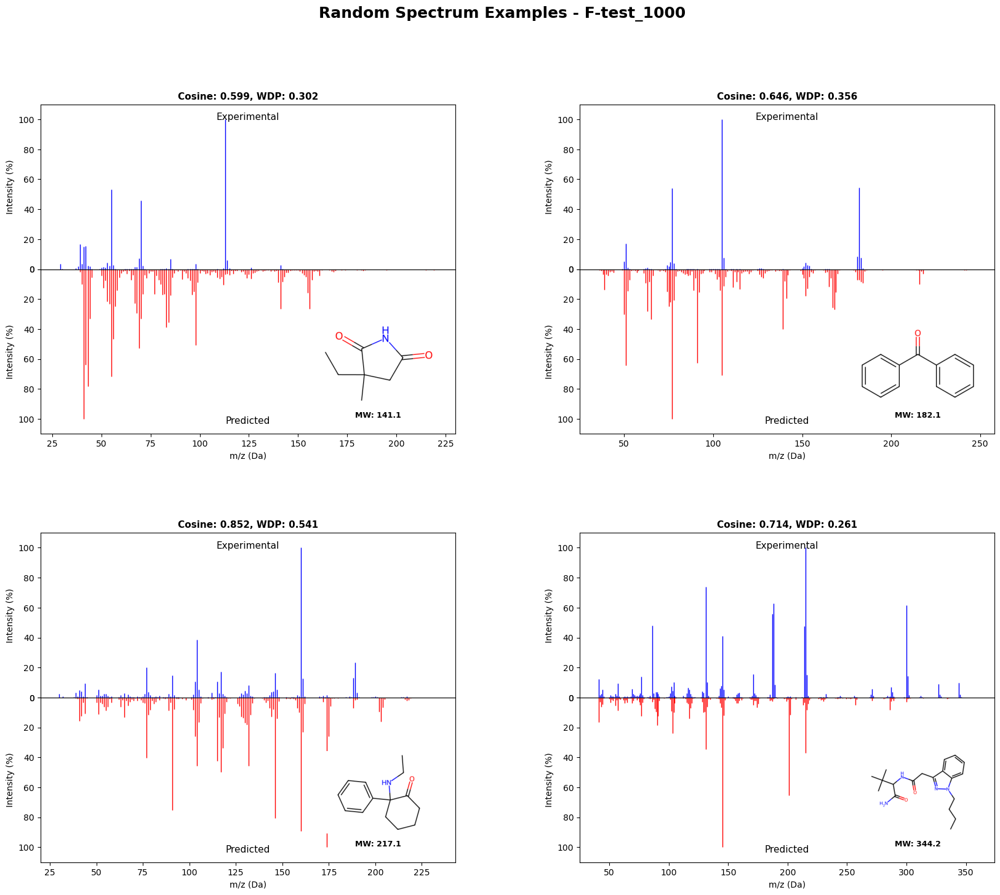


5.3 Correlation-based Feature Filtering
----------------------------------------
  Correlation_Filter: 5702 features, Cosine Sim = 0.7794, Time = 29.6s

Visualizing Correlation_Filter...


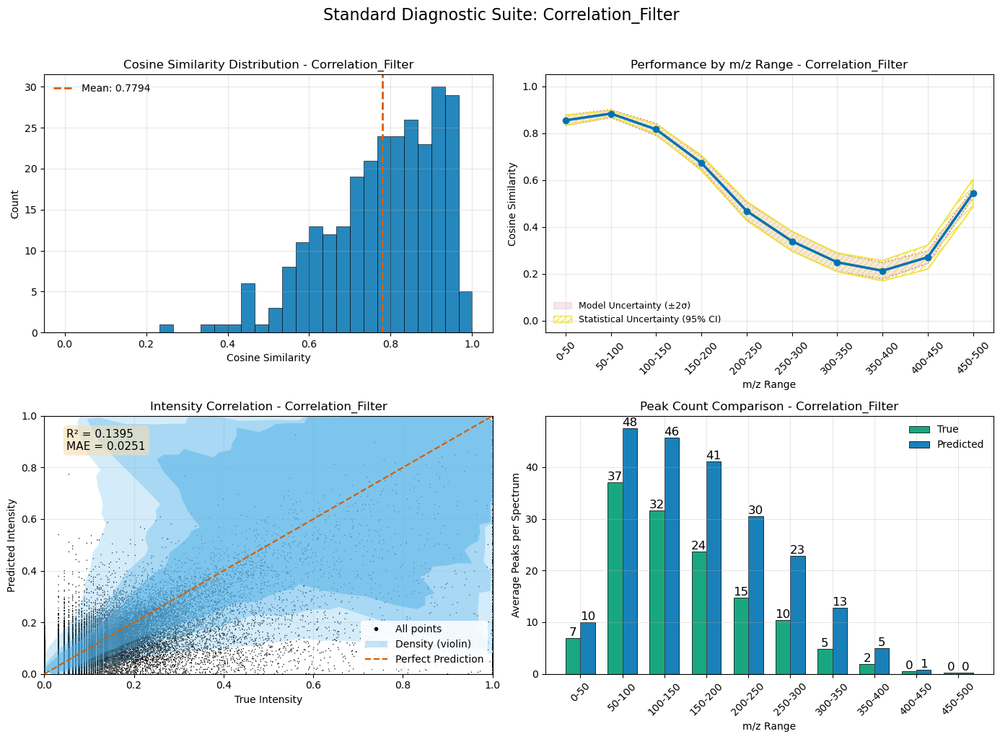


Selected random examples:
  1. Index 198: Cosine=0.8287, WDP=0.6984
  2. Index 207: Cosine=0.8021, WDP=0.4712
  3. Index 42: Cosine=0.7503, WDP=0.4209
  4. Index 156: Cosine=0.9111, WDP=0.5712


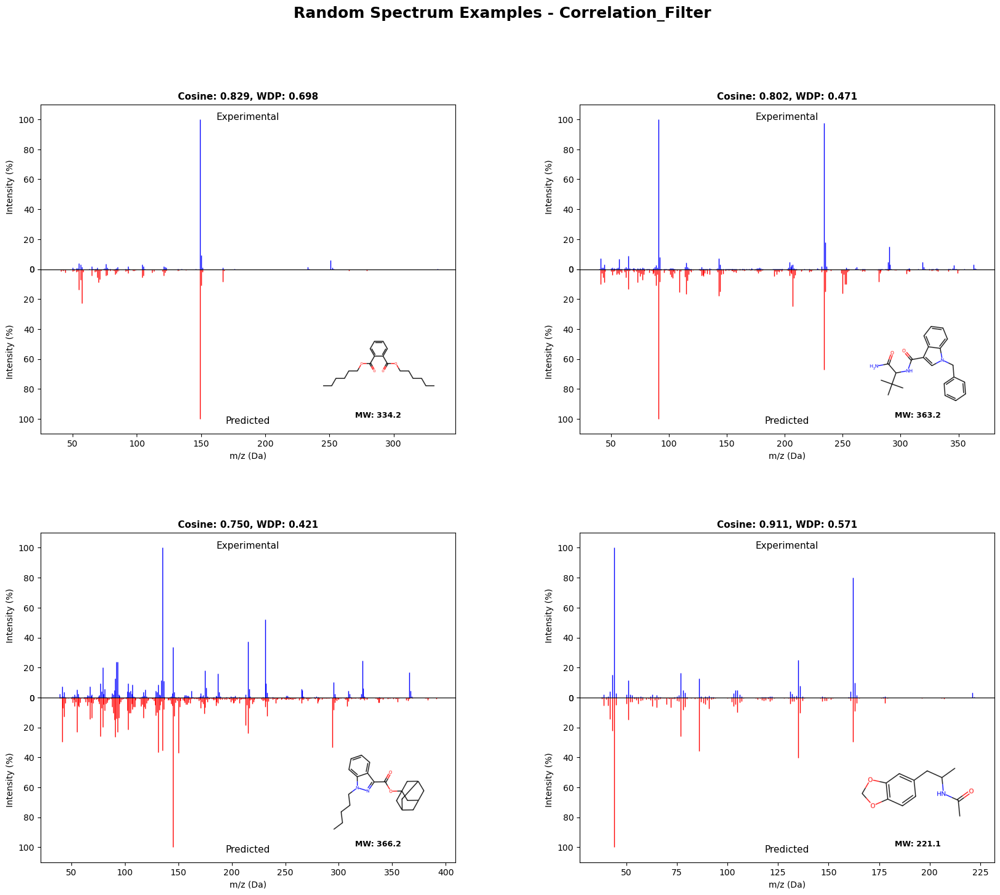

Results saved to ../data/results/selected_features/statistical_selection_results.pkl

Statistical feature selection complete


In [6]:
print("STATISTICAL FEATURE SELECTION")
print("=" * 60)

statistical_results = {}

# Use mean spectrum intensity as target for MI/F-test calculation
y_train_mean = y_train.mean(axis=1)

# 5.1 Mutual Information Selection (Parallel)
print("\n5.1 Mutual Information Feature Selection")
print("-" * 40)
print("Computing MI scores in parallel...")

# Get MI-based selections for all n_features values at once
mi_selections = parallel_mutual_info(
    X_train_var, y_train_mean,
    MASTER_CONFIG['selection']['target_features'],
    variance_indices,
    random_state=MASTER_CONFIG['statistical']['mutual_info']['random_state']
)

# Prepare evaluation tasks
mi_eval_tasks = []
for n_features, selected_indices in mi_selections.items():
    mi_eval_tasks.append({
        'X_train': X_train,
        'y_train': y_train,
        'X_test': X_test,
        'y_test': y_test,
        'features': selected_indices,
        'method': f"MI_{n_features}"
    })

# Evaluate MI selections in parallel
print("Evaluating MI feature subsets in parallel...")
mi_results = parallel_evaluate(mi_eval_tasks)
for result in mi_results:
    statistical_results[result['method']] = result
    # Generate standard plots for each MI result
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing {result['method']}...")
        plot_standard_2x2_diagnostic(result, result['method'])
        plot_random_spectrum_grid(result, test_smiles, n_examples=4, model_name=result['method'])

# 5.2 F-test Selection (Parallel)
print("\n5.2 F-test Feature Selection")
print("-" * 40)
print("Computing F-test scores...")

# Calculate F-scores once
f_scores, _ = f_regression(X_train_var, y_train_mean)

# Prepare F-test evaluation tasks
f_eval_tasks = []
for n_features in MASTER_CONFIG['selection']['target_features']:
    if n_features > X_train_var.shape[1]:
        continue
    
    # Get top n features by F-score
    top_indices = np.argsort(f_scores)[::-1][:n_features]
    f_indices = variance_indices[top_indices]
    
    f_eval_tasks.append({
        'X_train': X_train,
        'y_train': y_train,
        'X_test': X_test,
        'y_test': y_test,
        'features': f_indices,
        'method': f"F-test_{n_features}"
    })

# Evaluate F-test selections in parallel
print("Evaluating F-test feature subsets in parallel...")
f_results = parallel_evaluate(f_eval_tasks)
for result in f_results:
    statistical_results[result['method']] = result
    # Generate standard plots for each F-test result
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing {result['method']}...")
        plot_standard_2x2_diagnostic(result, result['method'])
        plot_random_spectrum_grid(result, test_smiles, n_examples=4, model_name=result['method'])

# 5.3 Correlation-based Filtering
print("\n5.3 Correlation-based Feature Filtering")
print("-" * 40)

# Fixed remove_correlated_features function inline
def remove_correlated_features_fixed(X, threshold=0.95):
    """Remove highly correlated features using efficient numpy operations."""
    # Calculate correlation matrix
    corr_matrix = np.corrcoef(X.T)
    
    # Find highly correlated pairs
    upper_triangle = np.triu(np.ones_like(corr_matrix, dtype=bool), k=1)
    high_corr_mask = np.abs(corr_matrix) > threshold
    high_corr_pairs = np.where(high_corr_mask & upper_triangle)
    
    # Remove features
    features_to_remove = set()
    variances = np.var(X, axis=0)
    
    for i, j in zip(high_corr_pairs[0], high_corr_pairs[1]):
        # Keep feature with higher variance
        if variances[i] < variances[j]:
            features_to_remove.add(i)
        else:
            features_to_remove.add(j)
    
    selected_features = [i for i in range(X.shape[1]) if i not in features_to_remove]
    return np.array(selected_features)

# Remove correlated features
uncorr_indices = remove_correlated_features_fixed(
    X_train_var, 
    threshold=MASTER_CONFIG['selection']['correlation_threshold']
)
uncorr_indices = variance_indices[uncorr_indices]

results = evaluate_feature_subset(
    X_train, y_train, X_test, y_test,
    uncorr_indices, "Correlation_Filter"
)
statistical_results["Correlation_Filter"] = results

# Generate standard plots for correlation filter
if MASTER_CONFIG['evaluation']['show_plots']:
    print(f"\nVisualizing Correlation_Filter...")
    plot_standard_2x2_diagnostic(results, "Correlation_Filter")
    plot_random_spectrum_grid(results, test_smiles, n_examples=4, model_name="Correlation_Filter")

# Save statistical results
save_selection_results(statistical_results, "statistical")

print("\nStatistical feature selection complete")

## 6. Model-Based Feature Selection

Use machine learning models to identify important features.

### 6.1 Random Forest Feature Importance

Tree-based models provide feature importance scores based on:
- Mean decrease in impurity (Gini importance)
- Frequency of feature usage in splits

### 6.2 LASSO Regularization

LASSO (L1 regularization) induces sparsity:

$$\min_{\beta} \frac{1}{2n} ||y - X\beta||_2^2 + \lambda ||\beta||_1$$

Features with zero coefficients are effectively removed.

### 6.3 Recursive Feature Elimination (RFE)

RFE recursively removes features based on model importance:
1. Train model on all features
2. Remove least important features
3. Repeat until desired number reached

**Note**: RFE is computed with a subset of estimators for efficiency.

MODEL-BASED FEATURE SELECTION

6.1 Random Forest Feature Importance
----------------------------------------
Evaluating RF importance feature subsets in parallel...
  RF_Importance_50: 50 features, Cosine Sim = 0.7551, Time = 26.1s
  RF_Importance_100: 100 features, Cosine Sim = 0.7606, Time = 31.4s
  RF_Importance_200: 200 features, Cosine Sim = 0.7681, Time = 32.6s
  RF_Importance_500: 500 features, Cosine Sim = 0.7751, Time = 34.3s
  RF_Importance_1000: 1000 features, Cosine Sim = 0.7772, Time = 35.9s

Visualizing RF_Importance_50...


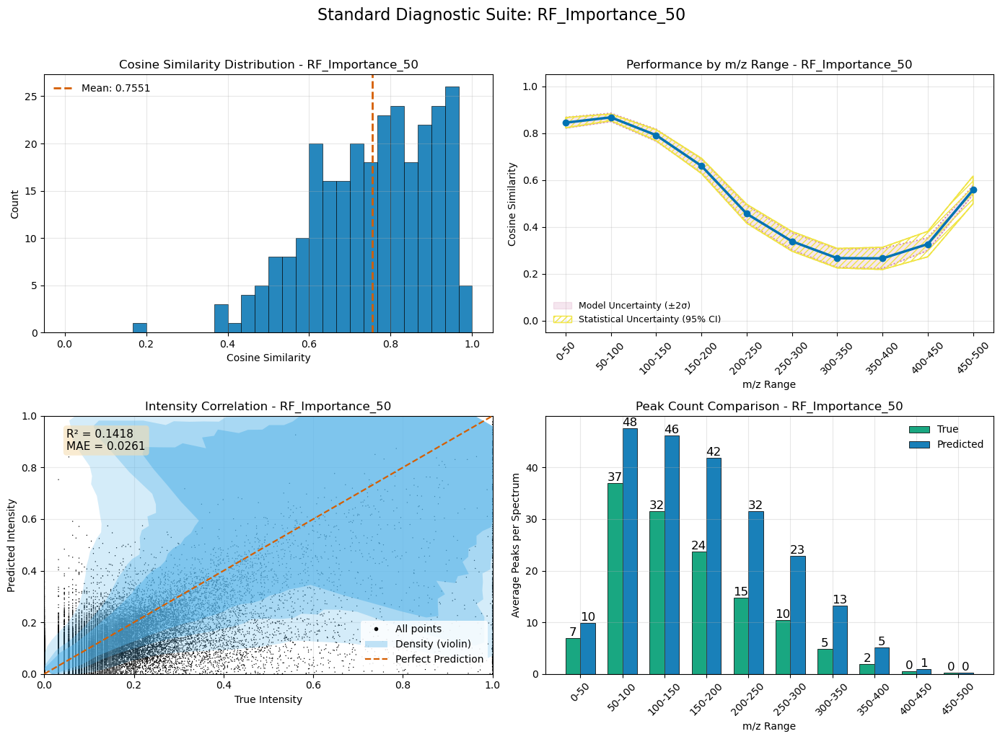


Selected random examples:
  1. Index 53: Cosine=0.9158, WDP=0.6068
  2. Index 225: Cosine=0.9173, WDP=0.5929
  3. Index 170: Cosine=0.7690, WDP=0.3469
  4. Index 15: Cosine=0.7370, WDP=0.3171


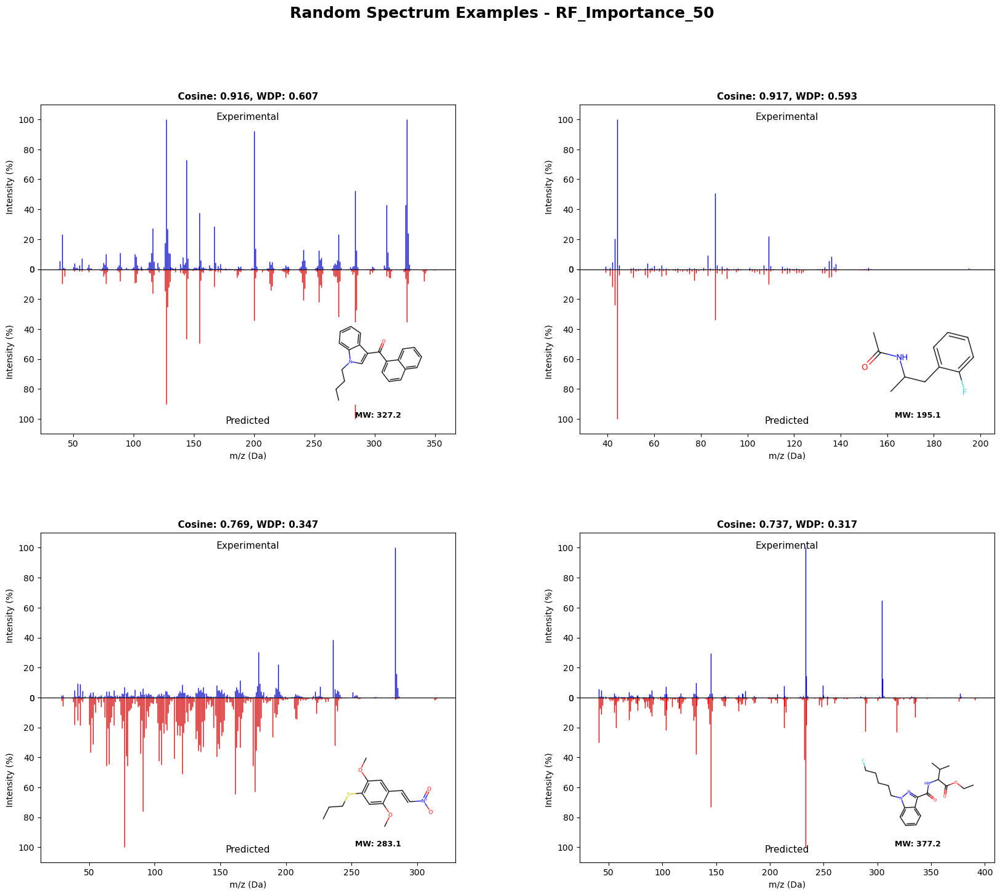


Visualizing RF_Importance_100...


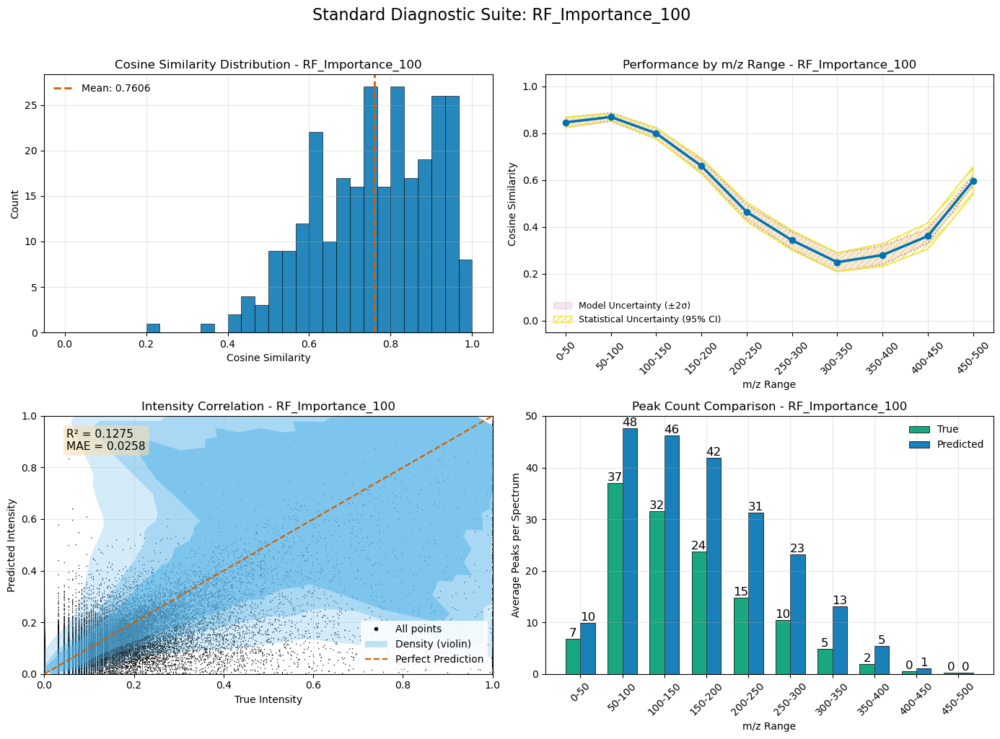


Selected random examples:
  1. Index 227: Cosine=0.5742, WDP=0.1577
  2. Index 79: Cosine=0.9388, WDP=0.7396
  3. Index 220: Cosine=0.7372, WDP=0.3136
  4. Index 261: Cosine=0.9676, WDP=0.6160


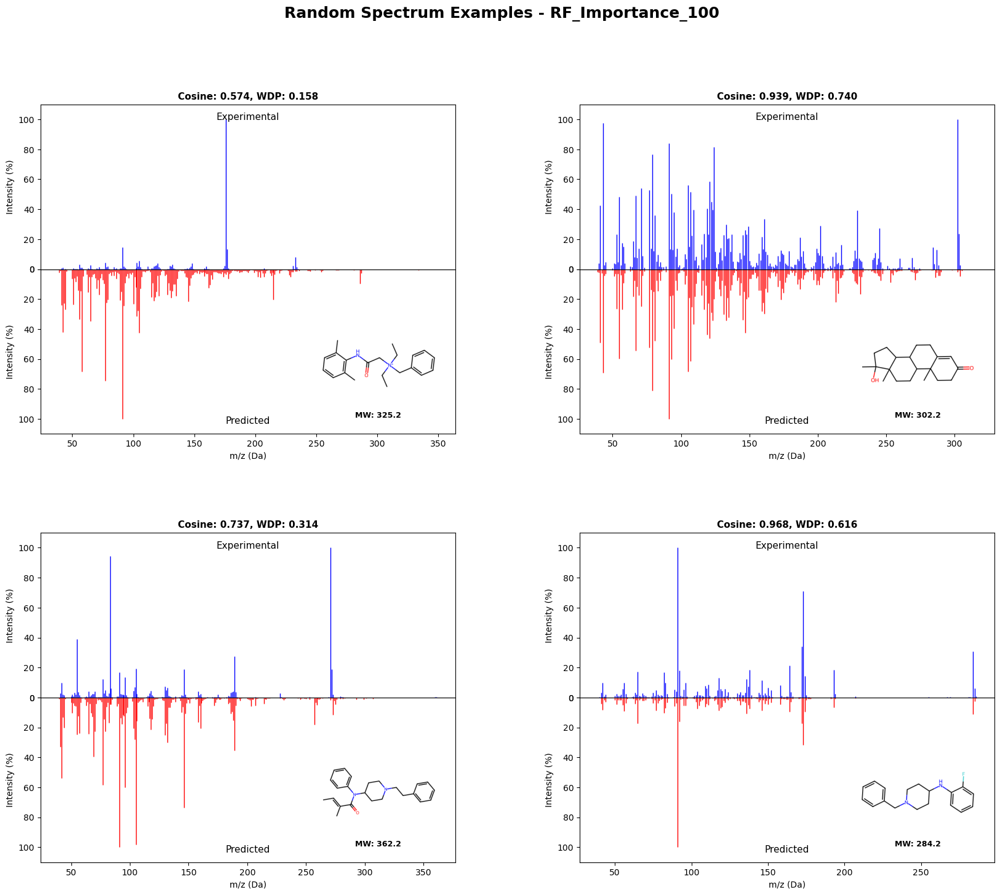


Visualizing RF_Importance_200...


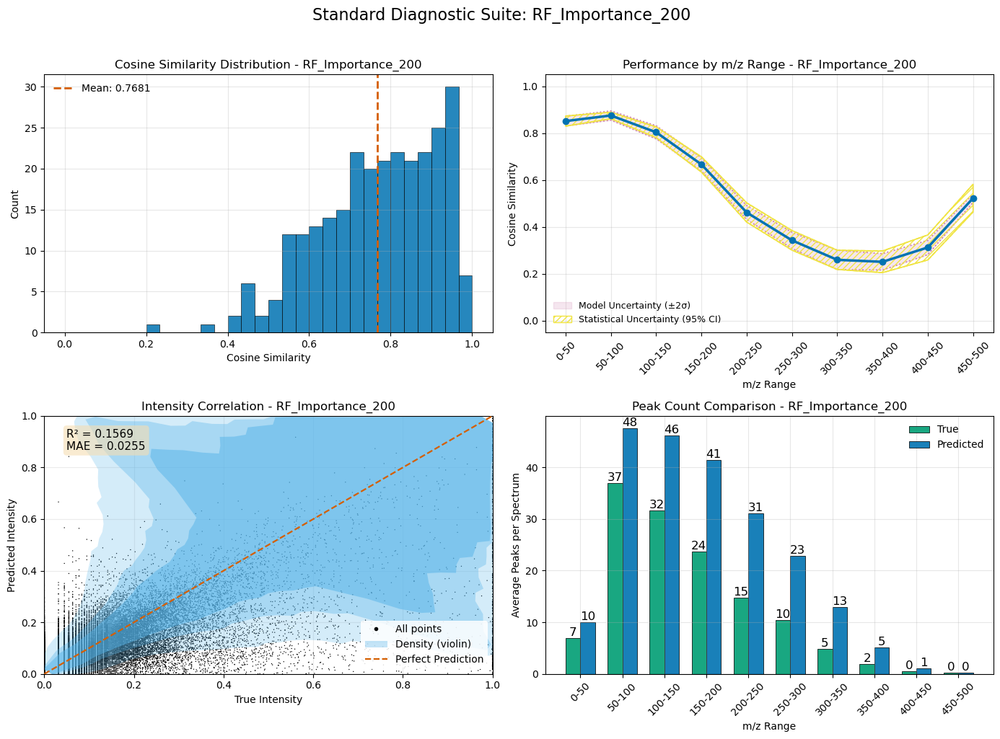


Selected random examples:
  1. Index 196: Cosine=0.7974, WDP=0.4553
  2. Index 66: Cosine=0.7929, WDP=0.4291
  3. Index 201: Cosine=0.8606, WDP=0.6040
  4. Index 237: Cosine=0.4915, WDP=0.1478


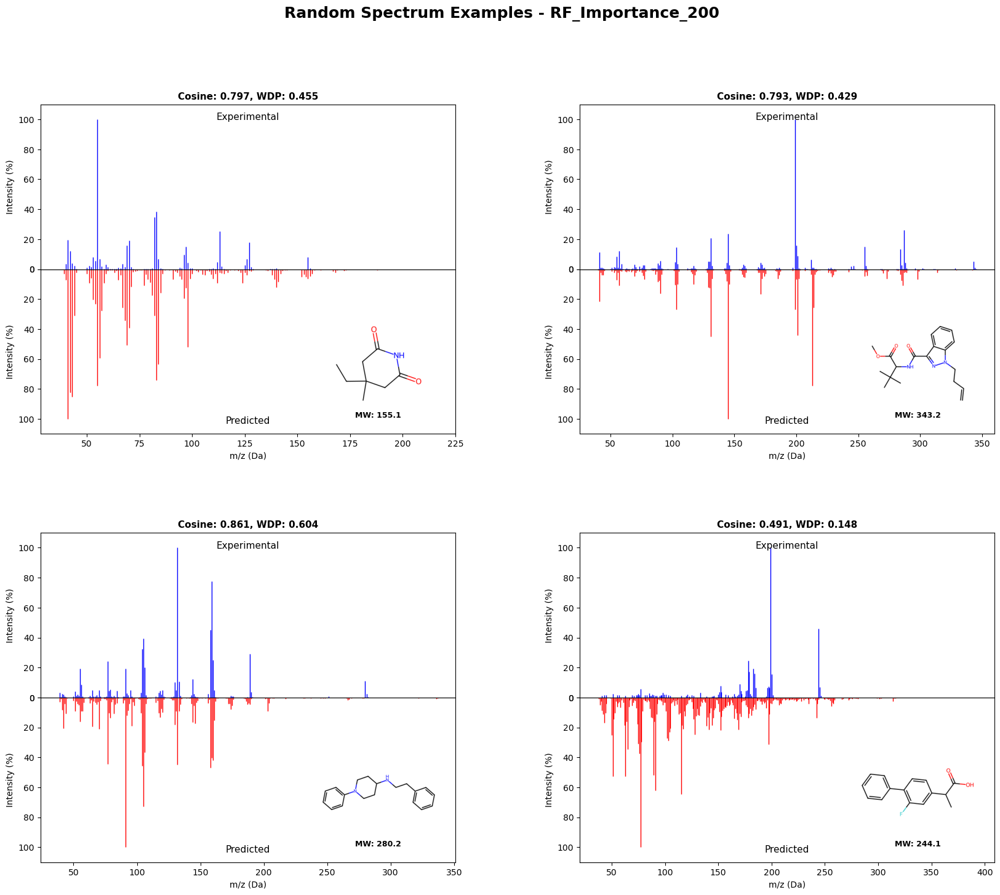


Visualizing RF_Importance_500...


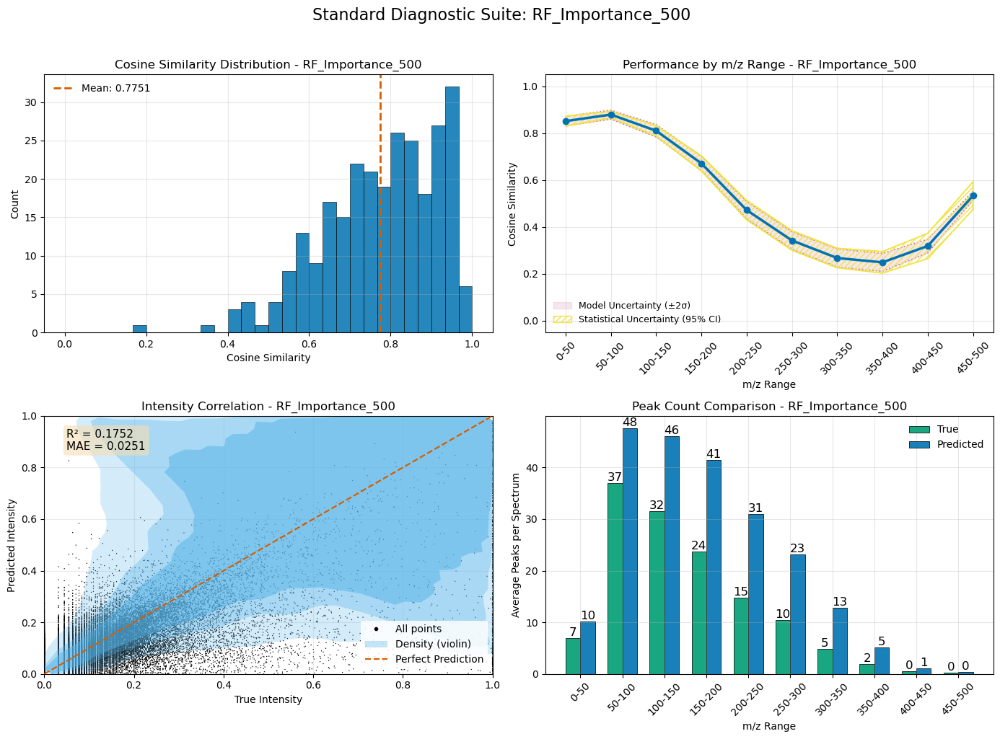


Selected random examples:
  1. Index 97: Cosine=0.9110, WDP=0.7490
  2. Index 201: Cosine=0.8650, WDP=0.6378
  3. Index 76: Cosine=0.5678, WDP=0.2033
  4. Index 185: Cosine=0.7298, WDP=0.2338


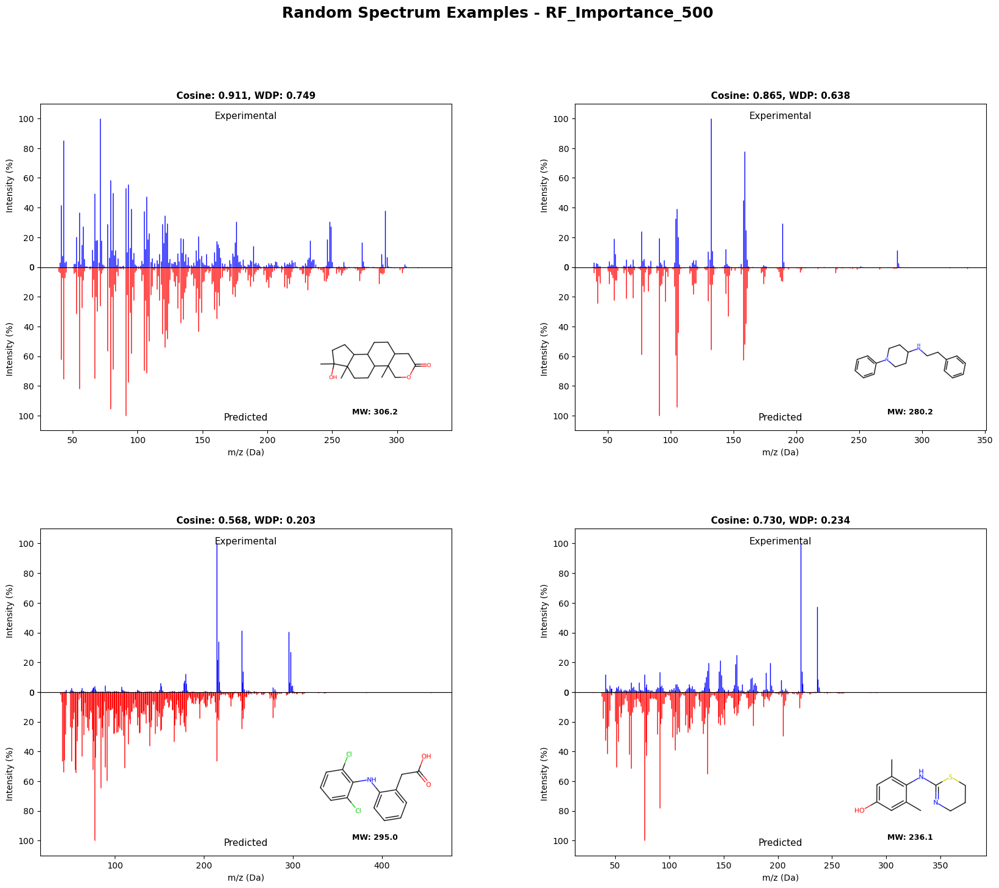


Visualizing RF_Importance_1000...


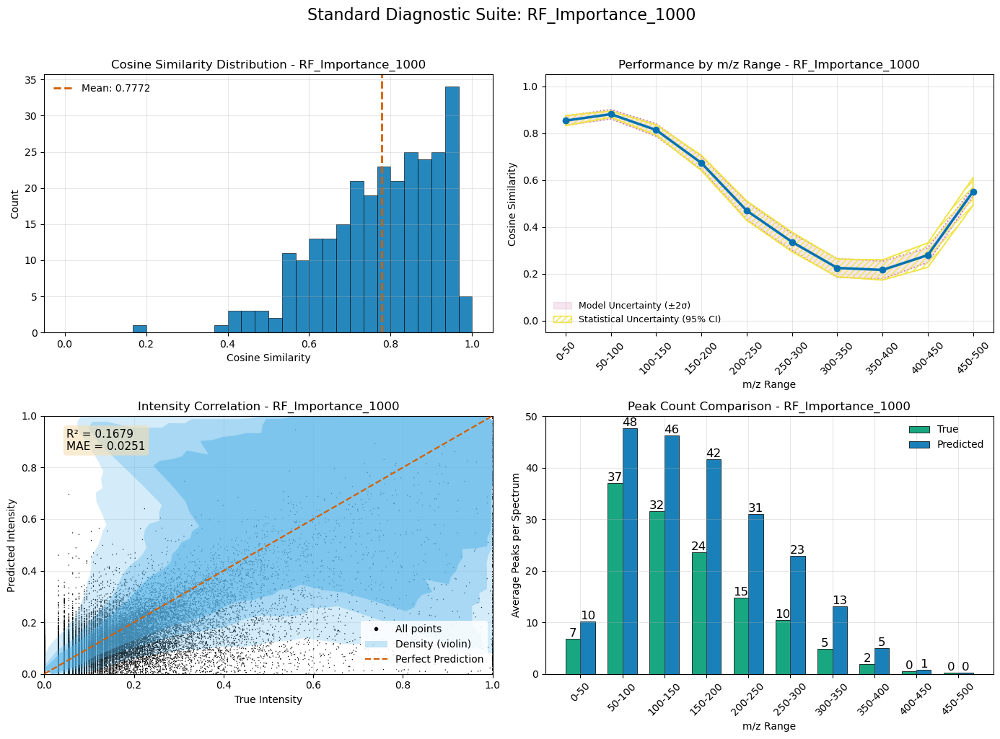


Selected random examples:
  1. Index 102: Cosine=0.5625, WDP=0.2093
  2. Index 86: Cosine=0.7983, WDP=0.4599
  3. Index 49: Cosine=0.5938, WDP=0.1771
  4. Index 266: Cosine=0.8988, WDP=0.6973


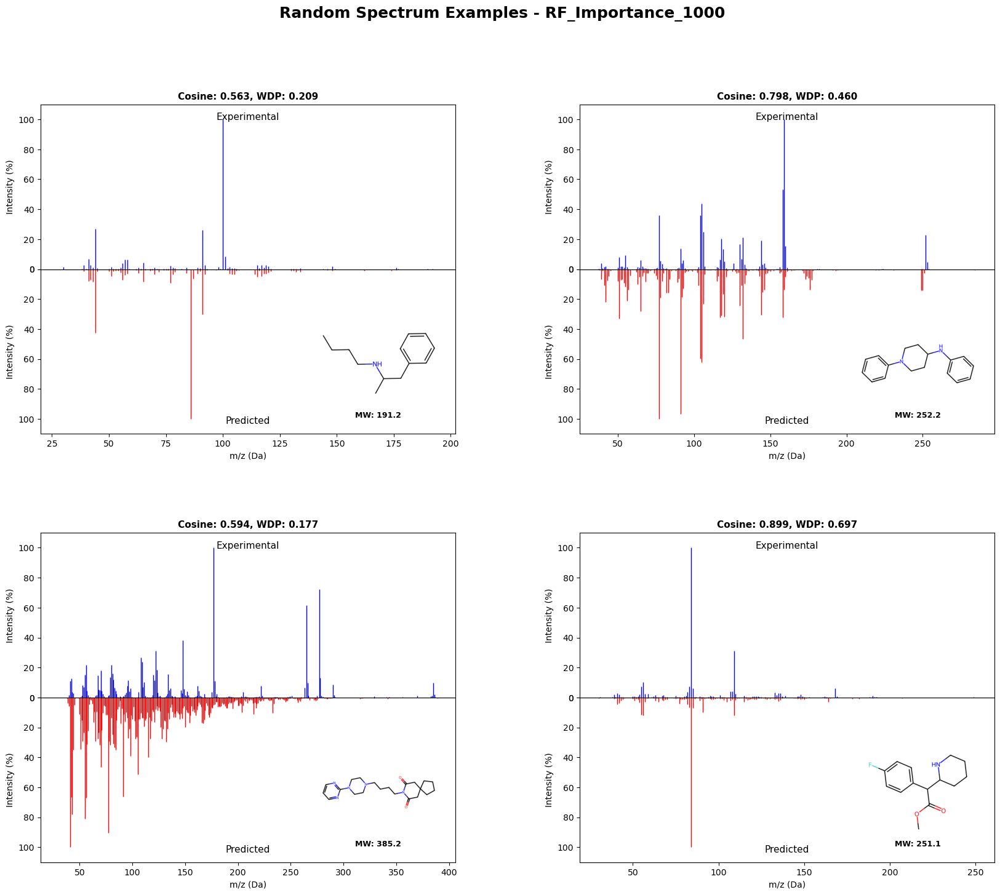


6.2 LASSO Feature Selection
----------------------------------------
  LASSO_1: 1 features, Cosine Sim = 0.5486, Time = 2.0s

LASSO selected 1 features with alpha=6097.8392

Visualizing LASSO_1...


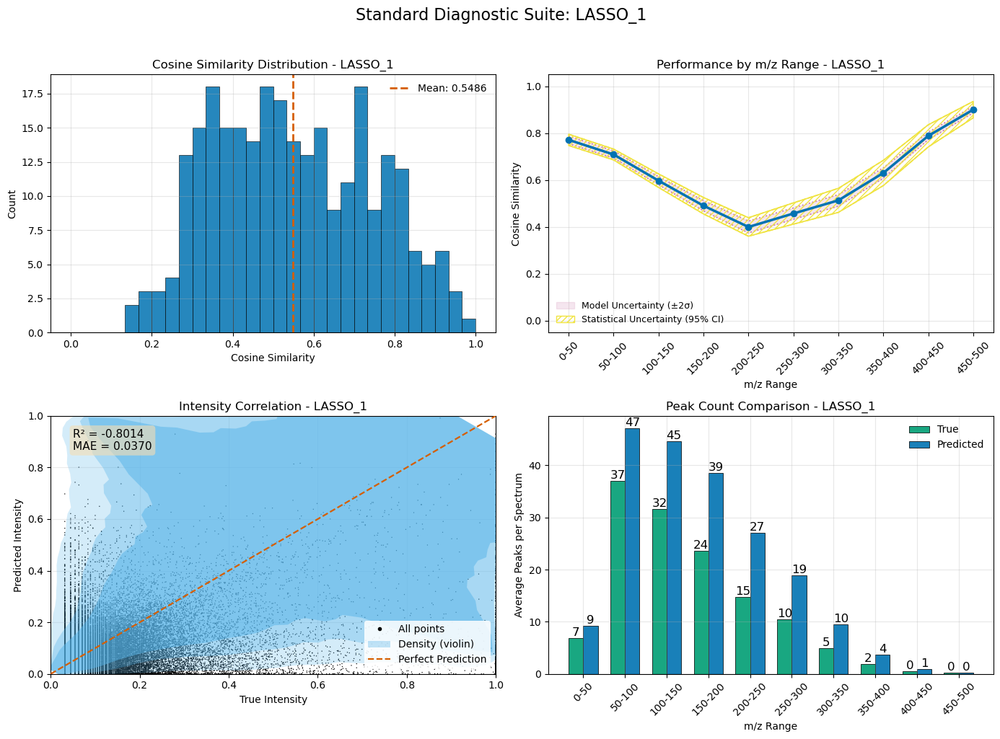


Selected random examples:
  1. Index 268: Cosine=0.6087, WDP=0.3236
  2. Index 86: Cosine=0.7861, WDP=0.5457
  3. Index 50: Cosine=0.1383, WDP=0.0369
  4. Index 141: Cosine=0.7710, WDP=0.2565


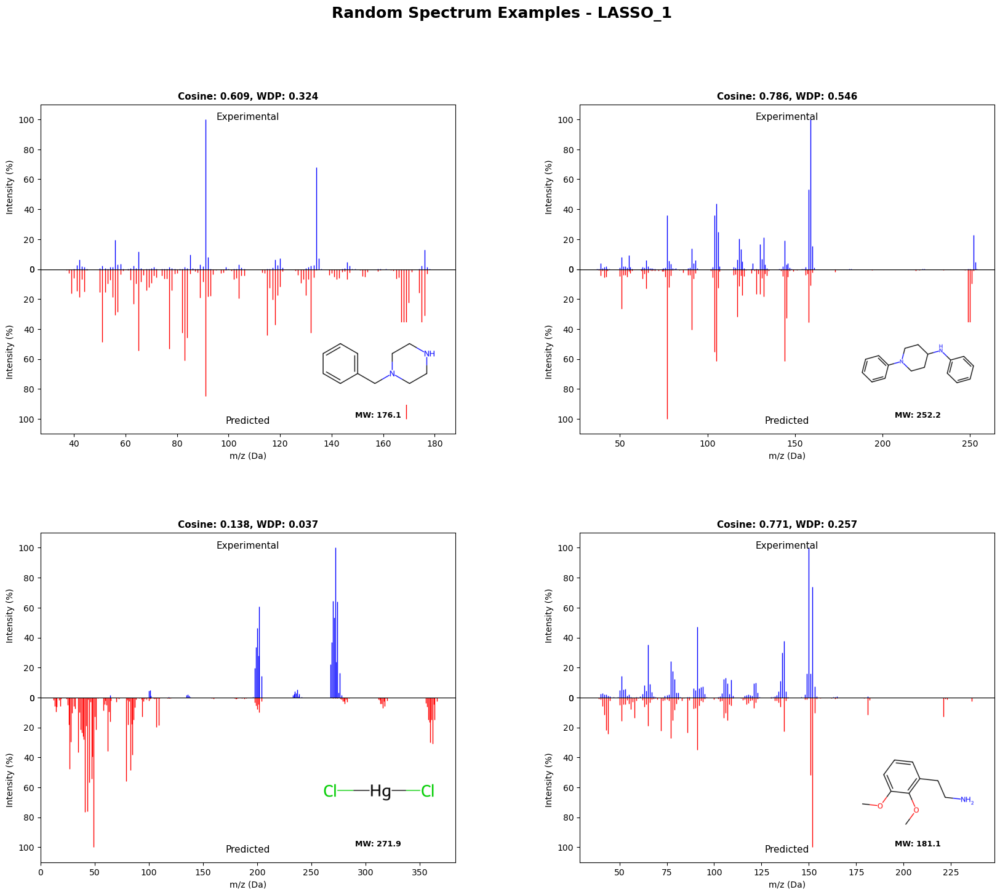


6.3 Recursive Feature Elimination (RFE)
----------------------------------------
  Running RFE for 100 features...
  RFE_100: 100 features, Cosine Sim = 0.7603, Time = 6.7s

Visualizing RFE_100...


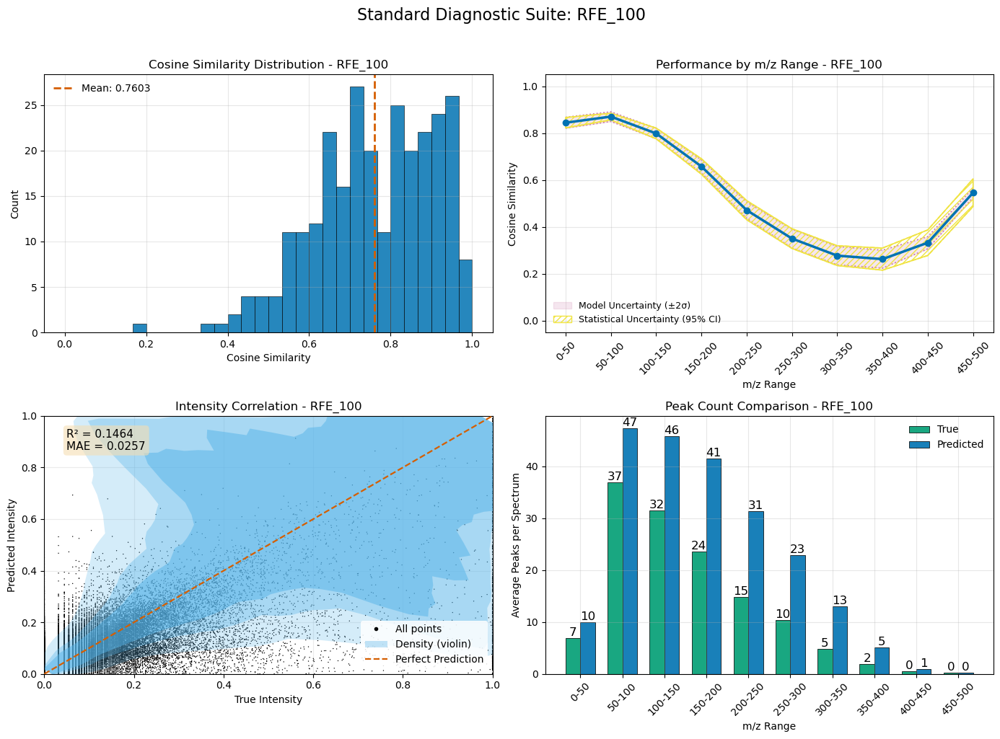


Selected random examples:
  1. Index 20: Cosine=0.7021, WDP=0.1935
  2. Index 255: Cosine=0.9770, WDP=0.9311
  3. Index 62: Cosine=0.7204, WDP=0.3092
  4. Index 216: Cosine=0.7408, WDP=0.2068


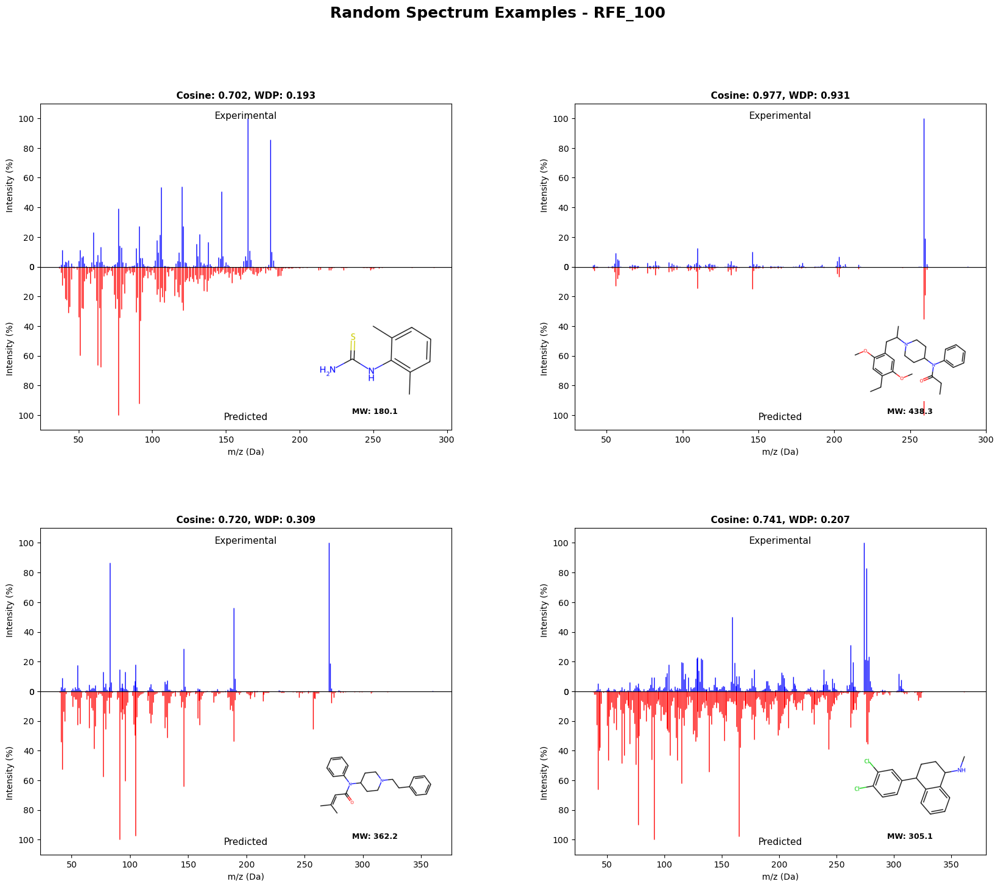

  Running RFE for 200 features...
  RFE_200: 200 features, Cosine Sim = 0.7672, Time = 8.4s

Visualizing RFE_200...


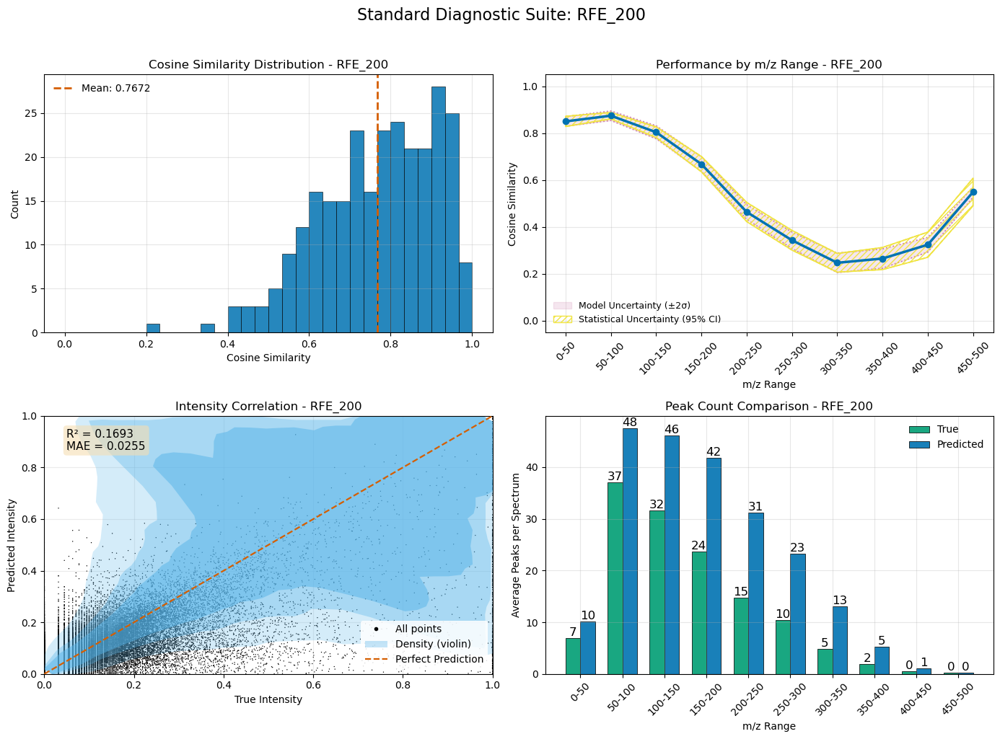


Selected random examples:
  1. Index 119: Cosine=0.6369, WDP=0.2400
  2. Index 44: Cosine=0.9131, WDP=0.5566
  3. Index 177: Cosine=0.7204, WDP=0.2665
  4. Index 101: Cosine=0.9145, WDP=0.6762


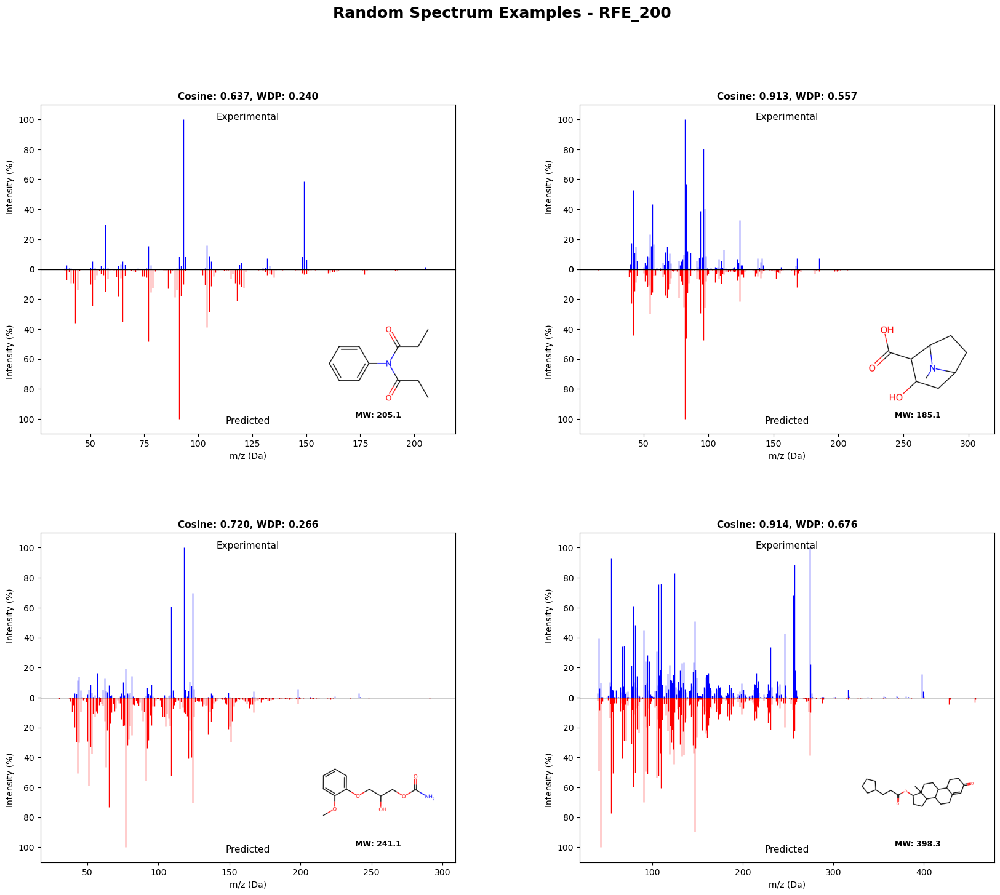

  Running RFE for 500 features...
  RFE_500: 500 features, Cosine Sim = 0.7748, Time = 10.6s

Visualizing RFE_500...


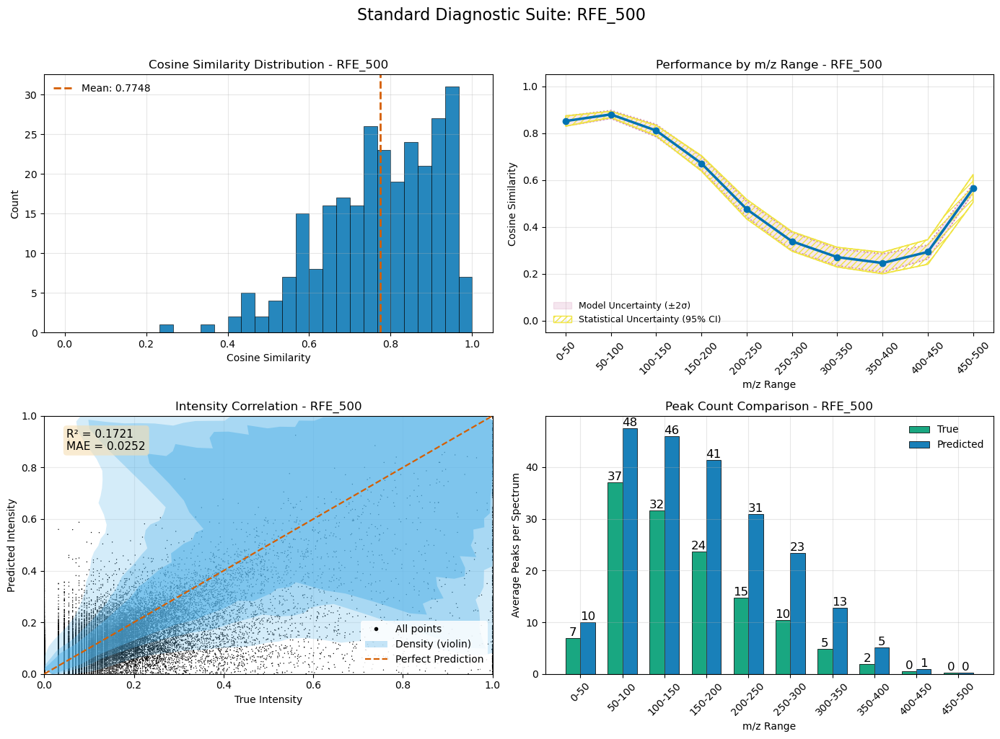


Selected random examples:
  1. Index 77: Cosine=0.7556, WDP=0.4685
  2. Index 15: Cosine=0.7820, WDP=0.4236
  3. Index 49: Cosine=0.5908, WDP=0.1942
  4. Index 71: Cosine=0.7833, WDP=0.2488


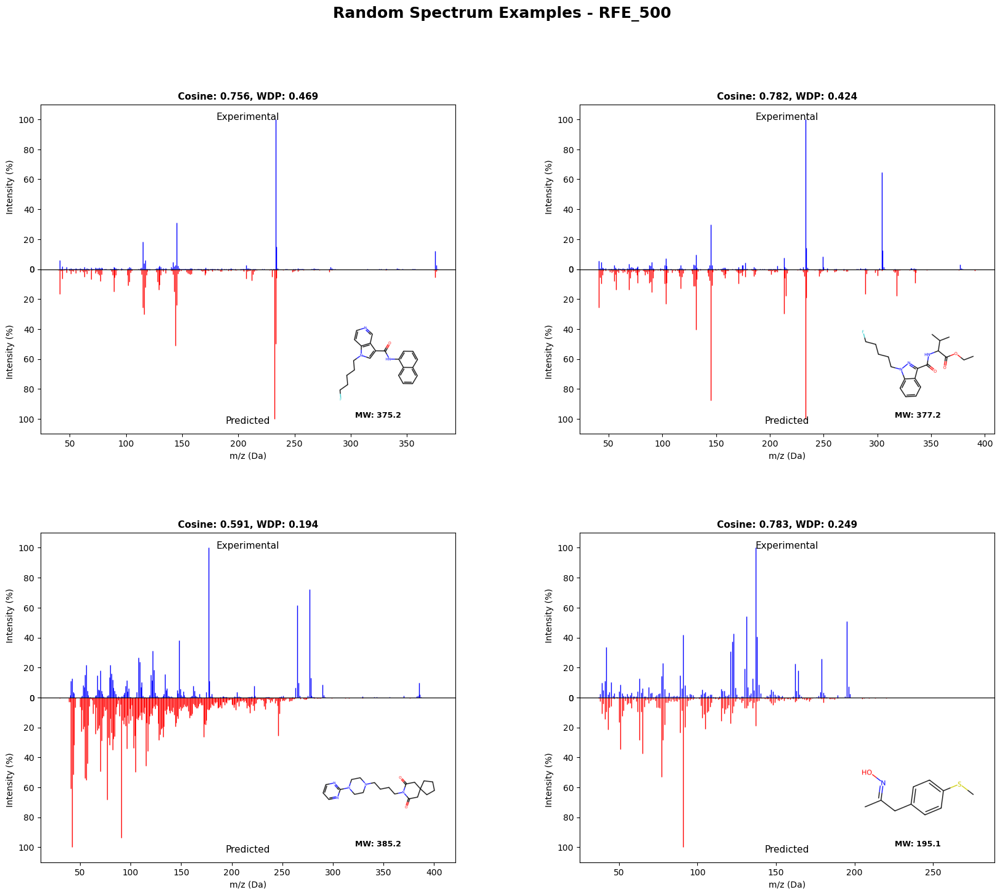

Results saved to ../data/results/selected_features/model_based_selection_results.pkl

Model-based feature selection complete


In [7]:
print("MODEL-BASED FEATURE SELECTION")
print("=" * 60)

model_based_results = {}

# 6.1 Random Forest Feature Importance
print("\n6.1 Random Forest Feature Importance")
print("-" * 40)

# Train RF for feature importance (parallel)
rf_selector = RandomForestRegressor(
    **MASTER_CONFIG['model_based']['rf_importance']
)
rf_selector.fit(X_train_var, y_train)

# Get feature importances
importances = rf_selector.feature_importances_
importance_indices = np.argsort(importances)[::-1]

# Prepare RF importance evaluation tasks
rf_eval_tasks = []
for n_features in MASTER_CONFIG['selection']['target_features']:
    if n_features > X_train_var.shape[1]:
        continue
    
    # Select top n features
    top_indices = importance_indices[:n_features]
    rf_indices = variance_indices[top_indices]
    
    rf_eval_tasks.append({
        'X_train': X_train,
        'y_train': y_train,
        'X_test': X_test,
        'y_test': y_test,
        'features': rf_indices,
        'method': f"RF_Importance_{n_features}"
    })

# Evaluate RF selections in parallel
print("Evaluating RF importance feature subsets in parallel...")
rf_results = parallel_evaluate(rf_eval_tasks)
for result in rf_results:
    model_based_results[result['method']] = result
    # Generate standard plots for each RF importance result
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing {result['method']}...")
        plot_standard_2x2_diagnostic(result, result['method'])
        plot_random_spectrum_grid(result, test_smiles, n_examples=4, model_name=result['method'])

# 6.2 LASSO Feature Selection
print("\n6.2 LASSO Feature Selection")
print("-" * 40)

# Use LassoCV to find optimal alpha (parallel CV)
lasso_cv = LassoCV(
    cv=MASTER_CONFIG['model_based']['lasso']['cv'],
    max_iter=MASTER_CONFIG['model_based']['lasso']['max_iter'],
    random_state=MASTER_CONFIG['model_based']['lasso']['random_state'],
    n_jobs=MASTER_CONFIG['model_based']['lasso']['n_jobs']
)

# Fit on mean spectrum intensity
y_train_mean = y_train.mean(axis=1)
lasso_cv.fit(X_train_var, y_train_mean)

# Get non-zero coefficients
lasso_indices = np.where(lasso_cv.coef_ != 0)[0]
lasso_indices = variance_indices[lasso_indices]

results = evaluate_feature_subset(
    X_train, y_train, X_test, y_test,
    lasso_indices, f"LASSO_{len(lasso_indices)}"
)
model_based_results[f"LASSO_{len(lasso_indices)}"] = results

print(f"\nLASSO selected {len(lasso_indices)} features with alpha={lasso_cv.alpha_:.4f}")

# Generate standard plots for LASSO
if MASTER_CONFIG['evaluation']['show_plots']:
    print(f"\nVisualizing LASSO_{len(lasso_indices)}...")
    plot_standard_2x2_diagnostic(results, f"LASSO_{len(lasso_indices)}")
    plot_random_spectrum_grid(results, test_smiles, n_examples=4, model_name=f"LASSO_{len(lasso_indices)}")

# 6.3 Recursive Feature Elimination (optimized)
print("\n6.3 Recursive Feature Elimination (RFE)")
print("-" * 40)

# Use smaller RF for RFE (faster)
rf_rfe = RandomForestRegressor(
    n_estimators=30,  # Reduced for speed
    max_depth=8,      # Reduced for speed
    n_jobs=-1,        # Use all cores
    random_state=MASTER_CONFIG['general']['random_state']
)

# RFE for selected feature counts
rfe_tasks = []
for n_features in [100, 200, 500]:  # Subset for computational efficiency
    if n_features > X_train_var.shape[1]:
        continue
    
    print(f"  Running RFE for {n_features} features...")
    
    # Use larger step size for faster computation
    step = max(1, int(0.2 * (X_train_var.shape[1] - n_features) / 10))
    
    rfe = RFE(
        estimator=rf_rfe,
        n_features_to_select=n_features,
        step=step,
        verbose=0
    )
    
    # Fit on subset for speed
    subset_size = min(len(X_train_var), 5000)
    indices = np.random.choice(len(X_train_var), subset_size, replace=False)
    
    rfe.fit(X_train_var[indices], y_train[indices])
    rfe_indices = variance_indices[rfe.support_]
    
    # Evaluate
    results = evaluate_feature_subset(
        X_train, y_train, X_test, y_test,
        rfe_indices, f"RFE_{n_features}"
    )
    model_based_results[f"RFE_{n_features}"] = results
    
    # Generate standard plots for RFE
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing RFE_{n_features}...")
        plot_standard_2x2_diagnostic(results, f"RFE_{n_features}")
        plot_random_spectrum_grid(results, test_smiles, n_examples=4, model_name=f"RFE_{n_features}")

# Save model-based results
save_selection_results(model_based_results, "model_based")

print("\nModel-based feature selection complete")

## 7. Domain-Specific Feature Selection

Leverage domain knowledge about molecular fingerprints and mass spectrometry.

### 7.1 Fingerprint Type Analysis

Evaluate different molecular fingerprint types:
- **Morgan (Circular)**: Captures local chemical environments
- **MACCS**: Predefined structural keys
- **RDKit**: Topological fingerprints
- **Descriptors**: Calculated molecular properties

### 7.2 Spectral Range Correlation

Identify features predictive of specific m/z ranges:
- Low m/z (0-200): Small fragments
- Mid m/z (200-350): Medium fragments
- High m/z (350-500): Large fragments/molecular ion

**Parallel Processing**: Fingerprint combinations and spectral correlations are evaluated in parallel.

DOMAIN-SPECIFIC FEATURE SELECTION

7.1 Fingerprint Type Analysis
----------------------------------------

Preparing fingerprint combinations...
Evaluating fingerprint feature subsets in parallel...
  FP_maccs: 152 features, Cosine Sim = 0.7278, Time = 27.5s
  FP_descriptors: 1610 features, Cosine Sim = 0.7596, Time = 64.1s
  FP_rdkit: 1784 features, Cosine Sim = 0.7790, Time = 65.4s
  FP_morgan: 2495 features, Cosine Sim = 0.7743, Time = 120.1s
  FP_morgan_maccs: 2647 features, Cosine Sim = 0.7755, Time = 120.9s
  FP_morgan_descriptors: 4105 features, Cosine Sim = 0.7790, Time = 124.0s
  FP_morgan_maccs_rdkit: 4431 features, Cosine Sim = 0.7773, Time = 125.6s

Visualizing FP_maccs...


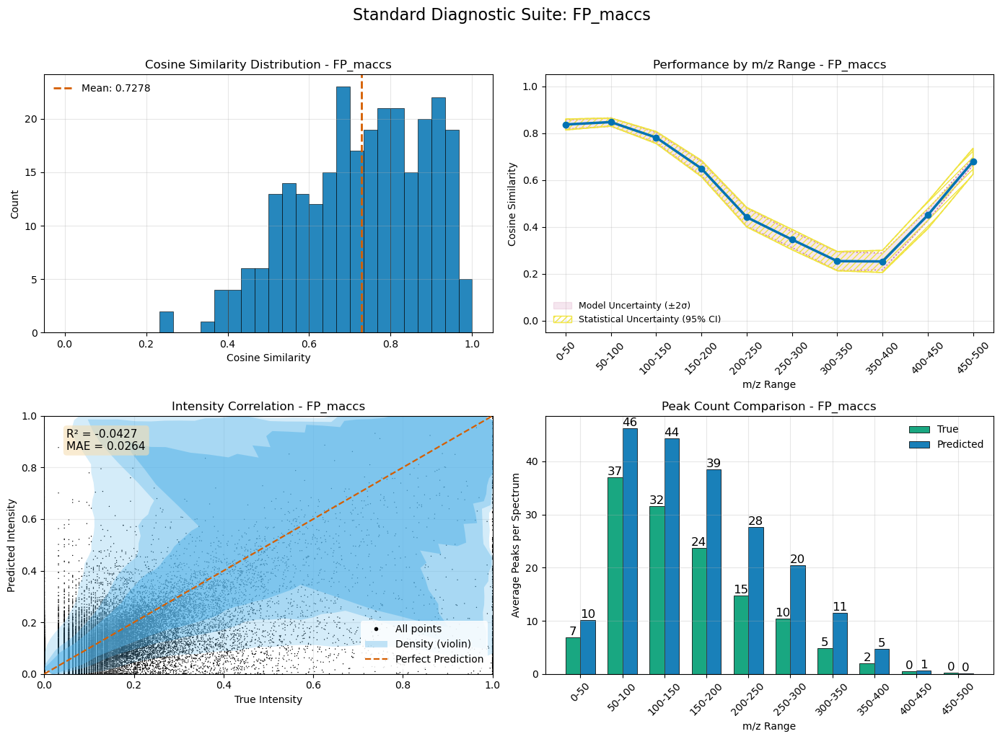


Selected random examples:
  1. Index 256: Cosine=0.8636, WDP=0.5735
  2. Index 197: Cosine=0.8595, WDP=0.6835
  3. Index 57: Cosine=0.6123, WDP=0.2298
  4. Index 40: Cosine=0.8640, WDP=0.6126


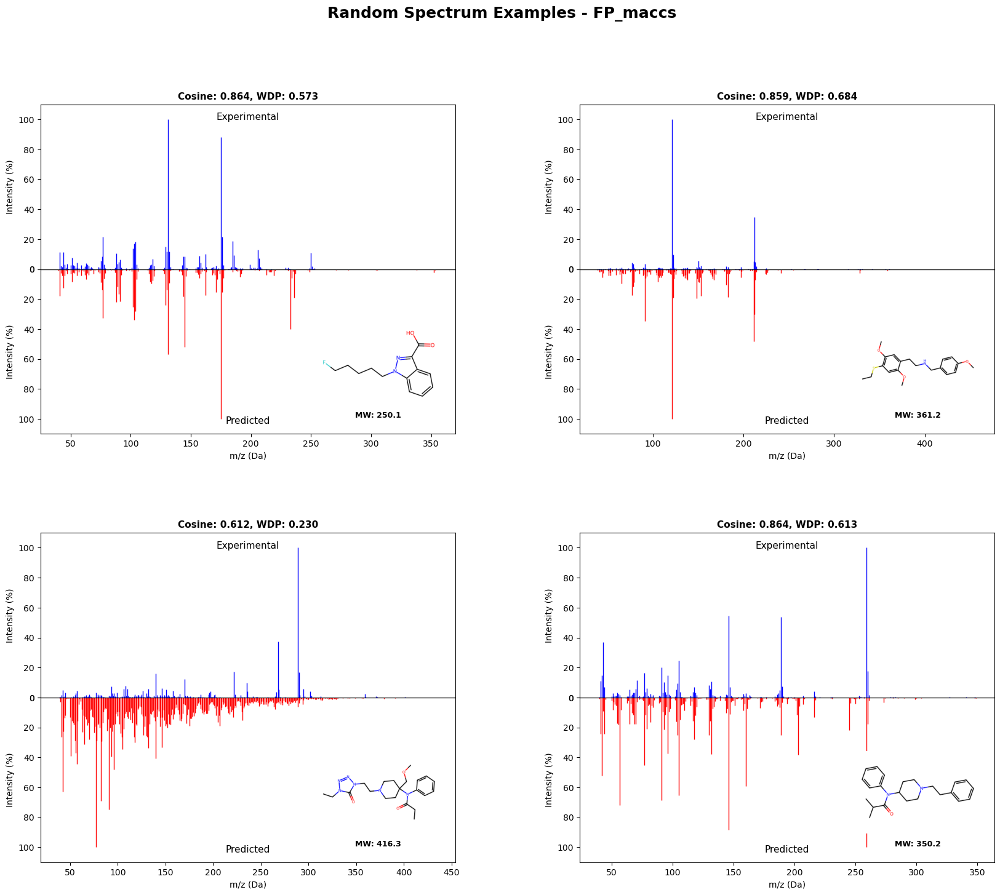


Visualizing FP_descriptors...


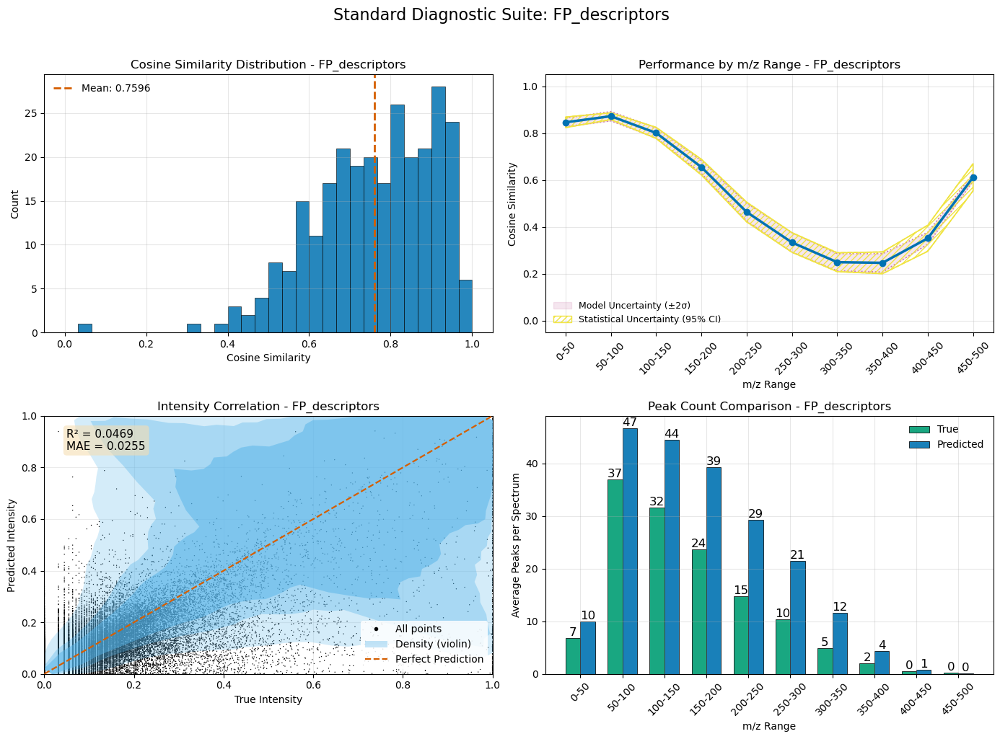


Selected random examples:
  1. Index 229: Cosine=0.5855, WDP=0.2495
  2. Index 65: Cosine=0.6580, WDP=0.2146
  3. Index 152: Cosine=0.8554, WDP=0.6227
  4. Index 95: Cosine=0.7295, WDP=0.4372


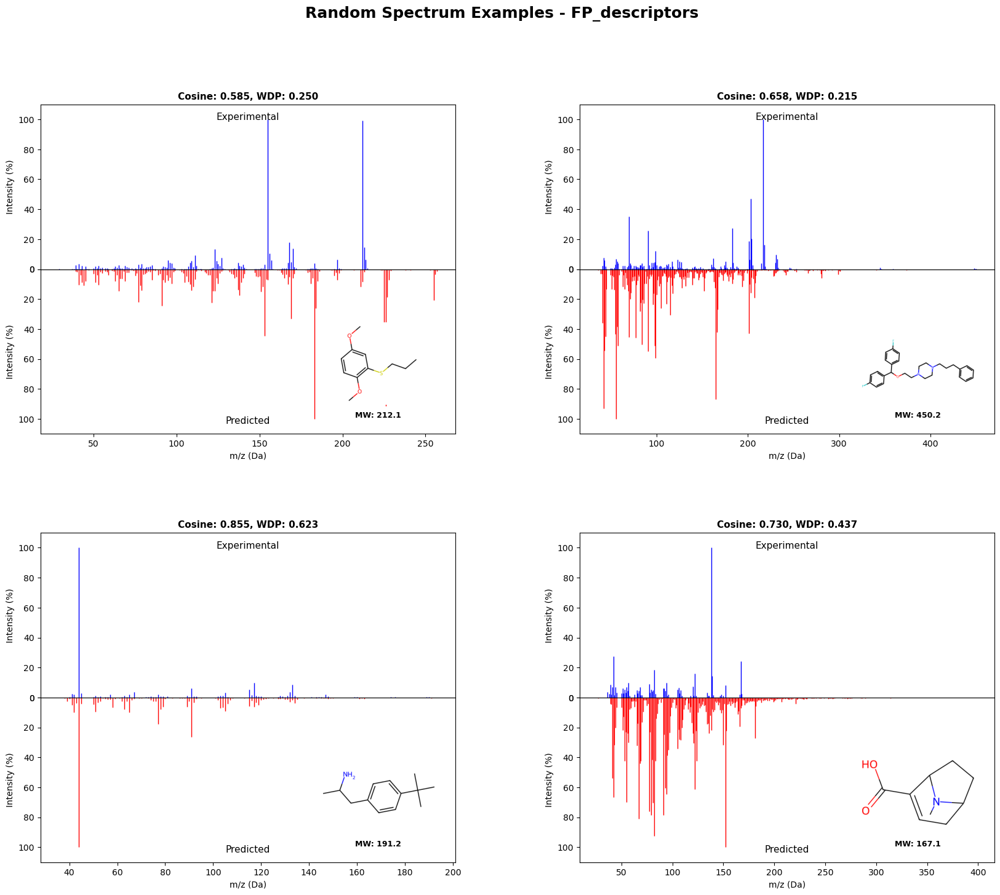


Visualizing FP_rdkit...


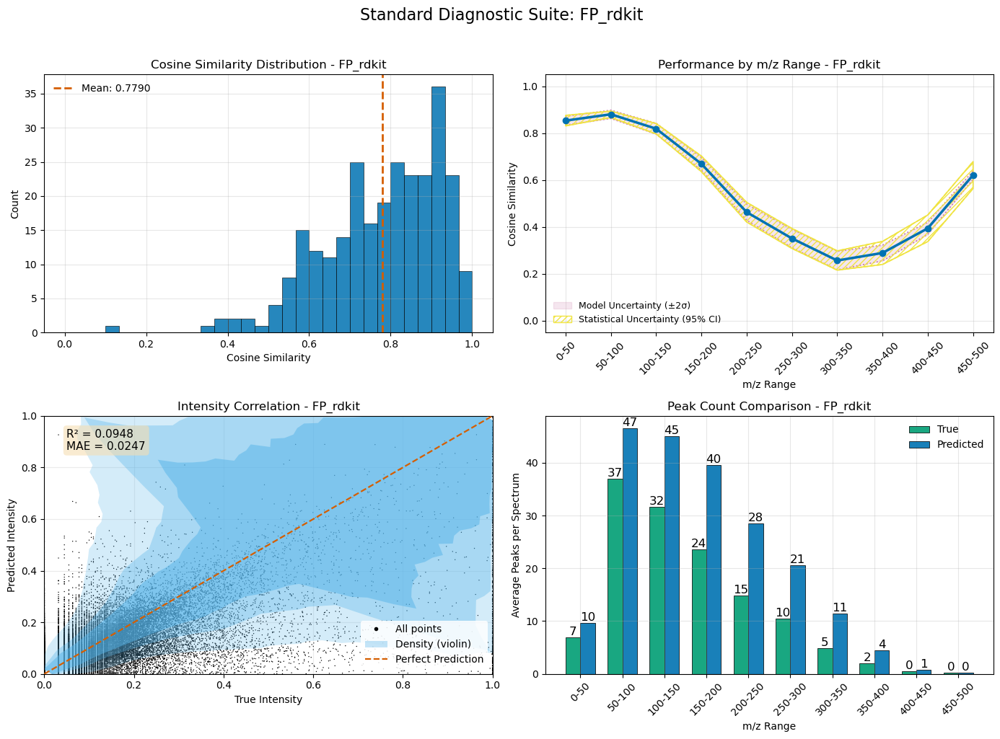


Selected random examples:
  1. Index 81: Cosine=0.3549, WDP=0.2598
  2. Index 271: Cosine=0.9596, WDP=0.7603
  3. Index 78: Cosine=0.8664, WDP=0.7712
  4. Index 24: Cosine=0.7331, WDP=0.4771


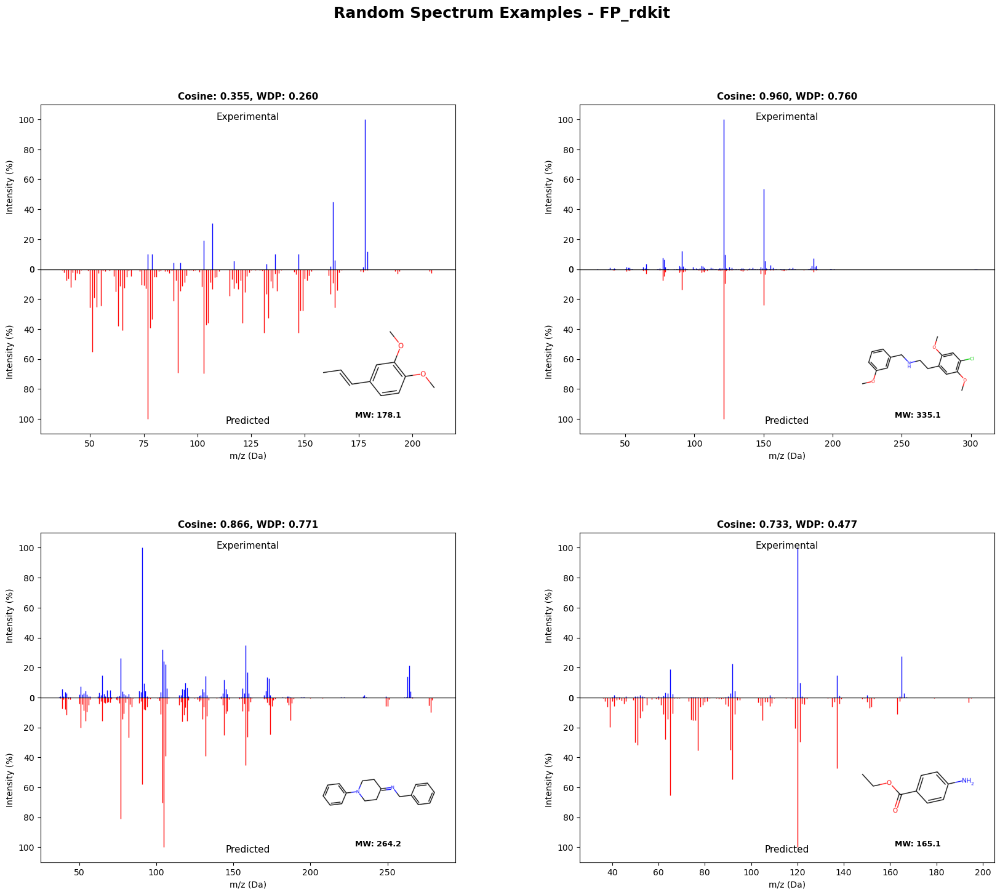


Visualizing FP_morgan...


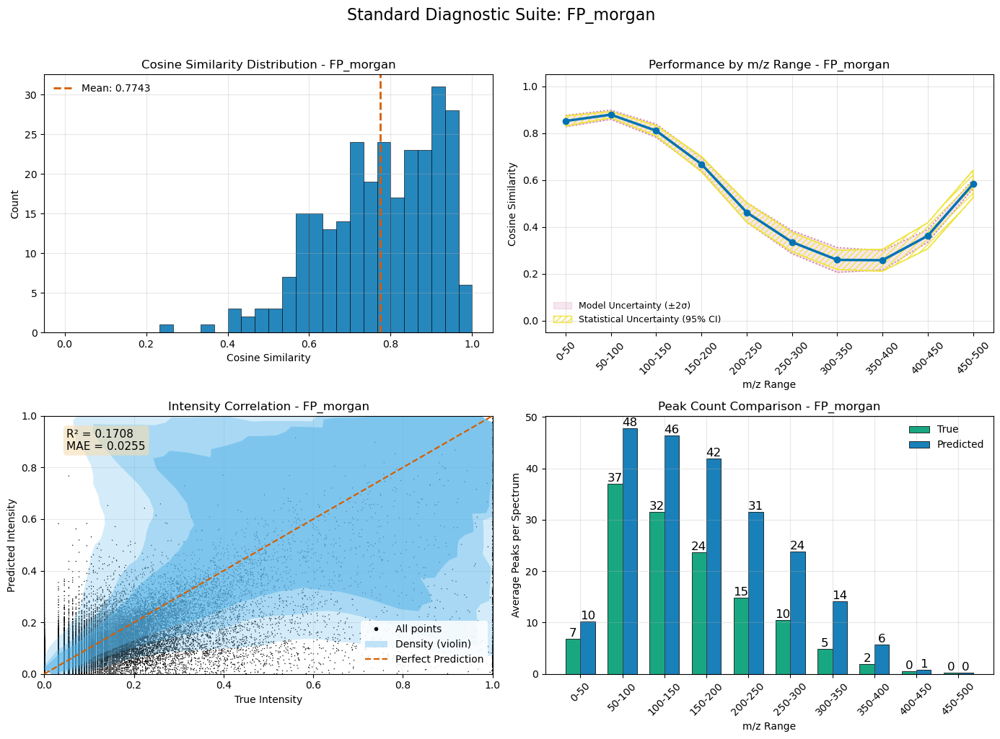


Selected random examples:
  1. Index 219: Cosine=0.9211, WDP=0.7801
  2. Index 5: Cosine=0.9197, WDP=0.7065
  3. Index 147: Cosine=0.9391, WDP=0.6246
  4. Index 198: Cosine=0.8371, WDP=0.7271


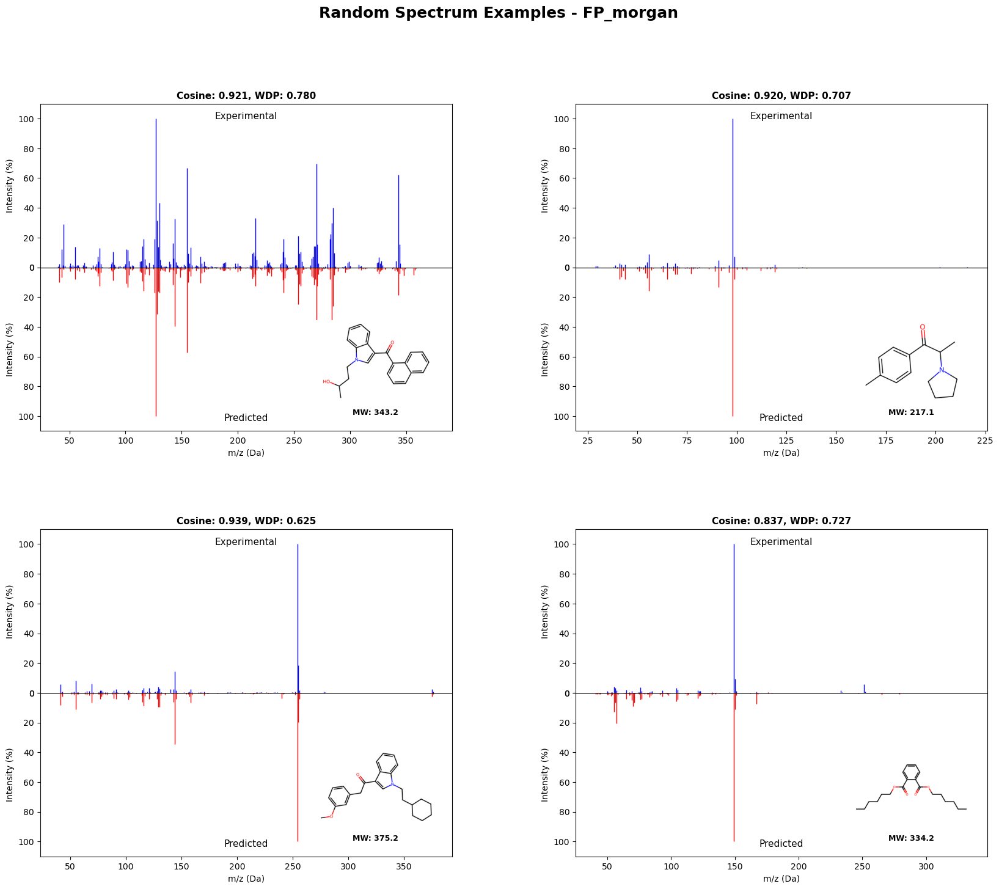


Visualizing FP_morgan_maccs...


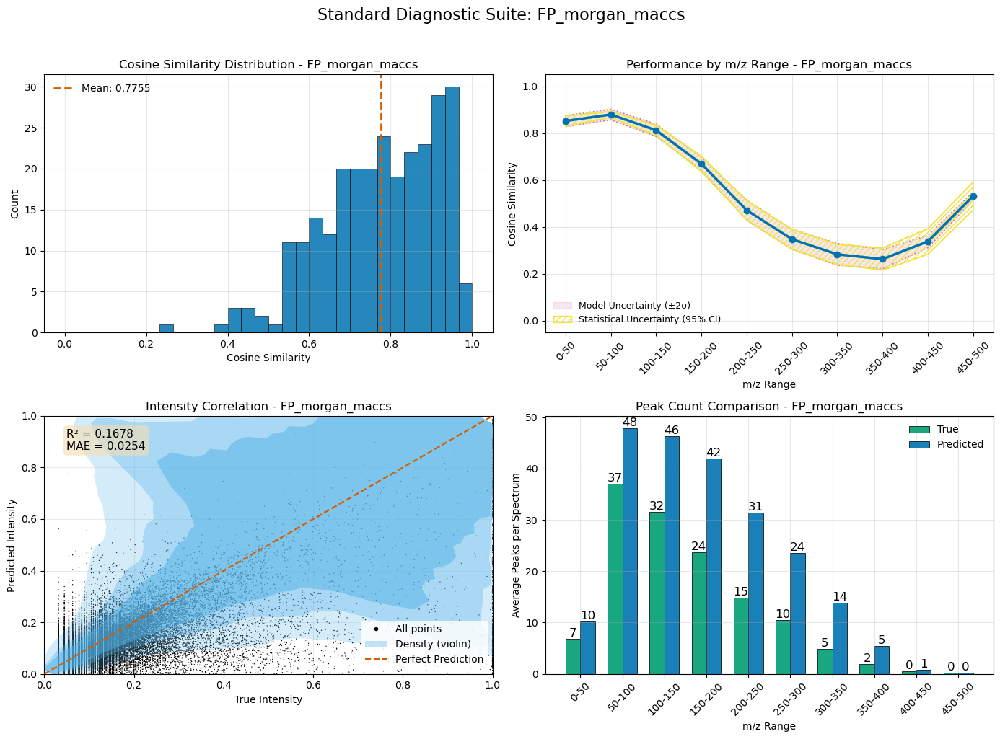


Selected random examples:
  1. Index 23: Cosine=0.9134, WDP=0.8506
  2. Index 230: Cosine=0.5799, WDP=0.2306
  3. Index 138: Cosine=0.6454, WDP=0.1885
  4. Index 259: Cosine=0.8372, WDP=0.5554


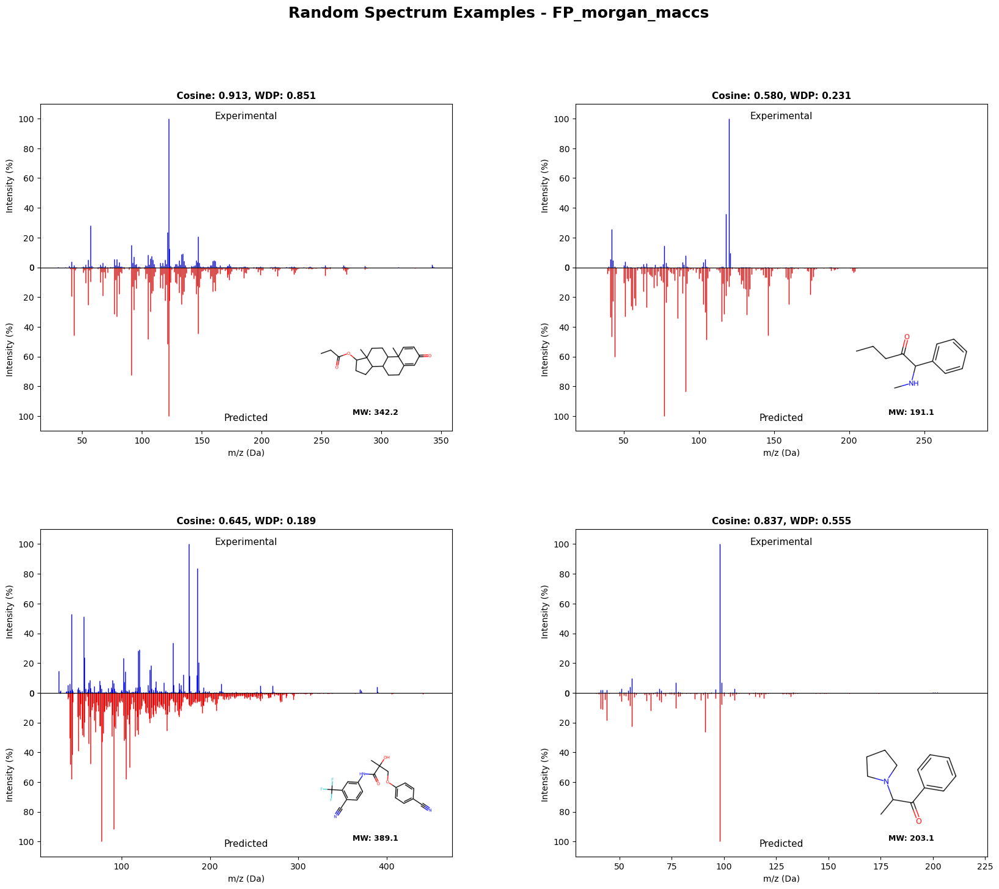


Visualizing FP_morgan_descriptors...


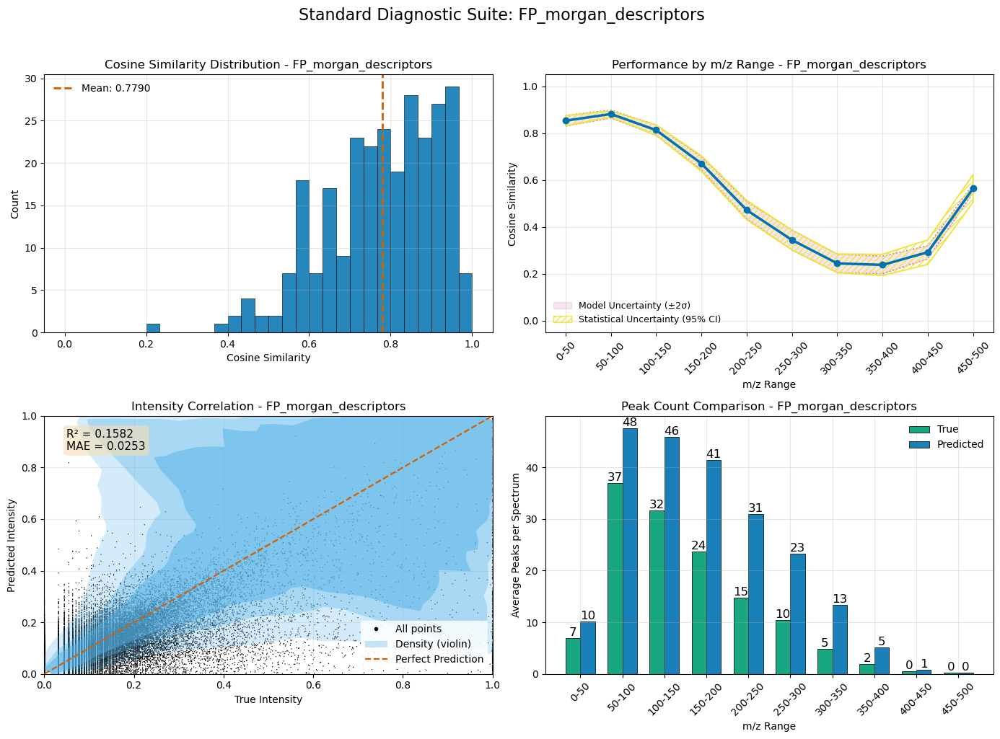


Selected random examples:
  1. Index 265: Cosine=0.6123, WDP=0.3300
  2. Index 187: Cosine=0.8441, WDP=0.5855
  3. Index 157: Cosine=0.4600, WDP=0.2277
  4. Index 47: Cosine=0.7838, WDP=0.3170


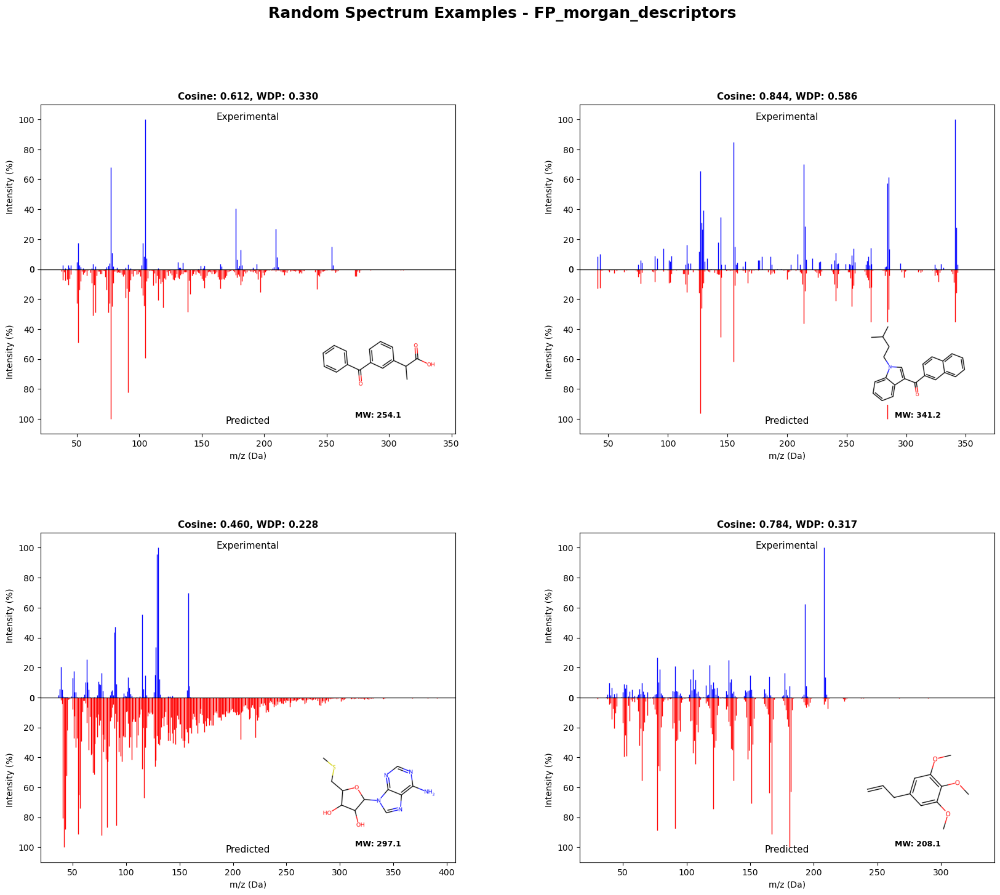


Visualizing FP_morgan_maccs_rdkit...


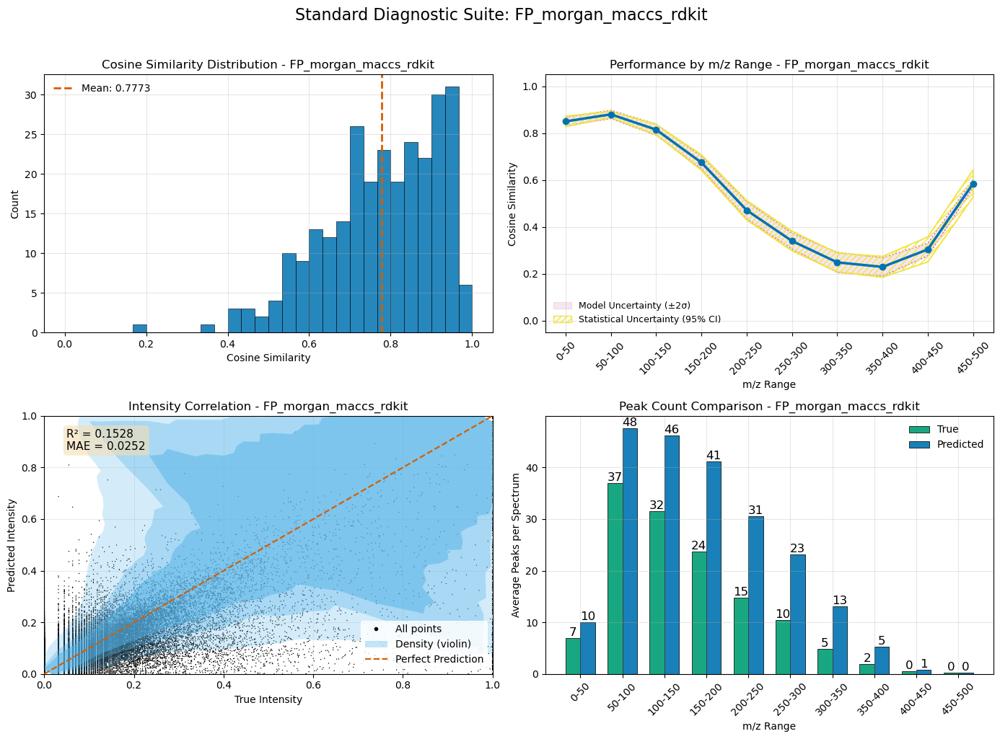


Selected random examples:
  1. Index 198: Cosine=0.8615, WDP=0.7328
  2. Index 114: Cosine=0.6767, WDP=0.3073
  3. Index 2: Cosine=0.8635, WDP=0.5478
  4. Index 229: Cosine=0.6930, WDP=0.2298


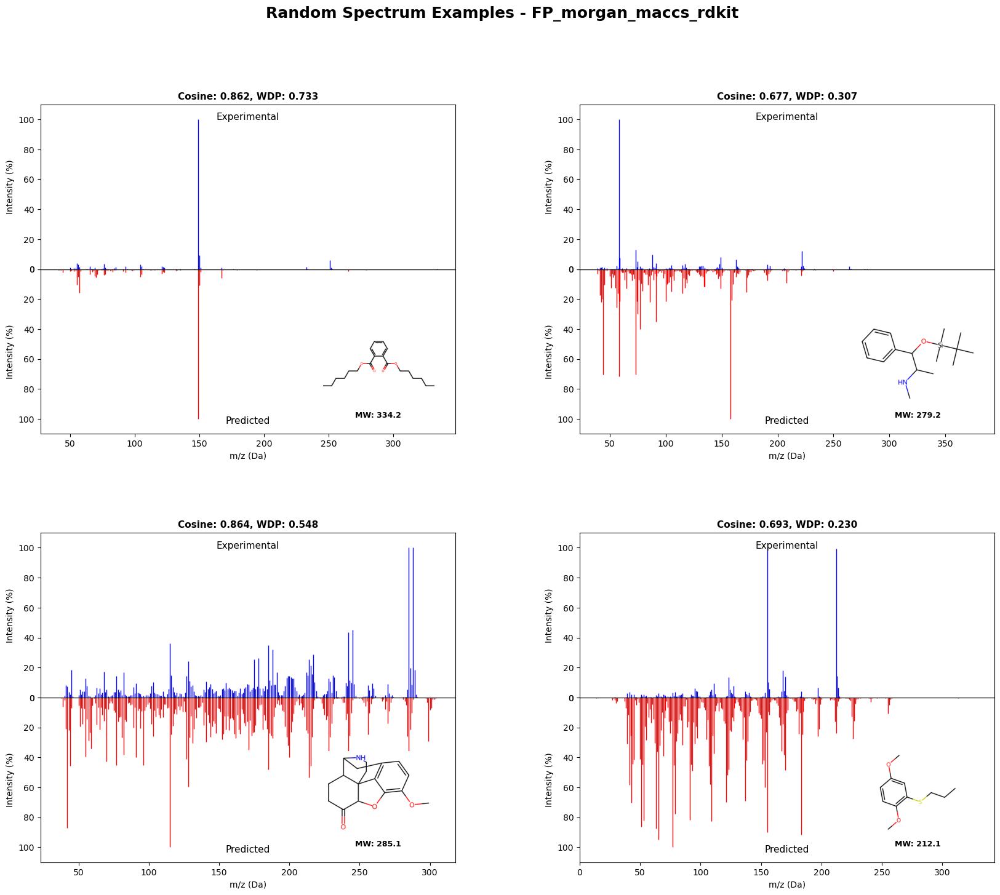


7.2 Spectral Range-Specific Feature Selection
----------------------------------------
Computing spectral range correlations in parallel...
Evaluating spectral range feature subsets in parallel...
  MZ_low_corr: 200 features, Cosine Sim = 0.7307, Time = 7.5s
  MZ_high_corr: 200 features, Cosine Sim = 0.7441, Time = 9.3s
  MZ_mid_corr: 200 features, Cosine Sim = 0.7357, Time = 10.9s

Visualizing MZ_low_corr...


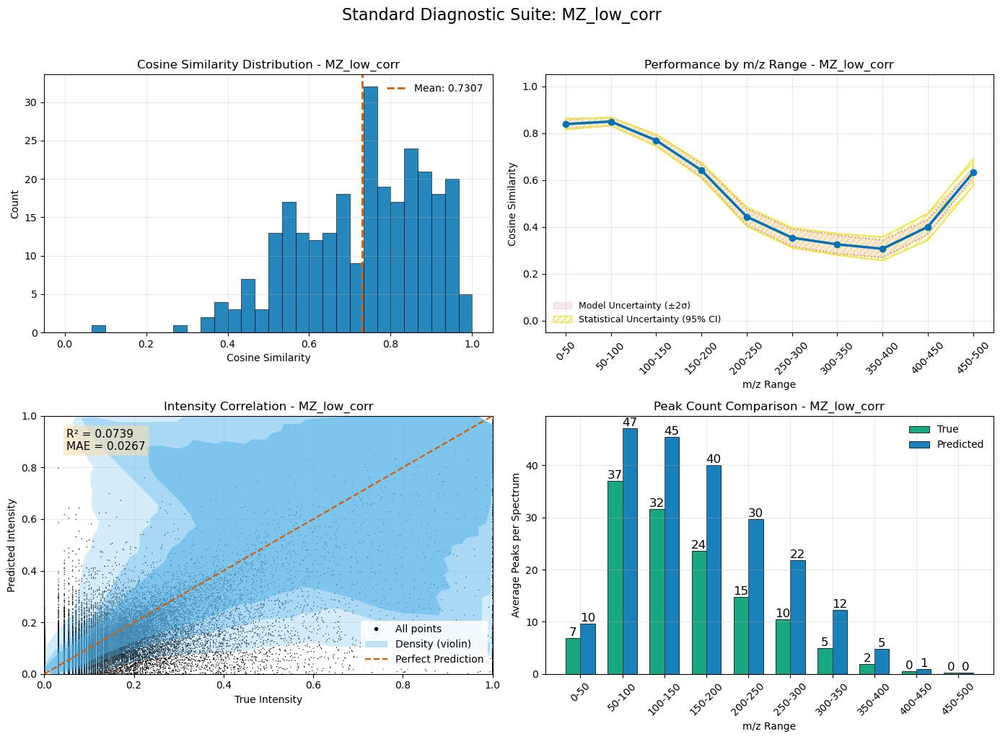


Selected random examples:
  1. Index 60: Cosine=0.5847, WDP=0.2100
  2. Index 183: Cosine=0.7744, WDP=0.4473
  3. Index 205: Cosine=0.6181, WDP=0.1934
  4. Index 213: Cosine=0.8404, WDP=0.4592


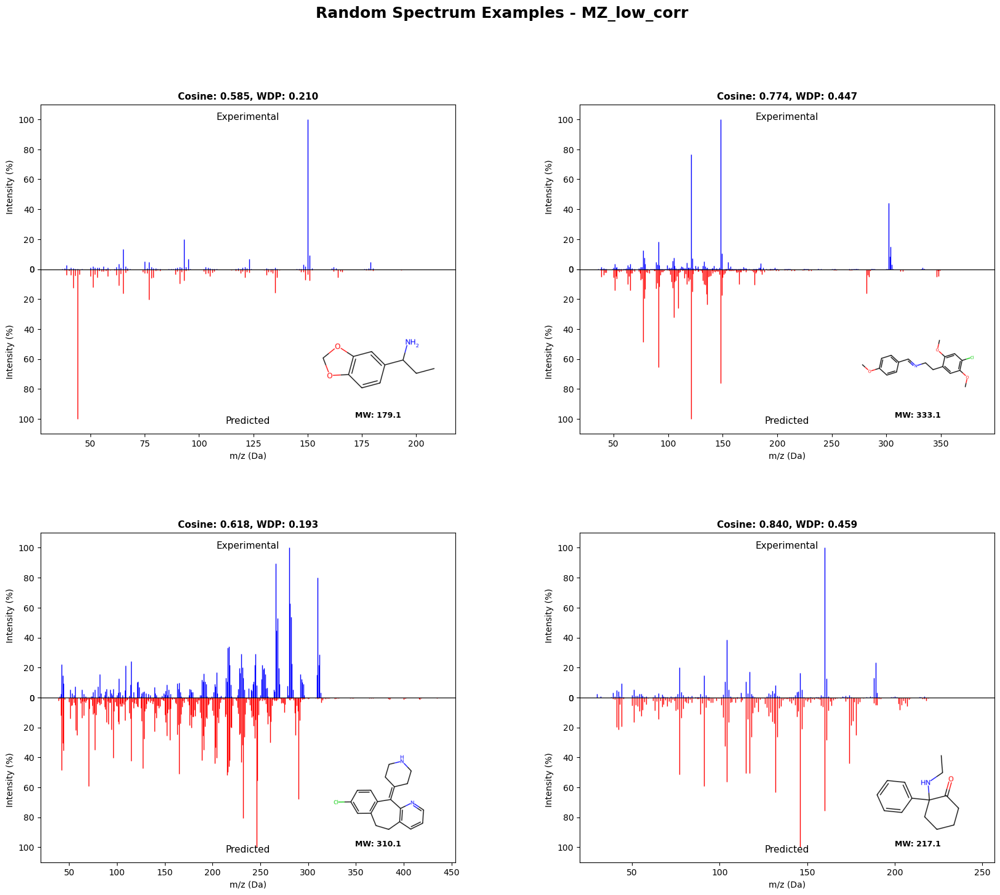


Visualizing MZ_high_corr...


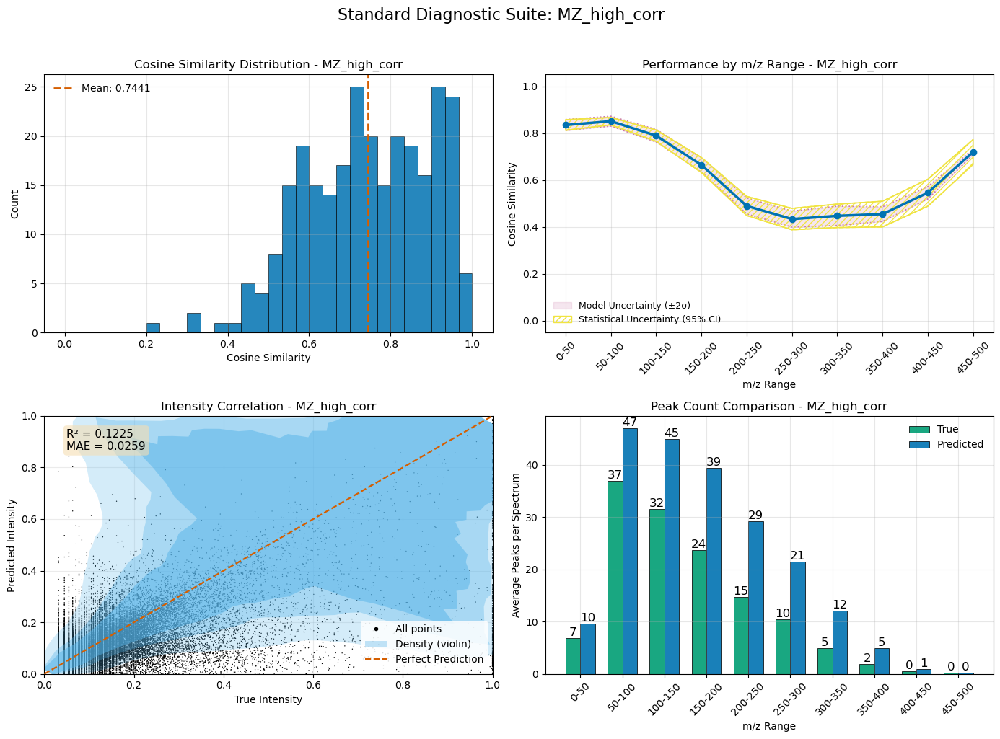


Selected random examples:
  1. Index 2: Cosine=0.8677, WDP=0.5660
  2. Index 58: Cosine=0.8717, WDP=0.7229
  3. Index 205: Cosine=0.7321, WDP=0.3165
  4. Index 164: Cosine=0.5314, WDP=0.1667


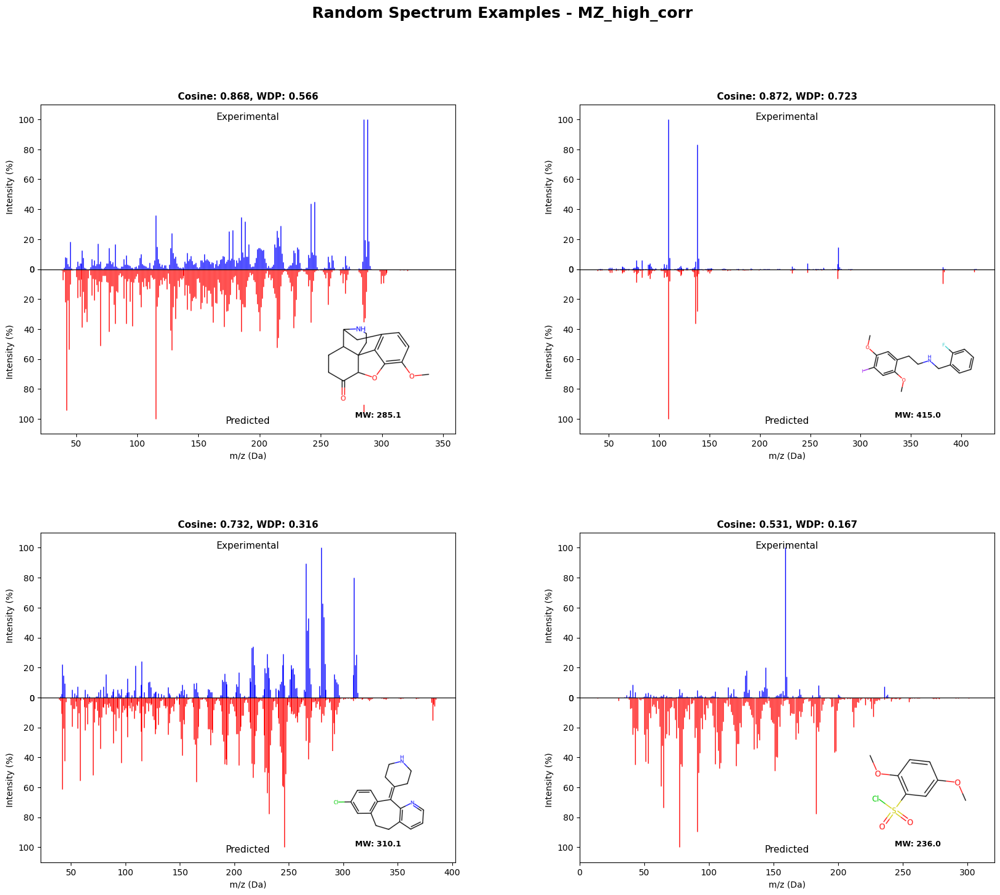


Visualizing MZ_mid_corr...


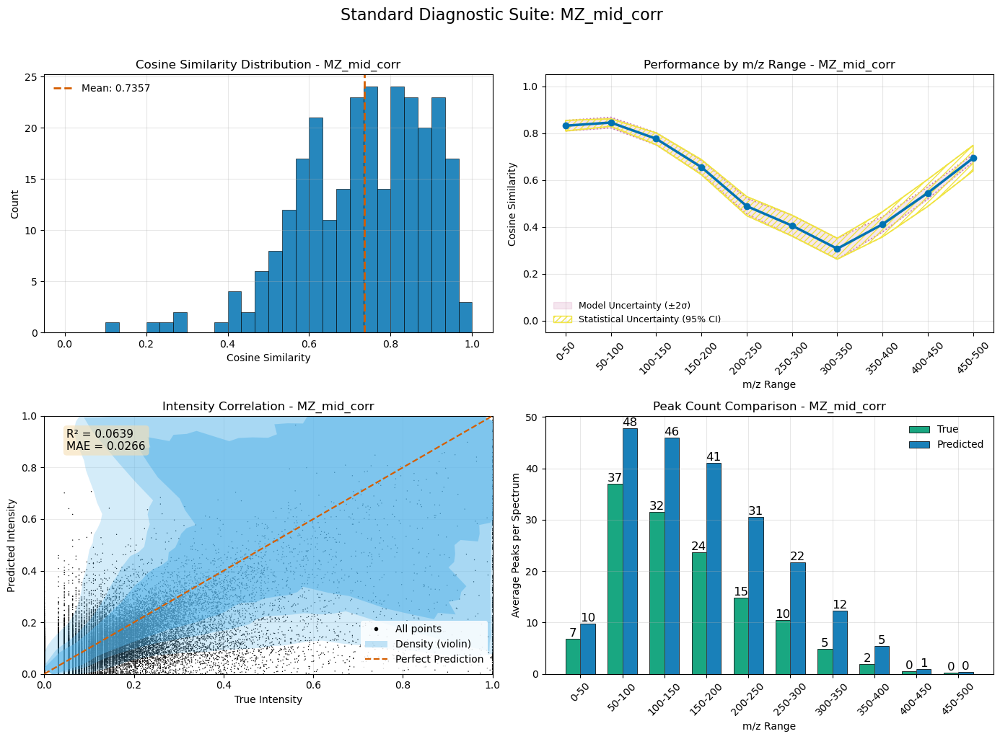


Selected random examples:
  1. Index 211: Cosine=0.8686, WDP=0.4783
  2. Index 239: Cosine=0.6475, WDP=0.2346
  3. Index 115: Cosine=0.8589, WDP=0.5200
  4. Index 134: Cosine=0.5001, WDP=0.2705


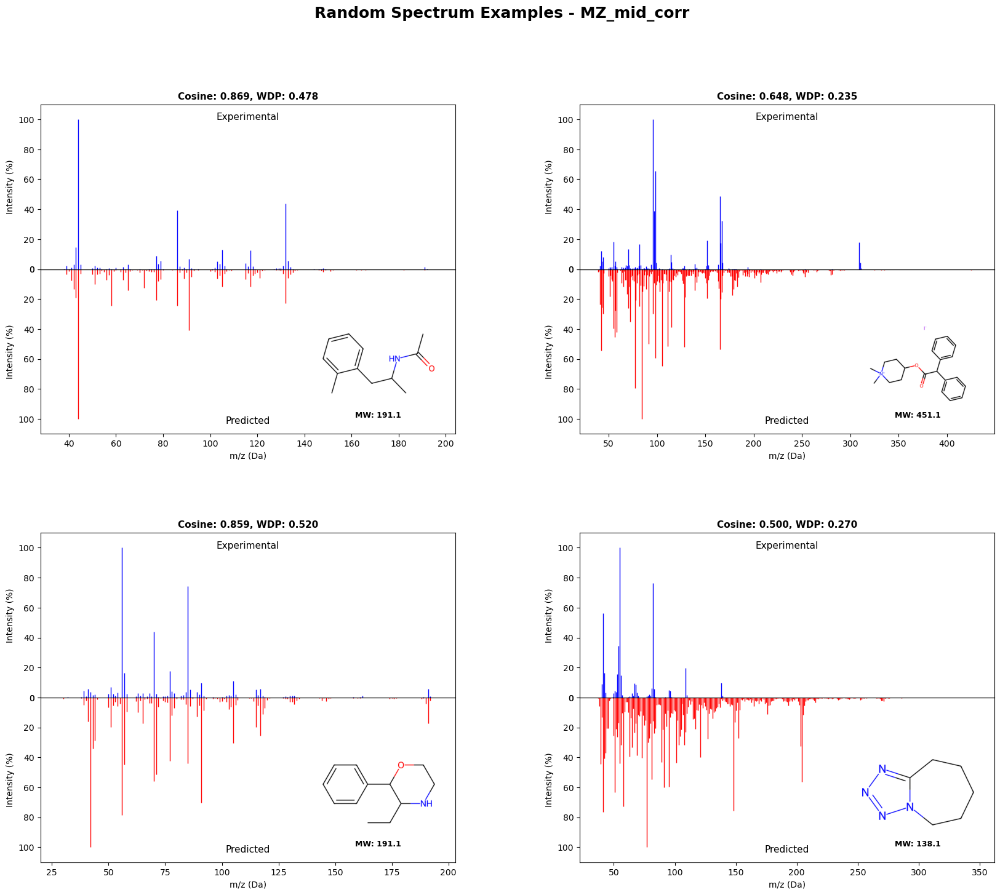

Results saved to ../data/results/selected_features/domain_specific_selection_results.pkl

Domain-specific feature selection complete


In [8]:
print("DOMAIN-SPECIFIC FEATURE SELECTION")
print("=" * 60)

domain_results = {}

# 7.1 Fingerprint Type Analysis
print("\n7.1 Fingerprint Type Analysis")
print("-" * 40)

# Prepare fingerprint evaluation tasks
fp_eval_tasks = []

# Test individual fingerprint types
for fp_type, (start, end) in MASTER_CONFIG['domain']['fingerprint_ranges'].items():
    # Get indices for this fingerprint type
    fp_indices = [i for i in variance_indices if start <= i < end]
    
    if len(fp_indices) > 0:
        fp_eval_tasks.append({
            'X_train': X_train,
            'y_train': y_train,
            'X_test': X_test,
            'y_test': y_test,
            'features': np.array(fp_indices),
            'method': f"FP_{fp_type}"
        })

# Test fingerprint combinations
print("\nPreparing fingerprint combinations...")
combinations = [
    ['morgan', 'maccs'],
    ['morgan', 'descriptors'],
    ['morgan', 'maccs', 'rdkit']
]

for combo in combinations:
    combo_indices = []
    for fp_type in combo:
        start, end = MASTER_CONFIG['domain']['fingerprint_ranges'][fp_type]
        combo_indices.extend([i for i in variance_indices if start <= i < end])
    
    if len(combo_indices) > 0:
        fp_eval_tasks.append({
            'X_train': X_train,
            'y_train': y_train,
            'X_test': X_test,
            'y_test': y_test,
            'features': np.array(combo_indices),
            'method': f"FP_{'_'.join(combo)}"
        })

# Evaluate fingerprint selections in parallel
print("Evaluating fingerprint feature subsets in parallel...")
fp_results = parallel_evaluate(fp_eval_tasks)
for result in fp_results:
    domain_results[result['method']] = result
    # Generate standard plots for each fingerprint result
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing {result['method']}...")
        plot_standard_2x2_diagnostic(result, result['method'])
        plot_random_spectrum_grid(result, test_smiles, n_examples=4, model_name=result['method'])

# 7.2 Spectral Range Correlation (Parallel)
print("\n7.2 Spectral Range-Specific Feature Selection")
print("-" * 40)

def compute_range_correlations(mz_range, start_mz, end_mz, X_train_var, y_train, variance_indices):
    """Compute correlations for a specific m/z range."""
    # Use subset of spectrum as target
    y_subset = y_train[:, start_mz:end_mz].mean(axis=1)
    
    # Vectorized correlation computation
    correlations = np.abs([
        np.corrcoef(X_train_var[:, i], y_subset)[0, 1] 
        for i in range(X_train_var.shape[1])
    ])
    
    # Handle NaN values
    correlations = np.nan_to_num(correlations, 0)
    
    # Select top 200 features
    n_select = min(200, len(correlations))
    top_corr_indices = np.argsort(correlations)[::-1][:n_select]
    range_indices = variance_indices[top_corr_indices]
    
    return mz_range, range_indices

# Compute correlations in parallel
print("Computing spectral range correlations in parallel...")
range_tasks = []

with ThreadPoolExecutor(max_workers=MASTER_CONFIG['general']['n_jobs']) as executor:
    futures = []
    
    for mz_range, (start_mz, end_mz) in MASTER_CONFIG['domain']['mz_ranges'].items():
        future = executor.submit(
            compute_range_correlations,
            mz_range, start_mz, end_mz, X_train_var, y_train, variance_indices
        )
        futures.append(future)
    
    # Collect results
    for future in as_completed(futures):
        mz_range, range_indices = future.result()
        range_tasks.append({
            'X_train': X_train,
            'y_train': y_train,
            'X_test': X_test,
            'y_test': y_test,
            'features': range_indices,
            'method': f"MZ_{mz_range}_corr"
        })

# Evaluate spectral range selections in parallel
print("Evaluating spectral range feature subsets in parallel...")
range_results = parallel_evaluate(range_tasks)
for result in range_results:
    domain_results[result['method']] = result
    # Generate standard plots for each spectral range result
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing {result['method']}...")
        plot_standard_2x2_diagnostic(result, result['method'])
        plot_random_spectrum_grid(result, test_smiles, n_examples=4, model_name=result['method'])

# Save domain-specific results
save_selection_results(domain_results, "domain_specific")

print("\nDomain-specific feature selection complete")

## 8. Ensemble Feature Selection

Combine multiple feature selection methods for robust feature identification.

### 8.1 Voting-based Selection

Features selected by multiple methods are likely to be robust:
- Count how many methods select each feature
- Select features appearing in multiple method results

### 8.2 Stability Analysis

Bootstrap sampling to assess selection stability:

$$\text{Stability} = \frac{1}{\binom{k}{2}} \sum_{i<j} \frac{|S_i \cap S_j|}{|S_i \cup S_j|}$$

Where $S_i$ and $S_j$ are feature sets from different bootstrap samples.

**Parallel Processing**: Bootstrap iterations are computed in parallel for efficiency.

ENSEMBLE FEATURE SELECTION

8.1 Voting-based Feature Selection
----------------------------------------
Evaluating voting-based feature subsets in parallel...
  Voting_5+: 3254 features, Cosine Sim = 0.7791, Time = 85.8s
  Voting_3+: 5879 features, Cosine Sim = 0.7799, Time = 96.2s
  Voting_2+: 6042 features, Cosine Sim = 0.7805, Time = 97.7s

Visualizing Voting_5+...


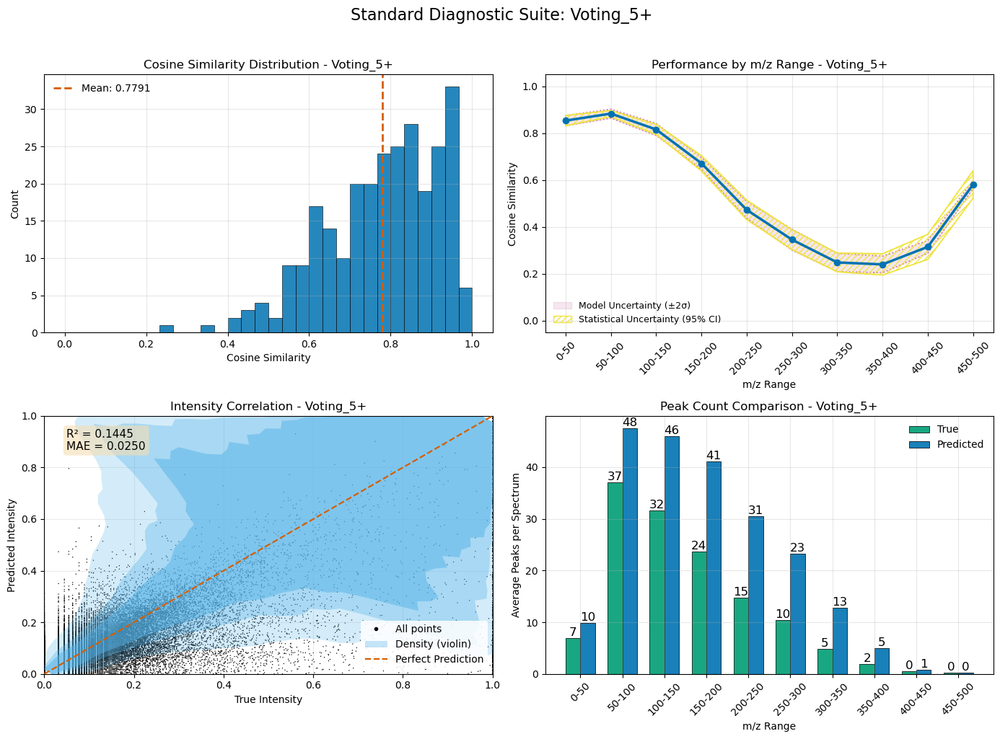


Selected random examples:
  1. Index 223: Cosine=0.7981, WDP=0.5457
  2. Index 209: Cosine=0.8719, WDP=0.5187
  3. Index 112: Cosine=0.8122, WDP=0.7369
  4. Index 206: Cosine=0.8799, WDP=0.7500


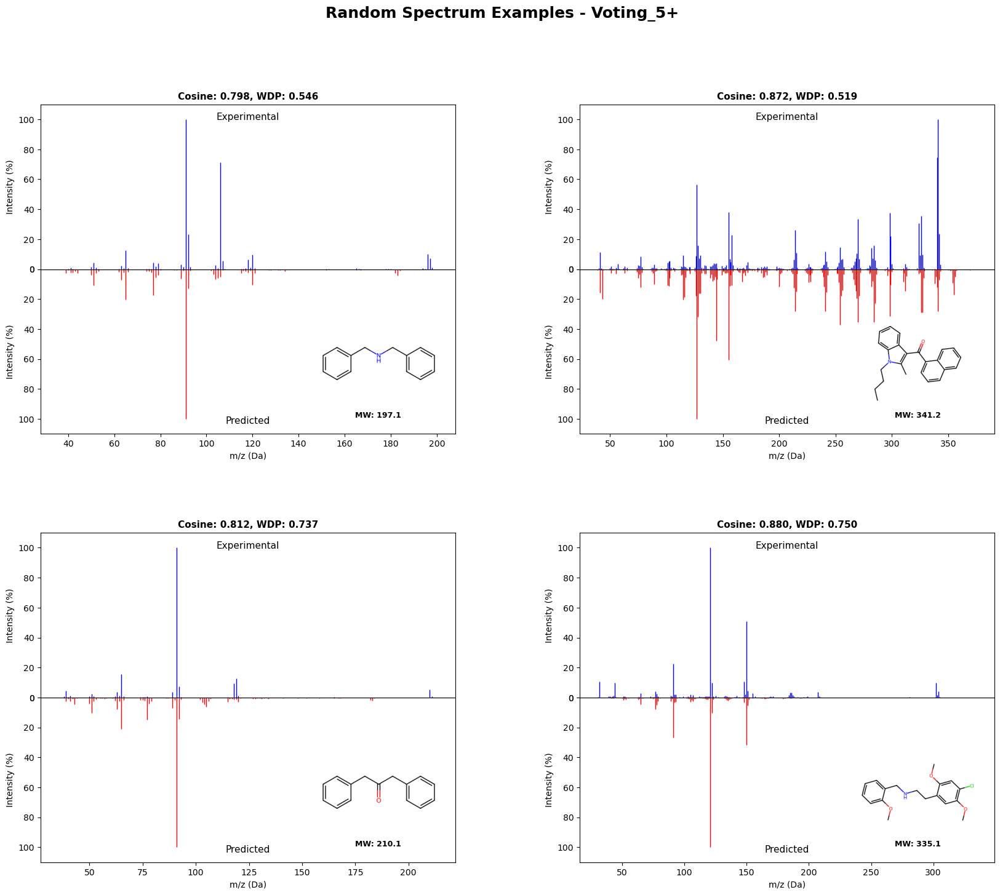


Visualizing Voting_3+...


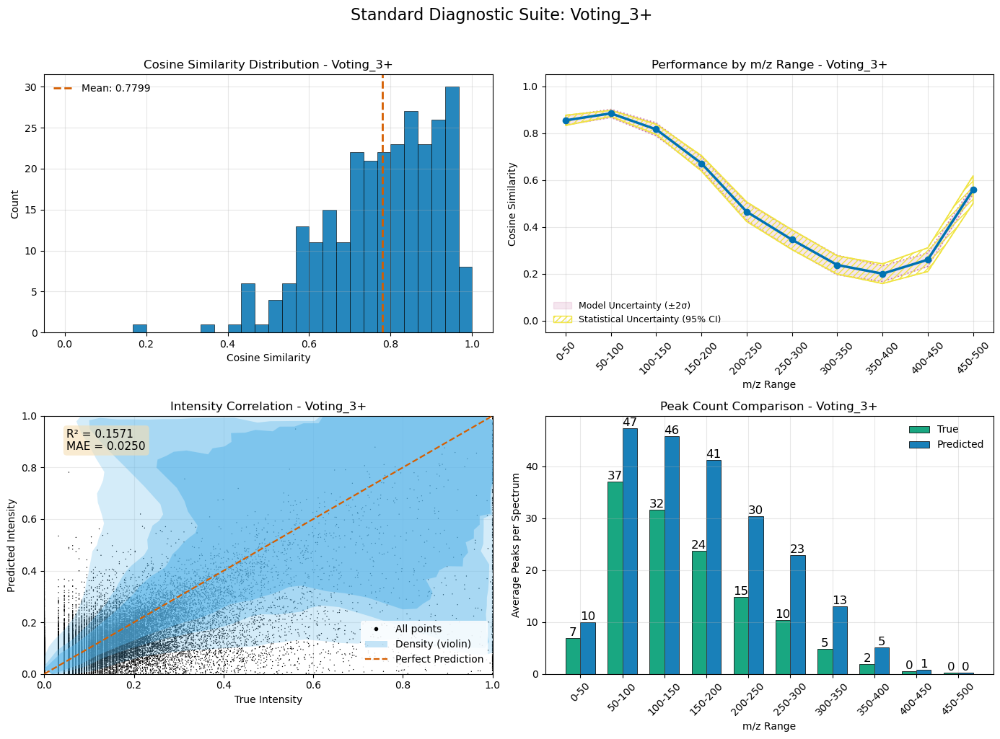


Selected random examples:
  1. Index 140: Cosine=0.6134, WDP=0.3143
  2. Index 261: Cosine=0.9778, WDP=0.6587
  3. Index 26: Cosine=0.6634, WDP=0.3036
  4. Index 225: Cosine=0.9295, WDP=0.7248


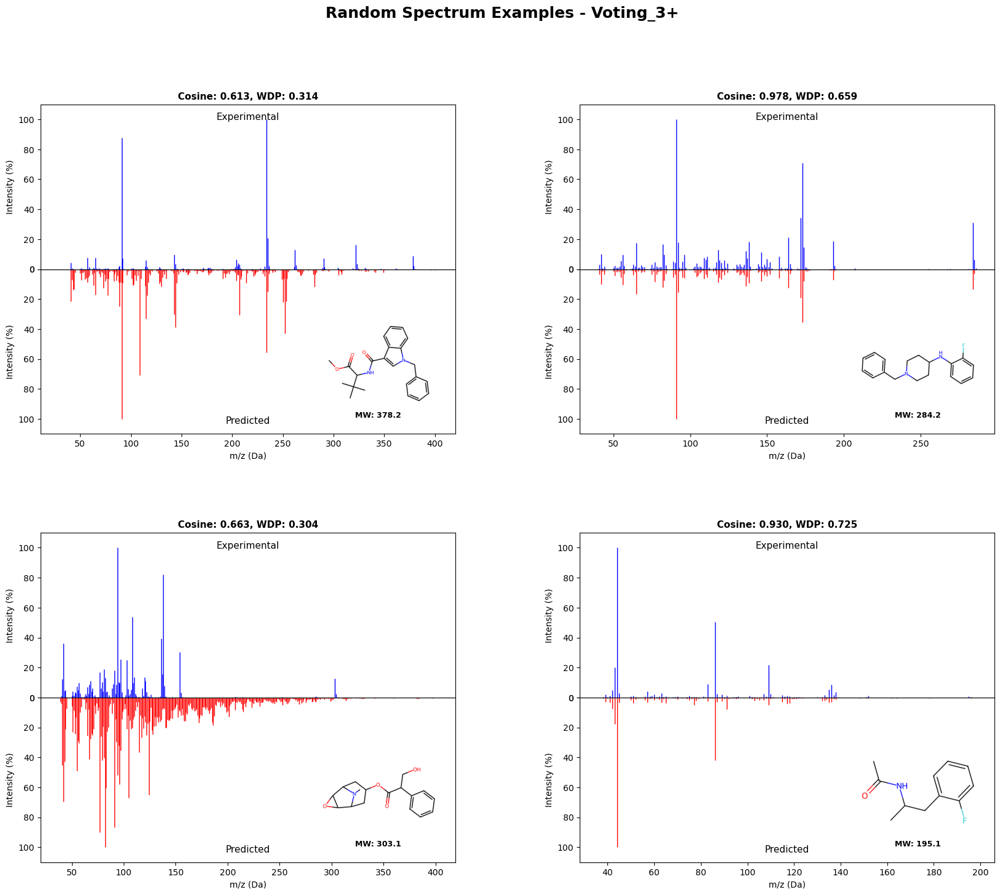


Visualizing Voting_2+...


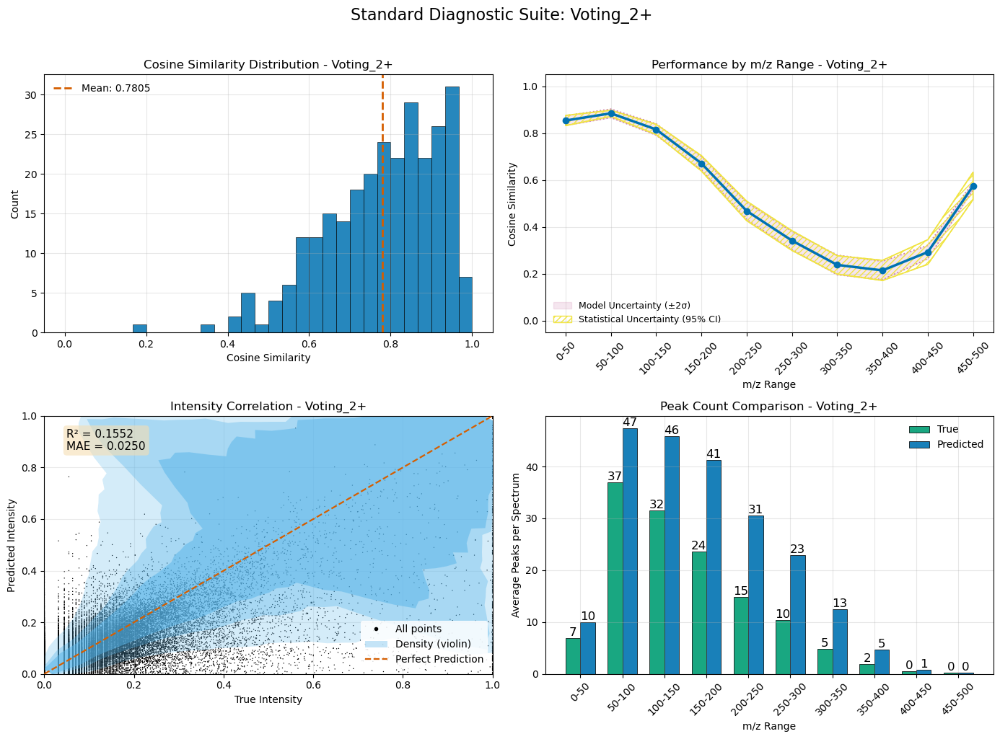


Selected random examples:
  1. Index 57: Cosine=0.6395, WDP=0.2684
  2. Index 118: Cosine=0.5783, WDP=0.2481
  3. Index 98: Cosine=0.8581, WDP=0.4475
  4. Index 198: Cosine=0.7875, WDP=0.6118


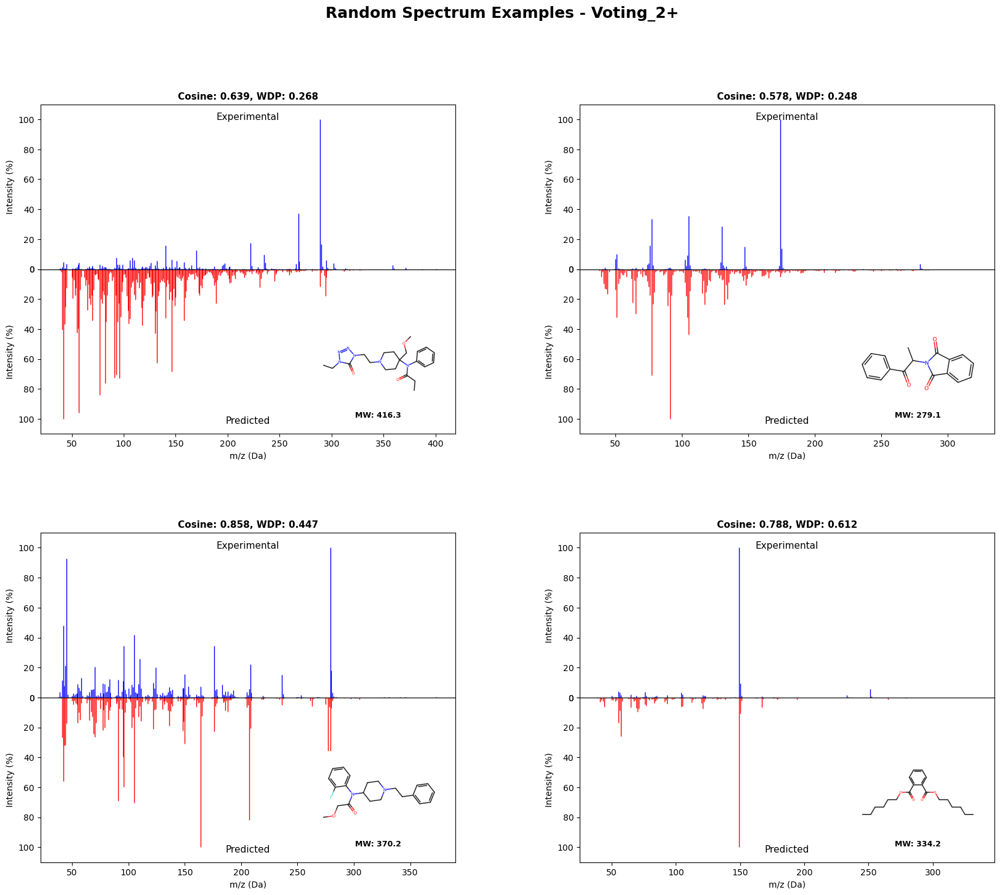


8.2 Feature Selection Stability Analysis
----------------------------------------

Analyzing stability of MI selection (parallel bootstrap)...
  MI stability (Jaccard): 0.7610
  Stable_MI: 164 features, Cosine Sim = 0.7598, Time = 8.2s

Visualizing Stable_MI...


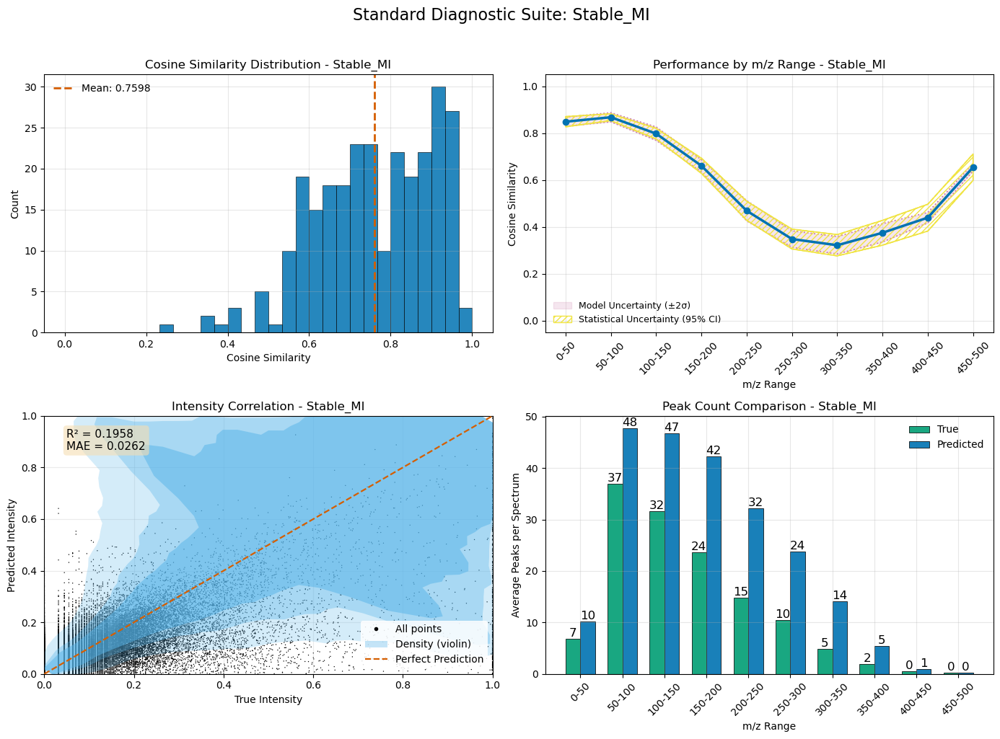


Selected random examples:
  1. Index 125: Cosine=0.6209, WDP=0.1409
  2. Index 238: Cosine=0.3931, WDP=0.1172
  3. Index 231: Cosine=0.6846, WDP=0.3499
  4. Index 1: Cosine=0.6373, WDP=0.1933


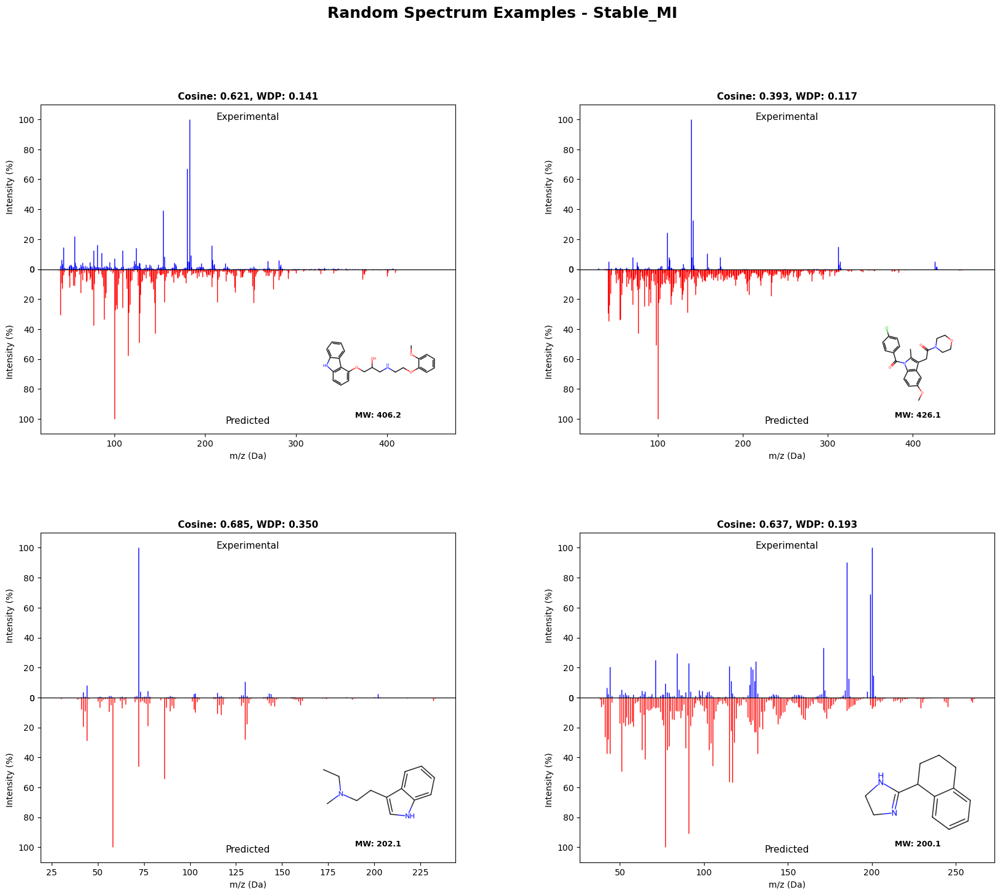


Analyzing stability of RF selection (parallel bootstrap)...
  RF stability (Jaccard): 0.4292
  Stable_RF: 103 features, Cosine Sim = 0.7571, Time = 11.3s

Visualizing Stable_RF...


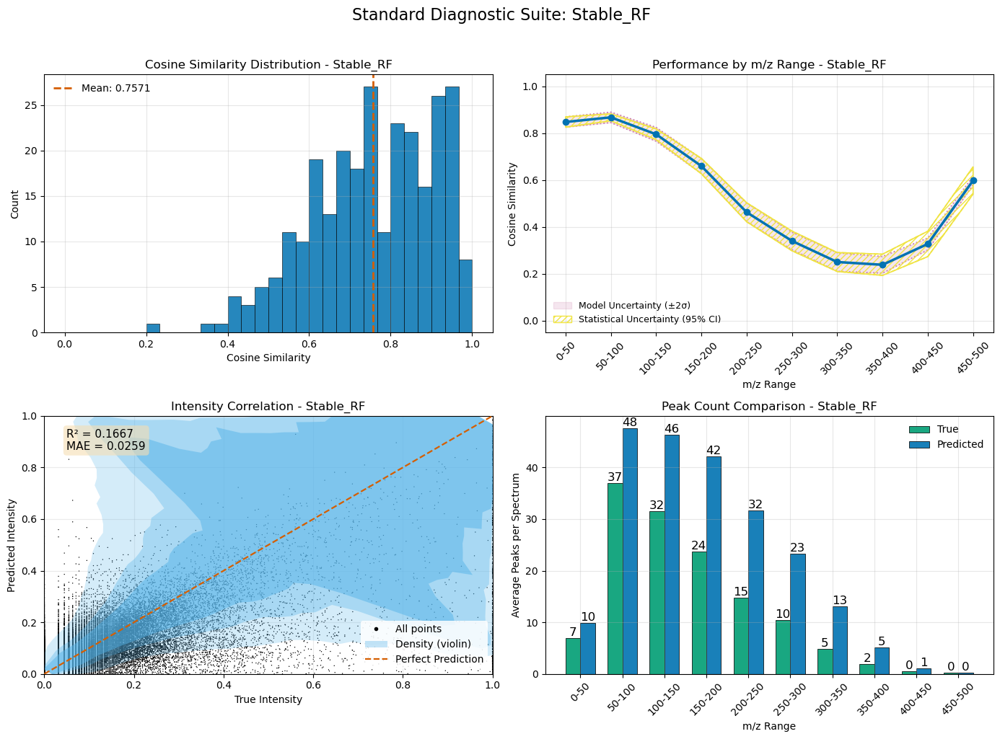


Selected random examples:
  1. Index 125: Cosine=0.7484, WDP=0.2434
  2. Index 238: Cosine=0.4070, WDP=0.1652
  3. Index 231: Cosine=0.7647, WDP=0.4361
  4. Index 1: Cosine=0.5596, WDP=0.1579


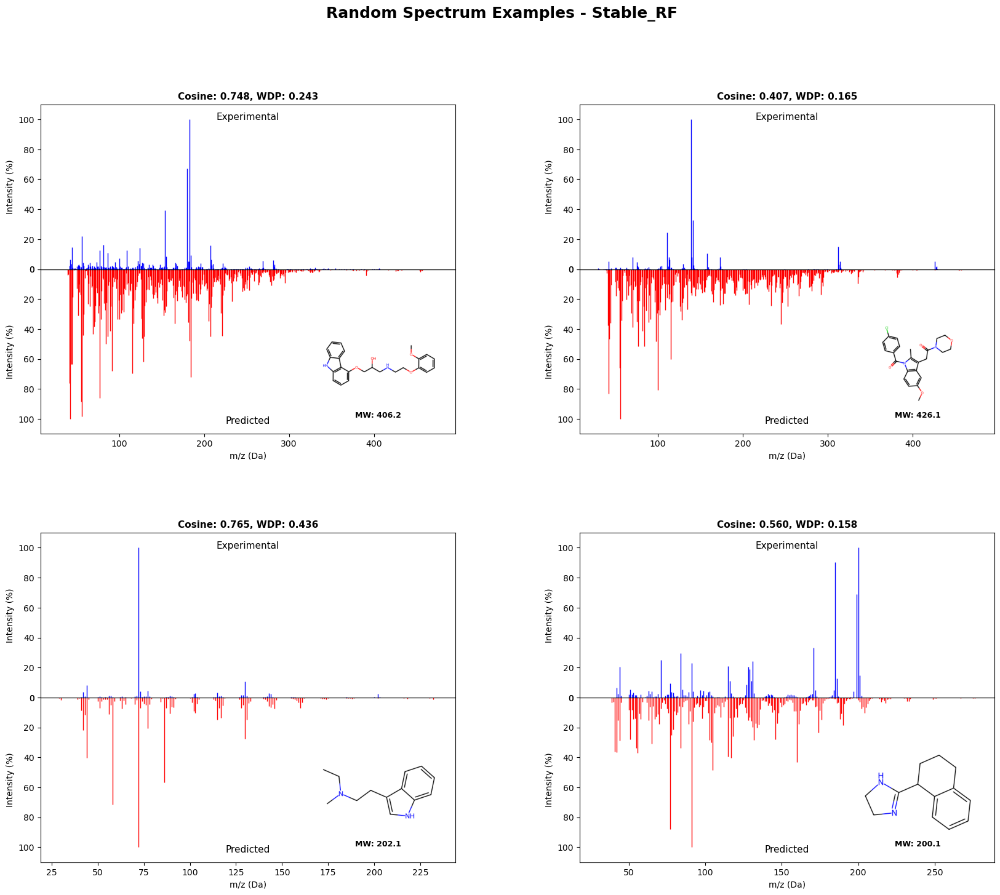

Results saved to ../data/results/selected_features/ensemble_selection_results.pkl

Ensemble feature selection complete


In [9]:
print("ENSEMBLE FEATURE SELECTION")
print("=" * 60)

ensemble_results = {}

# 8.1 Voting-based Ensemble
print("\n8.1 Voting-based Feature Selection")
print("-" * 40)

# Collect all selected features from previous methods
all_selections = {}
for method_results in [statistical_results, model_based_results, domain_results]:
    for method_name, results in method_results.items():
        if 'selected_features' in results:
            all_selections[method_name] = results['selected_features']

# Count feature occurrences
feature_votes = {}
for features in all_selections.values():
    for f in features:
        feature_votes[f] = feature_votes.get(f, 0) + 1

# Select features by vote threshold
vote_thresholds = [2, 3, 5]  # Features selected by at least n methods
vote_eval_tasks = []

for threshold in vote_thresholds:
    voted_features = [f for f, votes in feature_votes.items() if votes >= threshold]
    
    if len(voted_features) > 10:  # Minimum features needed
        vote_eval_tasks.append({
            'X_train': X_train,
            'y_train': y_train,
            'X_test': X_test,
            'y_test': y_test,
            'features': np.array(voted_features),
            'method': f"Voting_{threshold}+"
        })

# Evaluate voting selections in parallel
print("Evaluating voting-based feature subsets in parallel...")
vote_results = parallel_evaluate(vote_eval_tasks)
for result in vote_results:
    ensemble_results[result['method']] = result
    # Generate standard plots for voting results
    if MASTER_CONFIG['evaluation']['show_plots']:
        print(f"\nVisualizing {result['method']}...")
        plot_standard_2x2_diagnostic(result, result['method'])
        plot_random_spectrum_grid(result, test_smiles, n_examples=4, model_name=result['method'])

# 8.2 Stability Analysis (Parallel Bootstrap)
print("\n8.2 Feature Selection Stability Analysis")
print("-" * 40)

def bootstrap_feature_selection(boot_idx, X_train_var, y_train, variance_indices, method='MI', n_features=200):
    """Perform feature selection on a bootstrap sample."""
    np.random.seed(SEED + boot_idx)
    n_samples = len(X_train_var)
    
    # Create bootstrap sample
    boot_indices = np.random.choice(n_samples, n_samples, replace=True)
    X_boot = X_train_var[boot_indices]
    y_boot = y_train[boot_indices]
    
    if method == 'MI':
        # MI selection
        mi_scores = mutual_info_regression(
            X_boot, y_boot.mean(axis=1),
            n_neighbors=3,
            random_state=SEED + boot_idx
        )
        top_indices = np.argsort(mi_scores)[::-1][:n_features]
        selected = variance_indices[top_indices]
        
    else:  # RF
        # RF importance
        rf = RandomForestRegressor(
            n_estimators=50, 
            max_depth=10, 
            n_jobs=1,  # Single job per bootstrap
            random_state=SEED + boot_idx
        )
        rf.fit(X_boot, y_boot)
        importances = rf.feature_importances_
        top_indices = np.argsort(importances)[::-1][:n_features]
        selected = variance_indices[top_indices]
    
    return selected

# Test stability of MI and RF importance
n_bootstraps = MASTER_CONFIG['selection']['stability_bootstraps']

for method in ['MI', 'RF']:
    print(f"\nAnalyzing stability of {method} selection (parallel bootstrap)...")
    
    # Parallel bootstrap
    bootstrap_selections = Parallel(
        n_jobs=MASTER_CONFIG['general']['n_jobs'],
        backend=MASTER_CONFIG['general']['parallel_backend']
    )(
        delayed(bootstrap_feature_selection)(
            i, X_train_var, y_train, variance_indices, method
        ) for i in range(n_bootstraps)
    )
    
    # Calculate stability
    stability = calculate_stability(bootstrap_selections, X_train_var.shape[1])
    print(f"  {method} stability (Jaccard): {stability:.4f}")
    
    # Find stable features (appear in most bootstraps)
    feature_counts = {}
    for selection in bootstrap_selections:
        for f in selection:
            feature_counts[f] = feature_counts.get(f, 0) + 1
    
    # Features in 80% of bootstraps
    stable_features = [f for f, count in feature_counts.items() 
                      if count >= 0.8 * n_bootstraps]
    
    if len(stable_features) > 10:
        results = evaluate_feature_subset(
            X_train, y_train, X_test, y_test,
            np.array(stable_features), f"Stable_{method}"
        )
        results['stability'] = stability
        ensemble_results[f"Stable_{method}"] = results
        
        # Generate standard plots for stable features
        if MASTER_CONFIG['evaluation']['show_plots']:
            print(f"\nVisualizing Stable_{method}...")
            plot_standard_2x2_diagnostic(results, f"Stable_{method}")
            plot_random_spectrum_grid(results, test_smiles, n_examples=4, model_name=f"Stable_{method}")

# Save ensemble results
save_selection_results(ensemble_results, "ensemble")

print("\nEnsemble feature selection complete")

## 9. Results Summary and Visualization

Comprehensive analysis of all feature selection methods.

### Visualizations:
1. Performance vs Feature Count scatter plot
2. Method comparison by category
3. Top performing methods ranking
4. Feature selection overlap analysis

Note: These are summary visualizations that complement the standard plots shown for each individual method.

COMPREHENSIVE RESULTS ANALYSIS


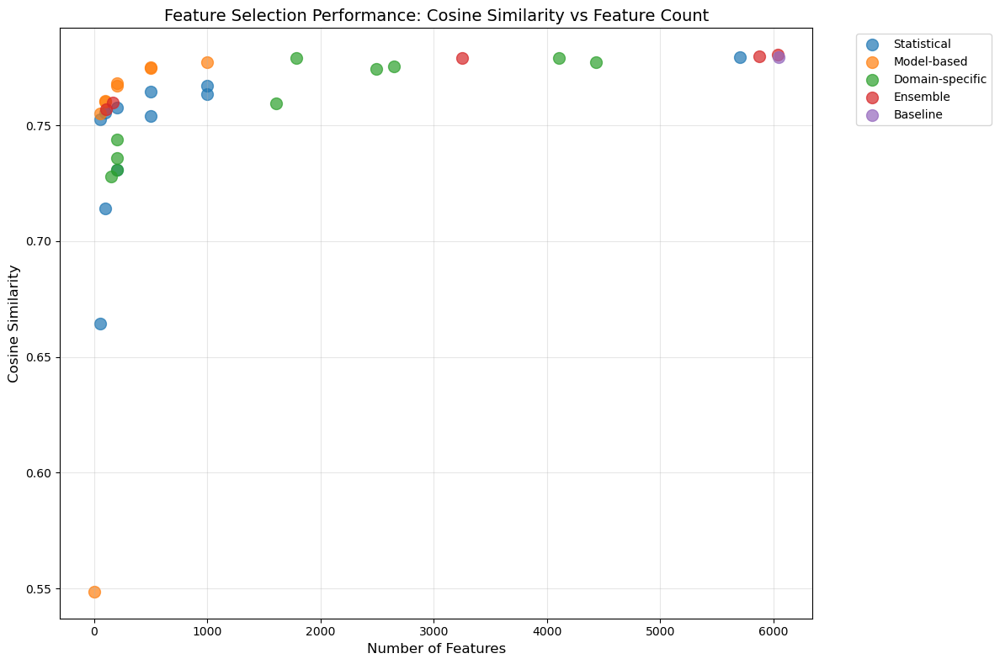

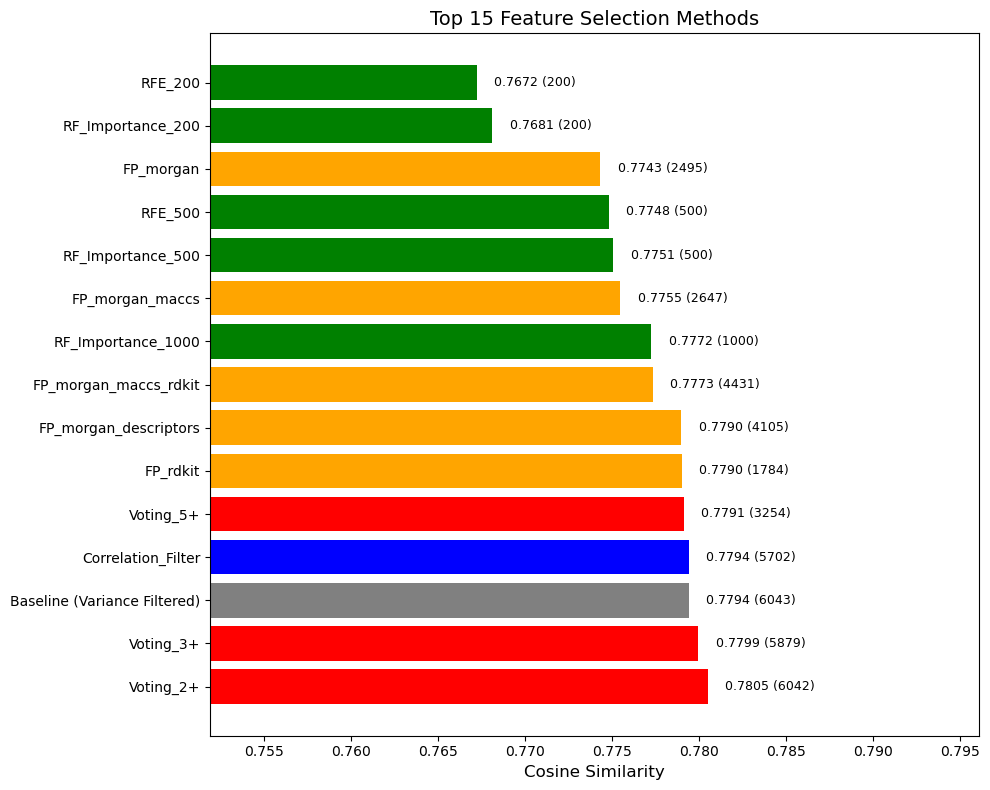

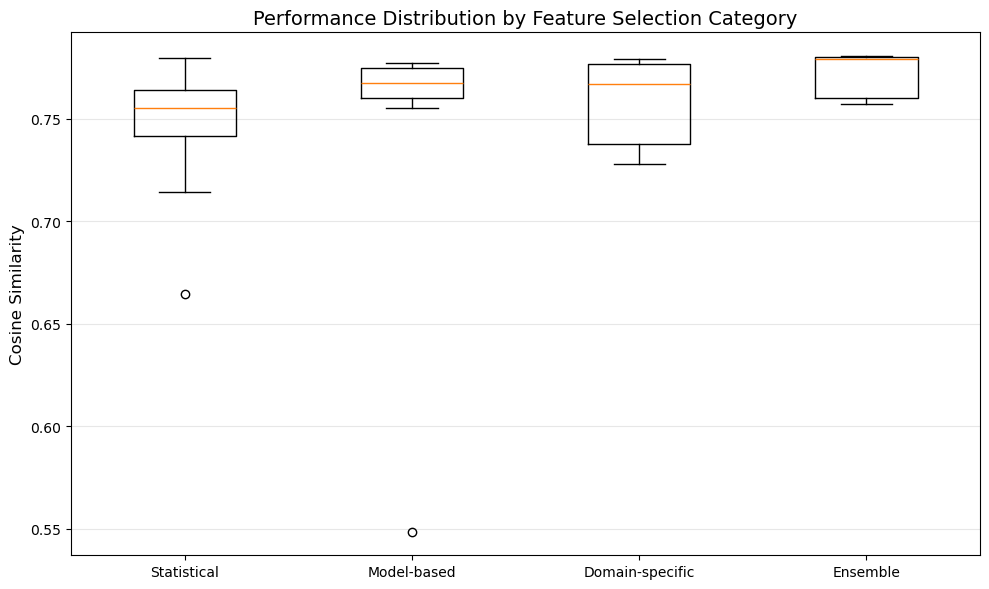


PERFORMANCE SUMMARY

Best method: Voting_2+
  Cosine Similarity: 0.780479
  Number of features: 6042
  Category: Ensemble

Improvement over baseline: 0.14%
Feature reduction: 0.0%

Category Performance Statistics:
----------------------------------------
Statistical     Mean: 0.7458 ± 0.0323
Model-based     Mean: 0.7430 ± 0.0733
Domain-specific Mean: 0.7583 ± 0.0215
Ensemble        Mean: 0.7713 ± 0.0118

Computational Efficiency:
----------------------------------------
Total evaluation time: 1454.6 seconds
Average time per method: 40.4 seconds

Results summary saved to ../data/results/selected_features/feature_selection_summary.pkl

BEST METHOD VISUALIZATION


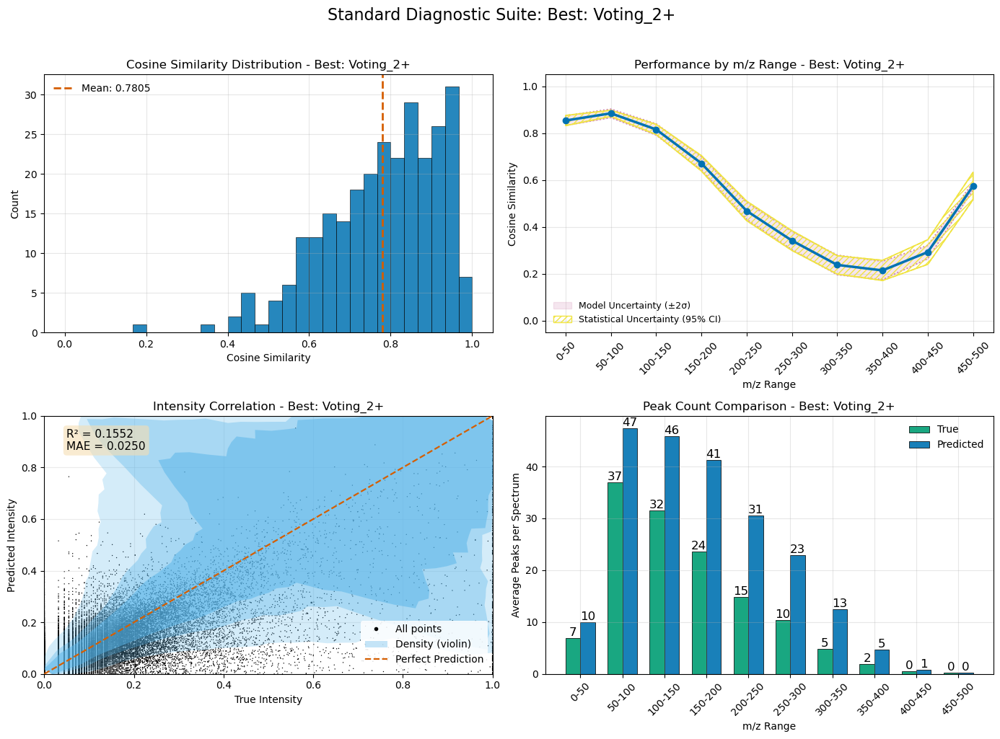


Selected random examples:
  1. Index 162: Cosine=0.8159, WDP=0.4286
  2. Index 196: Cosine=0.7853, WDP=0.4476
  3. Index 83: Cosine=0.7501, WDP=0.4878
  4. Index 149: Cosine=0.8836, WDP=0.5298


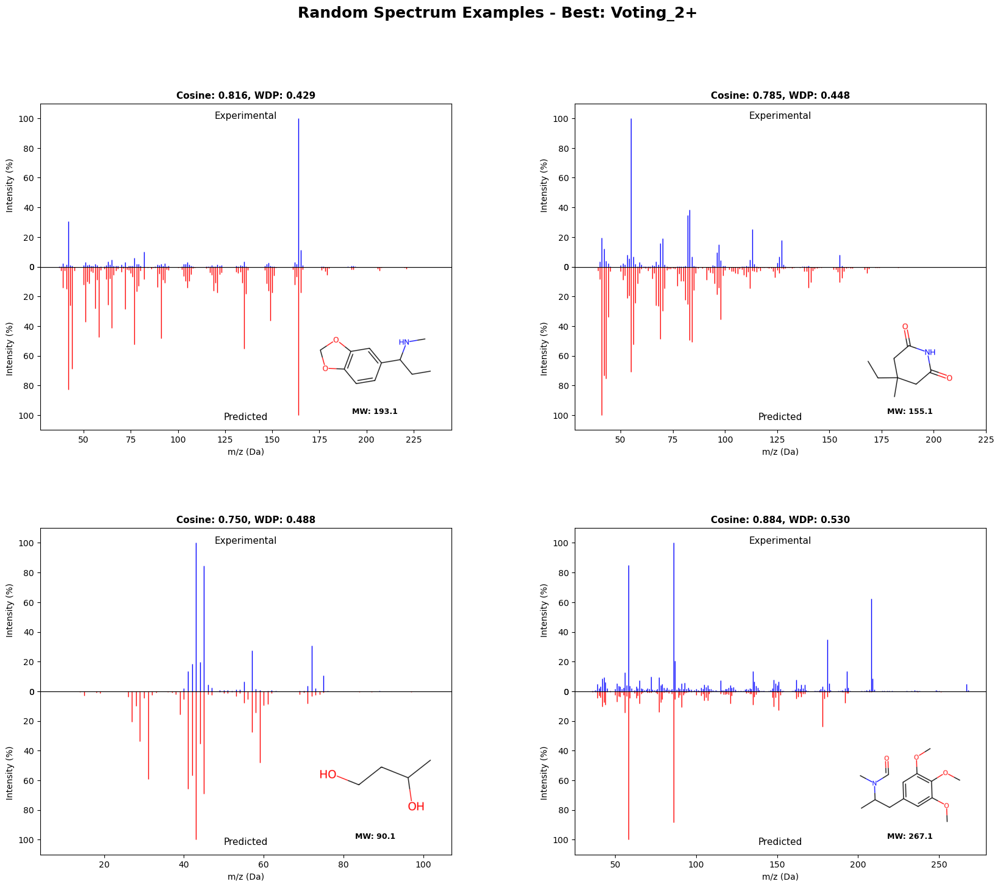

In [10]:
print("COMPREHENSIVE RESULTS ANALYSIS")
print("=" * 60)

# Collect all results
all_results = []
categories = {
    'Statistical': statistical_results,
    'Model-based': model_based_results,
    'Domain-specific': domain_results,
    'Ensemble': ensemble_results
}

for category, results_dict in categories.items():
    for method_name, results in results_dict.items():
        results['category'] = category
        all_results.append(results)

# Add baseline
baseline_results['category'] = 'Baseline'
all_results.append(baseline_results)

# Convert to DataFrame
results_df = pd.DataFrame(all_results)

# 1. Performance vs Feature Count
plt.figure(figsize=(12, 8))

for category in results_df['category'].unique():
    cat_data = results_df[results_df['category'] == category]
    plt.scatter(cat_data['n_features'], cat_data['cosine_similarity'], 
               label=category, s=100, alpha=0.7)

plt.xlabel('Number of Features', fontsize=12)
plt.ylabel('Cosine Similarity', fontsize=12)
plt.title('Feature Selection Performance: Cosine Similarity vs Feature Count', fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 2. Top Methods Ranking
top_n = 15
top_methods = results_df.nlargest(top_n, 'cosine_similarity')

plt.figure(figsize=(10, 8))
y_pos = np.arange(len(top_methods))
colors = {'Statistical': 'blue', 'Model-based': 'green', 
          'Domain-specific': 'orange', 'Ensemble': 'red', 'Baseline': 'gray'}

bars = plt.barh(y_pos, top_methods['cosine_similarity'], 
                color=[colors[cat] for cat in top_methods['category']])

plt.yticks(y_pos, top_methods['method'])
plt.xlabel('Cosine Similarity', fontsize=12)
plt.title(f'Top {top_n} Feature Selection Methods', fontsize=14)
plt.xlim(top_methods['cosine_similarity'].min() * 0.98, 
         top_methods['cosine_similarity'].max() * 1.02)

# Add value labels
for i, (idx, row) in enumerate(top_methods.iterrows()):
    plt.text(row['cosine_similarity'] + 0.001, i, 
             f"{row['cosine_similarity']:.4f} ({row['n_features']})", 
             va='center', fontsize=9)

plt.tight_layout()
plt.show()

# 3. Category Comparison
plt.figure(figsize=(10, 6))
category_data = [results_df[results_df['category'] == cat]['cosine_similarity'].values 
                for cat in ['Statistical', 'Model-based', 'Domain-specific', 'Ensemble']]

plt.boxplot(category_data, labels=['Statistical', 'Model-based', 'Domain-specific', 'Ensemble'])
plt.ylabel('Cosine Similarity', fontsize=12)
plt.title('Performance Distribution by Feature Selection Category', fontsize=14)
plt.grid(True, alpha=0.3, axis='y')
plt.tight_layout()
plt.show()

# Print summary statistics
print("\nPERFORMANCE SUMMARY")
print("=" * 60)
print(f"\nBest method: {top_methods.iloc[0]['method']}")
print(f"  Cosine Similarity: {top_methods.iloc[0]['cosine_similarity']:.6f}")
print(f"  Number of features: {top_methods.iloc[0]['n_features']}")
print(f"  Category: {top_methods.iloc[0]['category']}")

# Performance improvement over baseline
baseline_score = baseline_results['cosine_similarity']
best_score = top_methods.iloc[0]['cosine_similarity']
improvement = (best_score - baseline_score) / baseline_score * 100

print(f"\nImprovement over baseline: {improvement:.2f}%")
print(f"Feature reduction: {(1 - top_methods.iloc[0]['n_features'] / baseline_results['n_features']) * 100:.1f}%")

# Category statistics
print("\nCategory Performance Statistics:")
print("-" * 40)
for category in ['Statistical', 'Model-based', 'Domain-specific', 'Ensemble']:
    cat_results = results_df[results_df['category'] == category]['cosine_similarity']
    if len(cat_results) > 0:
        print(f"{category:15} Mean: {cat_results.mean():.4f} ± {cat_results.std():.4f}")

# Timing statistics
print("\nComputational Efficiency:")
print("-" * 40)
total_time = results_df['training_time'].sum()
print(f"Total evaluation time: {total_time:.1f} seconds")
print(f"Average time per method: {total_time / len(results_df):.1f} seconds")

# Save summary
summary_path = os.path.join(MASTER_CONFIG['paths']['selected_dir'], 'feature_selection_summary.pkl')
with open(summary_path, 'wb') as f:
    pickle.dump({
        'results_df': results_df,
        'top_methods': top_methods,
        'baseline': baseline_results,
        'all_results': all_results
    }, f)

print(f"\nResults summary saved to {summary_path}")

# Generate final visualization for best method
best_method = top_methods.iloc[0]
best_category = best_method['category']
best_method_name = best_method['method']

# Find the full results for the best method
if best_category == 'Statistical':
    best_full_results = statistical_results[best_method_name]
elif best_category == 'Model-based':
    best_full_results = model_based_results[best_method_name]
elif best_category == 'Domain-specific':
    best_full_results = domain_results[best_method_name]
elif best_category == 'Ensemble':
    best_full_results = ensemble_results[best_method_name]
else:
    best_full_results = baseline_results

print("\n" + "=" * 60)
print("BEST METHOD VISUALIZATION")
print("=" * 60)
plot_standard_2x2_diagnostic(best_full_results, f"Best: {best_method_name}", show_uncertainties=True)
plot_random_spectrum_grid(best_full_results, test_smiles, n_examples=4, model_name=f"Best: {best_method_name}")

## 10. Export Best Feature Sets

Export the best performing feature subsets for use in model training.

Creates new train/val/test JSONL files with only selected features.

In [11]:
print("EXPORTING BEST FEATURE SETS")
print("=" * 60)

# Select top 3 methods
top_3_methods = top_methods.head(3)

for idx, row in top_3_methods.iterrows():
    method_name = row['method']
    selected_features = row['selected_features']
    
    print(f"\nExporting features for {method_name} ({len(selected_features)} features)...")
    
    # Create output directory
    output_dir = os.path.join(
        MASTER_CONFIG['paths']['results_dir'],
        MASTER_CONFIG['paths']['input_type'],
        f"selected_{method_name.lower().replace(' ', '_')}"
    )
    os.makedirs(output_dir, exist_ok=True)
    
    # Export train/val/test with selected features
    for split, (smiles, X, y) in [('train', (train_smiles, X_train, y_train)),
                                   ('val', (val_smiles, X_val, y_val)),
                                   ('test', (test_smiles, X_test, y_test))]:
        
        output_path = os.path.join(output_dir, f"{split}_data.jsonl")
        
        with open(output_path, 'w') as f:
            for i in range(len(smiles)):
                record = {
                    'smiles': smiles[i],
                    'features': X[i, selected_features].tolist(),
                    'target': y[i].tolist()
                }
                f.write(json.dumps(record) + '\n')
        
        print(f"  Saved {split} data to {output_path}")
    
    # Save feature indices
    feature_info = {
        'method': method_name,
        'selected_indices': selected_features.tolist(),
        'n_features': len(selected_features),
        'cosine_similarity': row['cosine_similarity'],
        'original_features': X_train.shape[1]
    }
    
    info_path = os.path.join(output_dir, 'feature_selection_info.json')
    with open(info_path, 'w') as f:
        json.dump(feature_info, f, indent=2)

print("\nFEATURE SELECTION PIPELINE COMPLETE")
print("=" * 60)
print(f"Best performing method: {top_methods.iloc[0]['method']}")
print(f"Cosine similarity: {top_methods.iloc[0]['cosine_similarity']:.6f}")
print(f"Feature reduction: {(1 - top_methods.iloc[0]['n_features'] / baseline_results['n_features']) * 100:.1f}%")
print(f"\nSelected feature sets exported to subdirectories in {MASTER_CONFIG['paths']['results_dir']}")

EXPORTING BEST FEATURE SETS

Exporting features for Voting_2+ (6042 features)...
  Saved train data to ../data/results/hpj/selected_voting_2+/train_data.jsonl
  Saved val data to ../data/results/hpj/selected_voting_2+/val_data.jsonl
  Saved test data to ../data/results/hpj/selected_voting_2+/test_data.jsonl

Exporting features for Voting_3+ (5879 features)...
  Saved train data to ../data/results/hpj/selected_voting_3+/train_data.jsonl
  Saved val data to ../data/results/hpj/selected_voting_3+/val_data.jsonl
  Saved test data to ../data/results/hpj/selected_voting_3+/test_data.jsonl

Exporting features for Baseline (Variance Filtered) (6043 features)...
  Saved train data to ../data/results/hpj/selected_baseline_(variance_filtered)/train_data.jsonl
  Saved val data to ../data/results/hpj/selected_baseline_(variance_filtered)/val_data.jsonl
  Saved test data to ../data/results/hpj/selected_baseline_(variance_filtered)/test_data.jsonl

FEATURE SELECTION PIPELINE COMPLETE
Best performing 